In [31]:
import os
import matplotlib.pyplot as plt
import sys
import pandas as pd
import json
import numpy as np
from matplotlib.colors import LightSource
from matplotlib.markers import MarkerStyle
module_path = os.path.abspath(os.path.join('../'))
if module_path not in sys.path:
    sys.path.append(module_path)
from util import data
from util import management as mana
from util import constants as con

'''
    This notebook creates all the images for my thesis.
'''

# Define paths
thesis_path = con.THESIS_PATH
latex_path = f"{thesis_path}/MasterThesis/Latex"
figures_path = f"{latex_path}/figures"
results_path = f"{latex_path}/results"

# Define constants for the transformations we can use for images
NOTHING = "N"
TRANSPOSE = "T" 
ANTITRANSPOSE = "A"

# Define constants to indicate the various views of a 3D scan
AXIAL = "AXIAL"
CORONAL = "CORONAL"
SAGITTAL = "SAGITTAL"

def get_paths(task, config, trts, trainer):
    ''' based on nnU-Net model specifics, gets all the paths '''
    data_path = f"{thesis_path}/Data/nnUNet_raw_data_base/nnUNet_raw_data/Task{task}"
    img_path = f'{data_path}/images{trts}'
    label_path = f'{data_path}/labels{trts}'
    segmentation_path = f"{thesis_path}/Results/{task}/{config}/{trainer}/inference/{task}/images{trts}"
    return data_path, img_path, segmentation_path, label_path

def get_data_visu(rel_patient_id, slice, img_path, label_path, modality, segmentation_path, name, flip, view=AXIAL):
    ''' get the 2D slices from 3D scan / label / (optional) segmentation '''
    
    # load 3D data
    patient_id = mana.get_patient_id_from_rel_id(img_path, rel_patient_id)
    X = data.get_all_data(patient_id, img_path, label_path, modality, segmentation_path)
    img = X[0]
    label = X[1]
    if len(X) == 3:
        segmentation = X[2]
    else:
        segmentation = None
    
    # Axial slice
    if view == AXIAL:
        # Get slices
        if flip == NOTHING:
            img_slice = img[:,:,slice]
            label_slice = label[:,:,slice]
            if segmentation is not None:
                seg_slice = segmentation[:,:,slice]
        # Get transposed slices
        elif flip == TRANSPOSE:
            img_slice = img[:,:,slice].T
            label_slice = label[:,:,slice].T
            if segmentation is not None:
                seg_slice = segmentation[:,:,slice].T
        # Get anti-transposed slices
        elif flip == ANTITRANSPOSE:
            img_slice = img[::-1,::-1,slice].T
            label_slice = label[::-1,::-1,slice].T
            if segmentation is not None:
                seg_slice = segmentation[::-1,::-1,slice].T
    # Coronal slice
    elif view == CORONAL:
        img_slice = img[:,slice,:]
        label_slice = label[:,slice,:]
        if segmentation is not None:
                seg_slice = segmentation[:,slice,:]
    # Sagittal slice
    elif view == SAGITTAL:
        img_slice = img[slice,:,:]
        label_slice = label[slice,:,:]
        if segmentation is not None:
                seg_slice = segmentation[slice,:,:]

    if segmentation is not None:
        return img_slice, label_slice, seg_slice
    else:
        return img_slice, label_slice

def create_2d(rel_patient_id, slice, img_path, label_path, modality, segmentation_path, name, flip, showLabel = True, showSeg=False, rescale=True,
                zoom=False, onlyPanc=True, zoom_x_min=0.25, zoom_x_max=0.75, zoom_y_min=0.25, zoom_y_max=0.75, view=AXIAL):
    ''' create an image showing 2D scan, ground truth and (optional) the segmentation '''
    
    # Get data 
    X = get_data_visu(rel_patient_id, slice, img_path, label_path, modality, segmentation_path, name, flip, view)
    img_slice = X[0]
    label_slice = X[1]
    if showSeg:
        seg_slice = X[2]

    # Only plot a part of the data (i.e, zoom in on a specific region)
    if zoom:
        x,y = img_slice.shape
        img_slice = img_slice[int(x*zoom_x_min):int(x*zoom_x_max),int(y*zoom_y_min):int(y*zoom_y_max)]
        label_slice = label_slice[int(x*zoom_x_min):int(x*zoom_x_max),int(y*zoom_y_min):int(y*zoom_y_max)]
        if showSeg:
            seg_slice = seg_slice[int(x*zoom_x_min):int(x*zoom_x_max),int(y*zoom_y_min):int(y*zoom_y_max)]

    # Remove all non-pancreas labels
    if onlyPanc:
        label_slice[label_slice != 1] = 0
        if showSeg:
            seg_slice[seg_slice != 1] = 0

    # Make matplotlib figure
    f = plt.figure(figsize=(30,30))

    # Plot scan (optionally: rescale gray values)
    if rescale:
        plt.imshow(img_slice, cmap=plt.cm.gray, vmin=-150, vmax=250)
    else:
        plt.imshow(img_slice, cmap=plt.cm.gray)

    # Plot ground truth and the segmentation
    lab_masked = np.ma.masked_where(label_slice == 0, label_slice)
    if showSeg:
        seg_masked = np.ma.masked_where(seg_slice == 0, seg_slice) 
        plt.imshow(seg_masked, alpha=0.5)
        plt.imshow(lab_masked, cmap=plt.cm.viridis_r, alpha=0.4)
    # Plot ground truth
    else:
        if showLabel:
            plt.imshow(lab_masked, cmap=plt.cm.viridis_r)  

    # Save
    plt.axis('off')
    plt.savefig(f"{figures_path}/{name}.png", bbox_inches='tight')
    plt.show()

def create_2d_both(rel_patient_id, slice, img_path, label_path, modality, segmentation_path, name, flip, showSeg=False, view=AXIAL, rescale=True):
    ''' create a 2D image showing the following:
        - left: only scan 
        - right: scan, ground truth and (optional) the segmentation '''
    
    # Get data
    X = get_data_visu(rel_patient_id, slice, img_path, label_path, modality, segmentation_path, name, flip, view)
    img_slice = X[0]
    label_slice = X[1]
    if showSeg:
        seg_slice = X[2]

    # Make matplotlib figure
    f = plt.figure(figsize=(60,30))
    a1 = f.add_subplot(1, 2, 1)

    # Left: Plot scan (optionally: rescale gray values)
    if rescale:
        plt.imshow(img_slice, cmap=plt.cm.gray, vmin=-150, vmax=250)
    else:
        plt.imshow(img_slice, cmap=plt.cm.gray)

    # Right: plot scan (optionally: rescale gray values)
    a1 = f.add_subplot(1, 2, 2)
    if rescale:
        plt.imshow(img_slice, cmap=plt.cm.gray, vmin=-150, vmax=250)
    else:
        plt.imshow(img_slice, cmap=plt.cm.gray)
    
    lab_masked = np.ma.masked_where(label_slice == 0, label_slice)

    # Right: show ground truth + segmentation on top of scan
    if showSeg:
        seg_masked = np.ma.masked_where(seg_slice == 0, seg_slice)
        plt.imshow(seg_masked, alpha=0.5)
        plt.imshow(lab_masked, alpha=0.4, cmap=plt.cm.viridis_r)
    # Right: show ground truth on top of scan
    else:
        plt.imshow(lab_masked, cmap=plt.cm.viridis_r)

    # Save image
    plt.axis('off')
    plt.savefig(f"{figures_path}/{name}.png", dpi=200, bbox_inches='tight')    
    plt.show()

def create_2d_triple(rel_patient_id, slice, img_path, label_path, modality, segmentation_path, segmentation_path2, name, flip, view=AXIAL,
    zoom = False, zoom_x_min=0.25, zoom_x_max=0.75, zoom_y_min=0.25, zoom_y_max=0.75):
    ''' create a 2D image showing the following:
        - left: scan
        - middle: scan + ground truth and segmentation1
        - right: scan + ground truth and segmentation2 '''

    # Get data 
    X = get_data_visu(rel_patient_id, slice, img_path, label_path, modality, segmentation_path, name, flip, view)
    img_slice = X[0]
    label_slice = X[1]
    seg_slice = X[2]
    seg_slice2 = get_data_visu(rel_patient_id, slice, img_path, label_path, modality, segmentation_path2, name, flip, view)[2]
    
    # Only plot a part of the data (i.e, zoom in on a specific region)
    if zoom:
        x,y = img_slice.shape
        img_slice = img_slice[int(x*zoom_x_min):int(x*zoom_x_max),int(y*zoom_y_min):int(y*zoom_y_max)]
        label_slice = label_slice[int(x*zoom_x_min):int(x*zoom_x_max),int(y*zoom_y_min):int(y*zoom_y_max)]
        seg_slice = seg_slice[int(x*zoom_x_min):int(x*zoom_x_max),int(y*zoom_y_min):int(y*zoom_y_max)]
        seg_slice2 = seg_slice2[int(x*zoom_x_min):int(x*zoom_x_max),int(y*zoom_y_min):int(y*zoom_y_max)]

    # Create the masks we're going to plot on top of the scan
    lab_masked = np.ma.masked_where(label_slice == 0, label_slice)
    seg_masked = np.ma.masked_where(seg_slice == 0, seg_slice)
    seg_masked2 = np.ma.masked_where(seg_slice2 == 0, seg_slice2)

    # Make matplotlib figure
    f = plt.figure(figsize=(60,30))

    # Left: show image 
    a1 = f.add_subplot(1, 3, 1)
    plt.imshow(img_slice, cmap=plt.cm.gray)

    # Middle: show scan with label and seg1
    a1 = f.add_subplot(1, 3, 2)
    plt.imshow(img_slice, cmap=plt.cm.gray)
    plt.imshow(seg_masked, alpha=0.5)
    plt.imshow(lab_masked, alpha=0.4, cmap=plt.cm.viridis_r)

    # Right: show scan with label and seg2
    a2 = f.add_subplot(1, 3, 3)
    plt.imshow(img_slice, cmap=plt.cm.gray)
    plt.imshow(seg_masked2, alpha=0.5)
    plt.imshow(lab_masked, alpha=0.4, cmap=plt.cm.viridis_r)

    # Save
    plt.axis('off')
    plt.savefig(f"{figures_path}/{name}.png", dpi=200, bbox_inches='tight')    
    plt.show()

Create figure showing why pancreas is difficult. It creates 3 2D images and 3 3D images showcasing various pancreases.

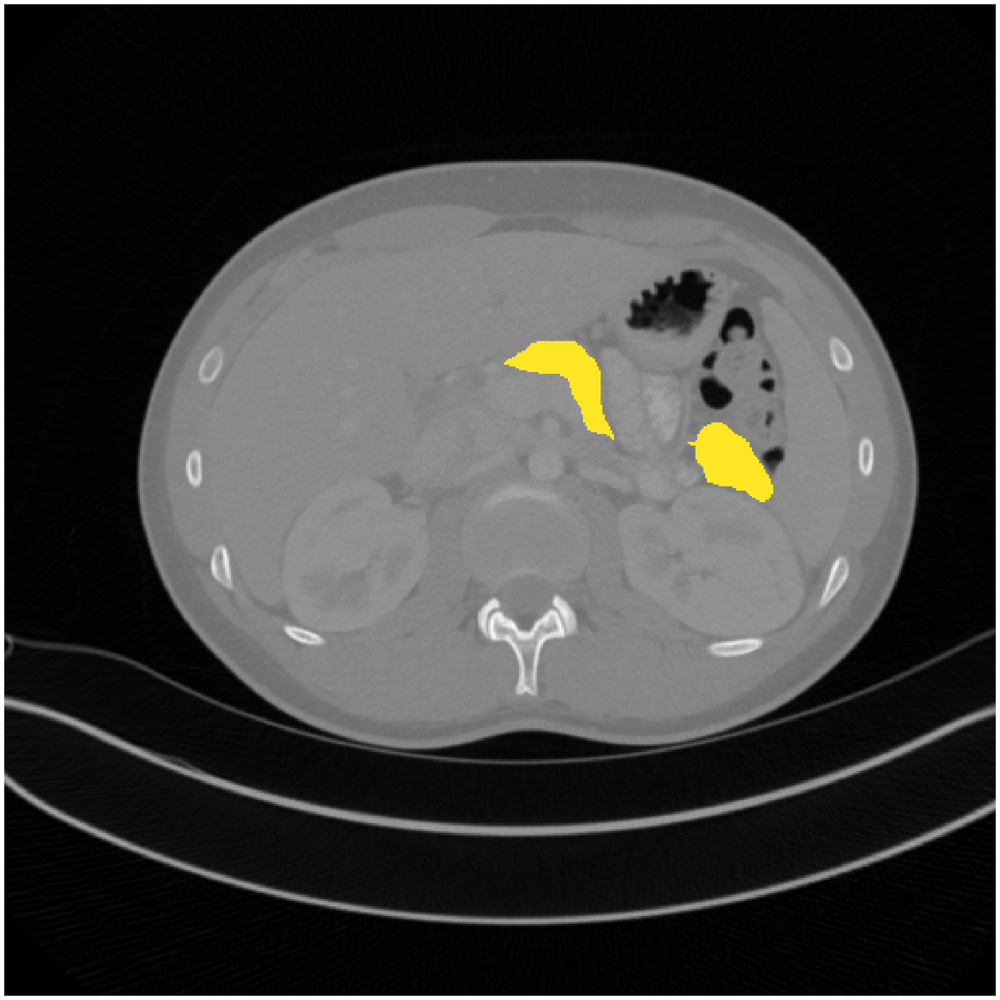

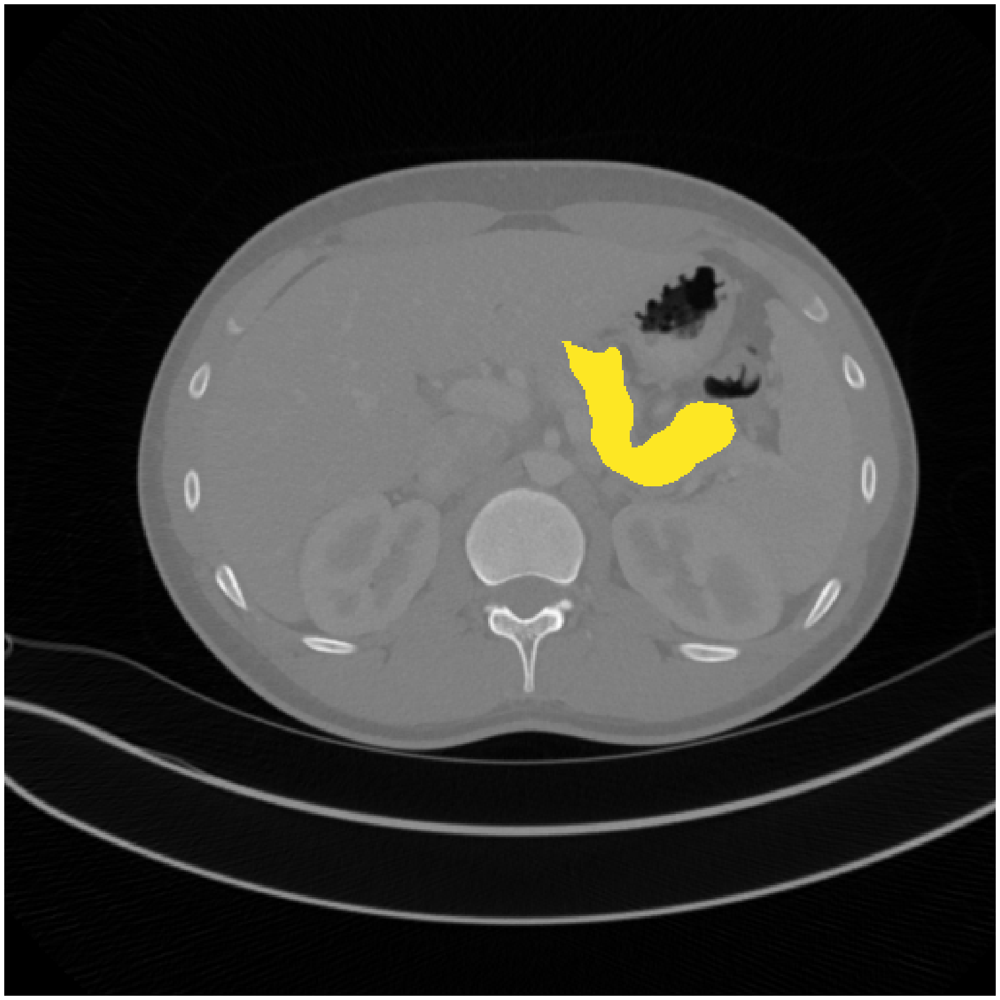

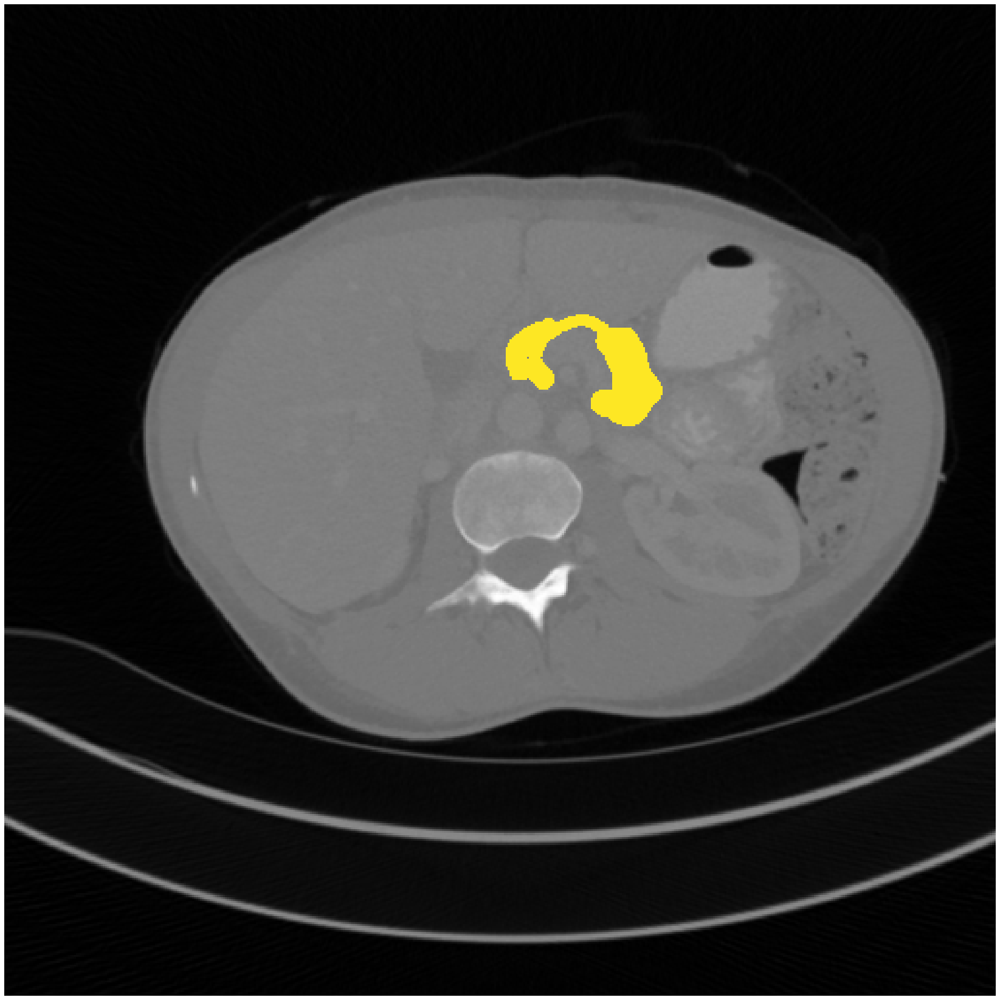

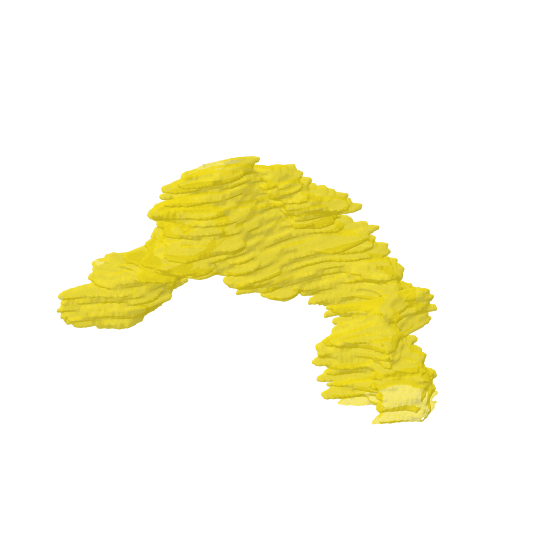

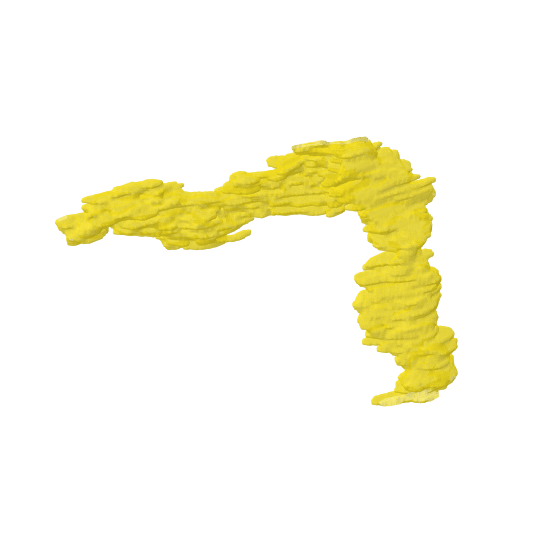

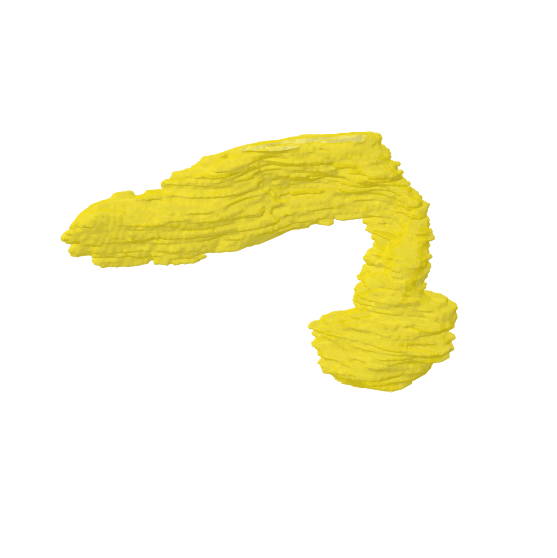

In [32]:
# Fill in nnU-net model specifics and get paths
task = con.TASK_501
config = con.CONFIG_FULL
trts = con.TRAIN
trainer = con.CLASSIC
modality = con.ONE
data_path, img_path, segmentation_path, label_path = get_paths(task, config, trts, trainer)
figure = "example_pancreas_difficult" # image name

def create_3d(rel_patient_id, name):
    ''' Plot 3D pancreas '''    
    # skimage image processing packages
    from mpl_toolkits.mplot3d.art3d import Poly3DCollection
    from skimage import measure

    # Load data
    patient_id = mana.get_patient_id_from_rel_id(img_path, rel_patient_id)
    img, label, segmentation = data.get_all_data(patient_id, img_path, label_path, modality, segmentation_path)
    
    # Crop full scan to minimal blunding box around the pancreas
    bbox = data.determine_minimal_bounding_box(label)
    cropped_label = data.get_bounding_box(label, *bbox)
    image = cropped_label[::-1,::-1,:]

    # Marching cubes algorithm
    verts, faces, normals, _ = measure.marching_cubes(image)

    # Make Axes3D plot
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')

    # Create polygon data
    mesh = Poly3DCollection(verts[faces], alpha=0.8) # verts[faces] creates a collection of triangles
    ls = LightSource(azdeg=225.0, altdeg=45.0) # get shading

    # Normally, normals are per vertex but we want it per face
    normalsarray = np.array([np.array((np.sum(normals[face[:], 0]/3), np.sum(normals[face[:], 1]/3), np.sum(normals[face[:], 2]/3))/np.sqrt(np.sum(normals[face[:], 0]/3)**2 + np.sum(normals[face[:], 1]/3)**2 + np.sum(normals[face[:], 2]/3)**2)) for face in faces])

    # Change shading values to get the colors we want
    min = np.min(ls.shade_normals(normalsarray, fraction=1.0)) # min shade value
    max = np.max(ls.shade_normals(normalsarray, fraction=1.0)) # max shade value
    diff = max-min
    newMin = 0.7
    newMax = 1
    newdiff = newMax-newMin

    # Set the colors and apply shading
    face_color = np.array((253/255, 231/255, 36/255, 255/255))
    face_color_new = np.array([face_color*(newMin + newdiff*((shade-min)/diff)) for shade in ls.shade_normals(normalsarray, fraction=1.0)])
    mesh.set_facecolor(face_color_new)
    ax.add_collection3d(mesh)
    ax.set_xlim(0, image.shape[0])
    ax.set_ylim(0, image.shape[1])
    ax.set_zlim(0, image.shape[2])

    # Customise more
    ax.grid(False)
    ax.set_axis_off()
    ax.azim=300
    ax.elev=15

    ## Commented out in case I want other perspectives
    ## Other possible peprspectives: (90,15,(1,4)), (120,15,[0]), (270,15,(0,2,4)), (300,15,(0,4))]
    ## (X,Y,Z) 
    ##  X - Azim
    ##  Y - Elem
    ##  Z - flipping van label 
        # if ha == 0:
        #     plot_3d(cropped_label, i, j)
        # elif ha == 1:
        #     plot_3d(cropped_label[::-1,:,:], i, j)
        # elif ha == 2:
        #     plot_3d(cropped_label[:,::-1,:], i, j)
        # elif ha == 3:
        #     plot_3d(cropped_label[:,:,::-1], i, j)
        # elif ha == 4:
        #     plot_3d(cropped_label[::-1,::-1,:], i, j)

    # Save
    plt.savefig(f"{figures_path}/{name}.png", dpi=200, bbox_inches='tight')   
    plt.show()

# Create images showing 2D slices
create_2d(0, 95, img_path, label_path, modality, segmentation_path, f'{figure}_0', TRANSPOSE, rescale=False)
create_2d(0, 104, img_path, label_path, modality, segmentation_path,  f'{figure}_1', TRANSPOSE, rescale=False)
create_2d(1, 103, img_path, label_path, modality, segmentation_path, f'{figure}_2', TRANSPOSE, rescale=False)

# Create images showing 3D pancreases
create_3d(0, f'{figure}_4')
create_3d(2, f'{figure}_5')
create_3d(5, f'{figure}_6')

Create figures to visualise the data of the various data-sets we used.

We can then showcase the difference between P16/NIH/MSD/BCV/AMOS.

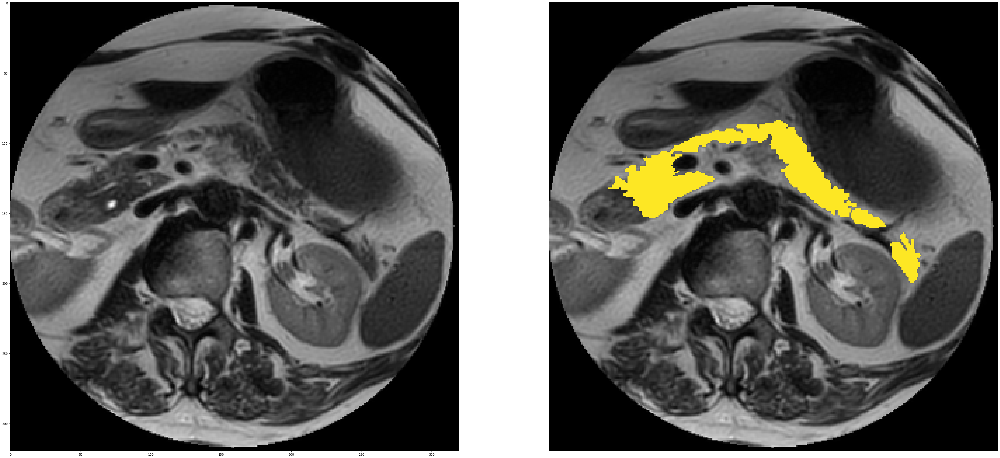

In [25]:
figure = "methods_data" # figure name

# # NIH
# task = con.TASK_501
# data_path, img_path, segmentation_path, label_path = get_paths(task, config, trts, trainer)
# create_2d_both(2, 124, img_path, label_path, modality, segmentation_path, f'{figure}_nih', TRANSPOSE, rescale=False)

# # MSD
# task = con.TASK_510
# data_path, img_path, segmentation_path, label_path = get_paths(task, config, trts, trainer)
# create_2d_both(1, 64, img_path, label_path, modality, segmentation_path, f'{figure}_msd', ANTITRANSPOSE, rescale=False)

# # BCV
# task = con.TASK_525
# data_path, img_path, segmentation_path, label_path = get_paths(task, config, trts, trainer)
# create_2d_both(2, 138, img_path, label_path, modality, segmentation_path, f'{figure}_bcv', ANTITRANSPOSE, rescale=False)

# # AMOS
# task = con.TASK_601
# data_path, img_path, segmentation_path, label_path = get_paths(task, config, trts, trainer)
# create_2d_both(0, 35, img_path, label_path, modality, segmentation_path, f'{figure}_amos', ANTITRANSPOSE, rescale=False)

# P16
task = con.TASK_610
data_path, img_path, segmentation_path, label_path = get_paths(task, config, trts, trainer)
create_2d_both(3, 17, img_path, label_path, modality, segmentation_path, f'{figure}_p16', ANTITRANSPOSE, rescale=False)

# Results experiment 1

First, rwe recreate the convergence graphs that we want to show.

501 3d_fullres 0


C:\Users\ikke_\AppData\Local\Temp\ipykernel_14496\536095275.py:49: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "figsize" which is no longer supported as of 3.3 and will become an error in 3.6
  plt.savefig(f"{figures_path}/{task}/convergence_fullsize_single_fold_{task}_{config}_{trainer}_{fold}", dpi=200, figsize=(8,5), bbox_inches='tight')


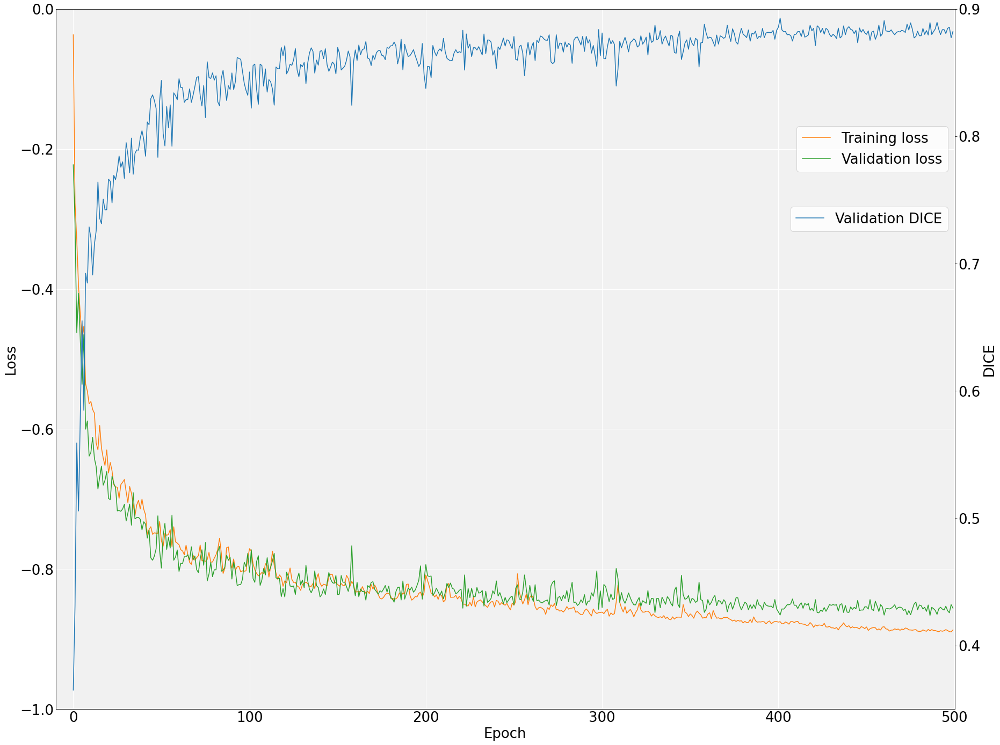

501 3d_lowres 0


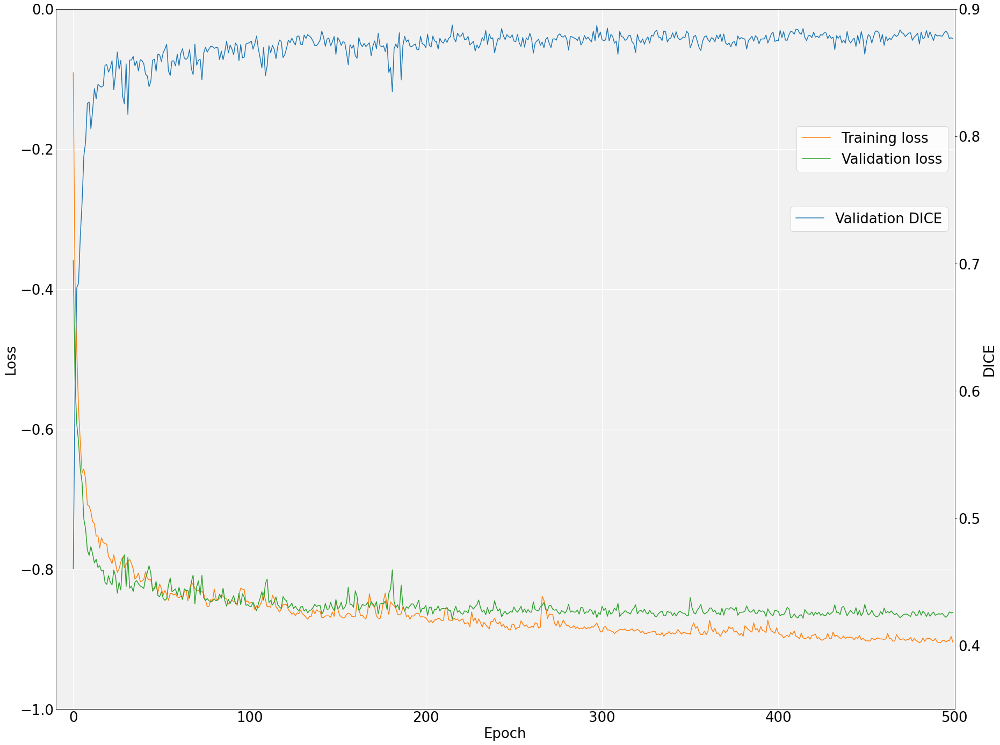

501 3d_cascade_fullres 0


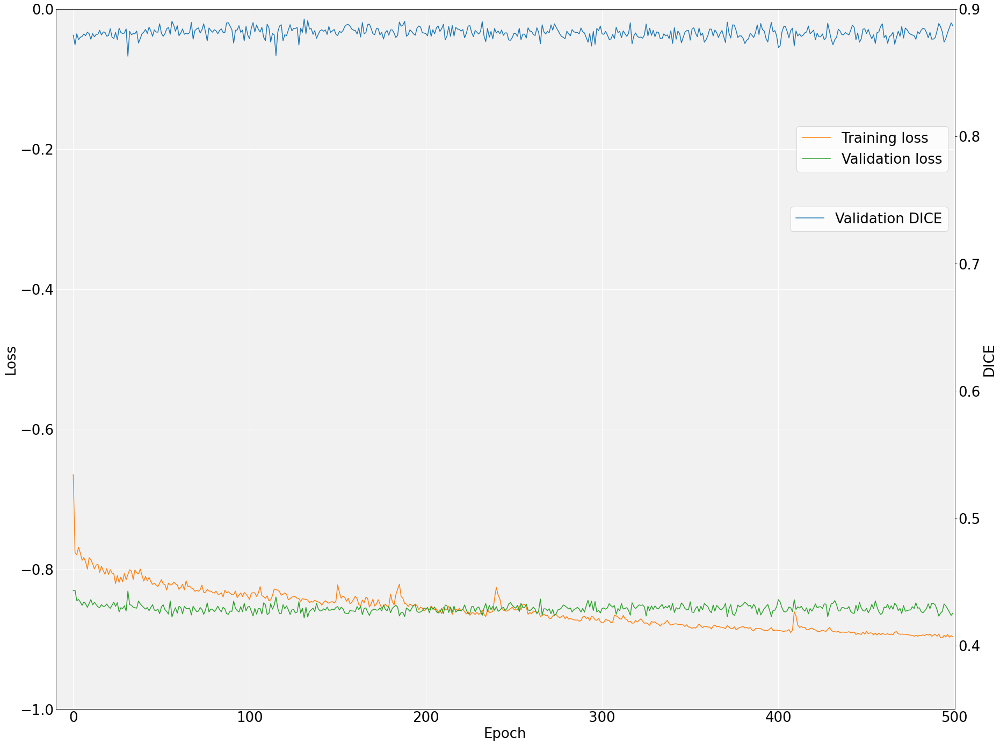

551 3d_fullres 0


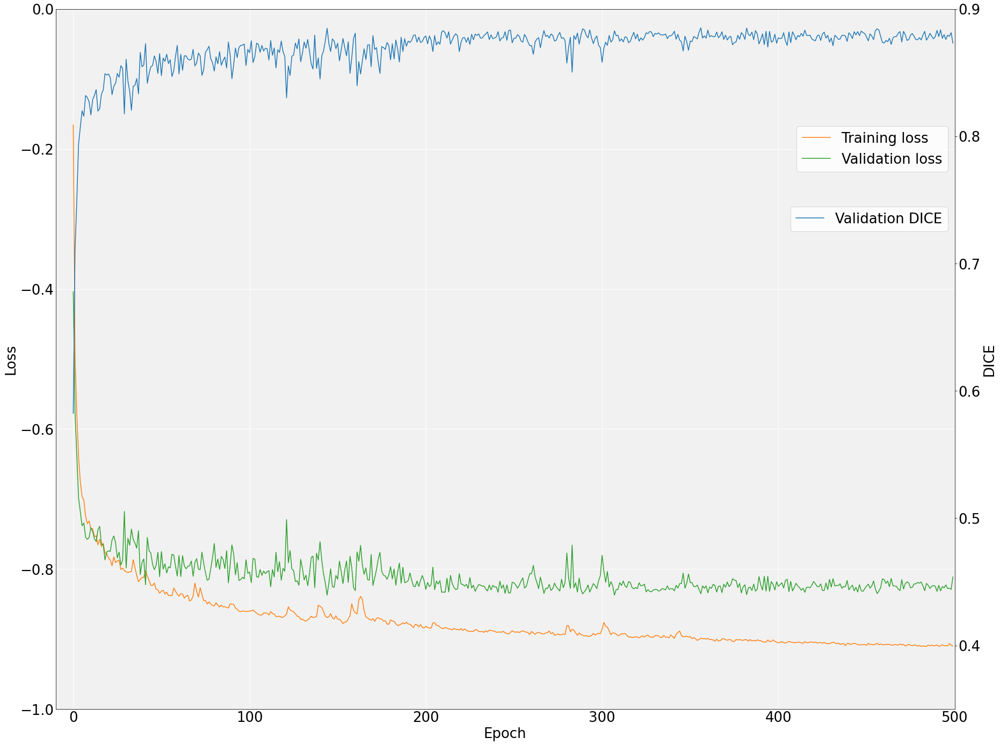

510 3d_fullres 0


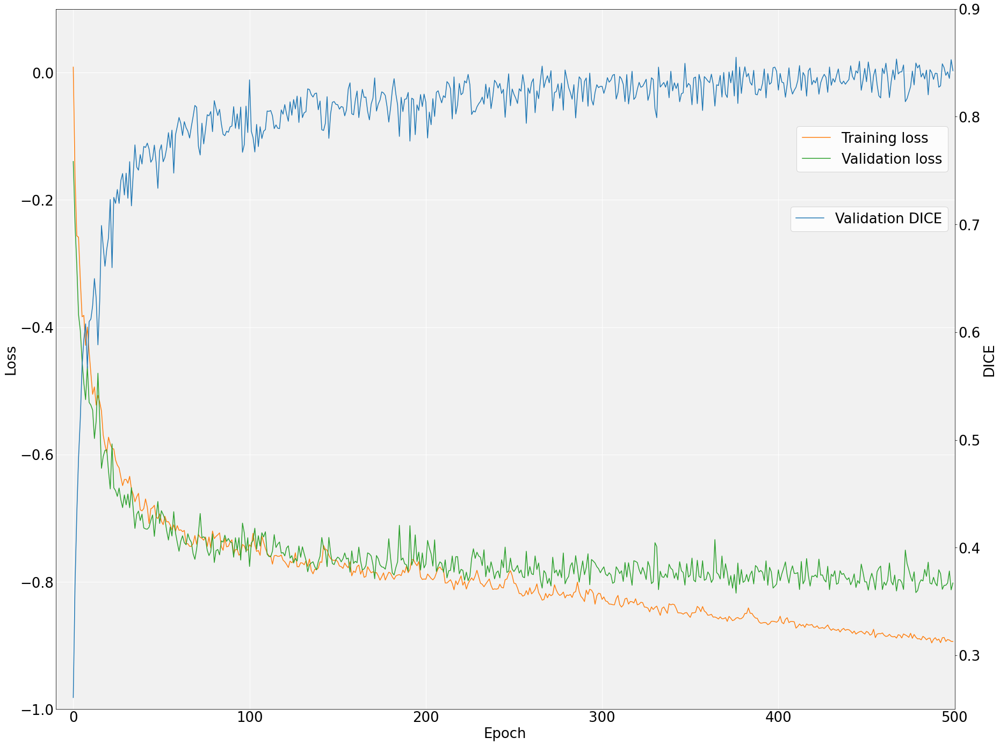

510 3d_lowres 0


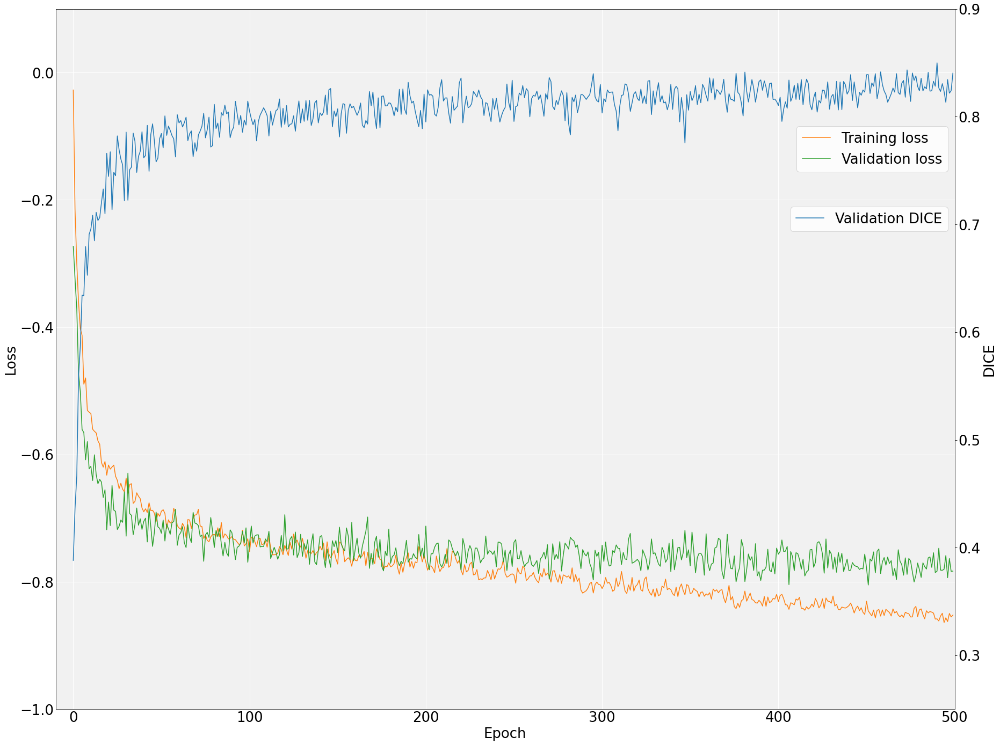

510 3d_cascade_fullres 0


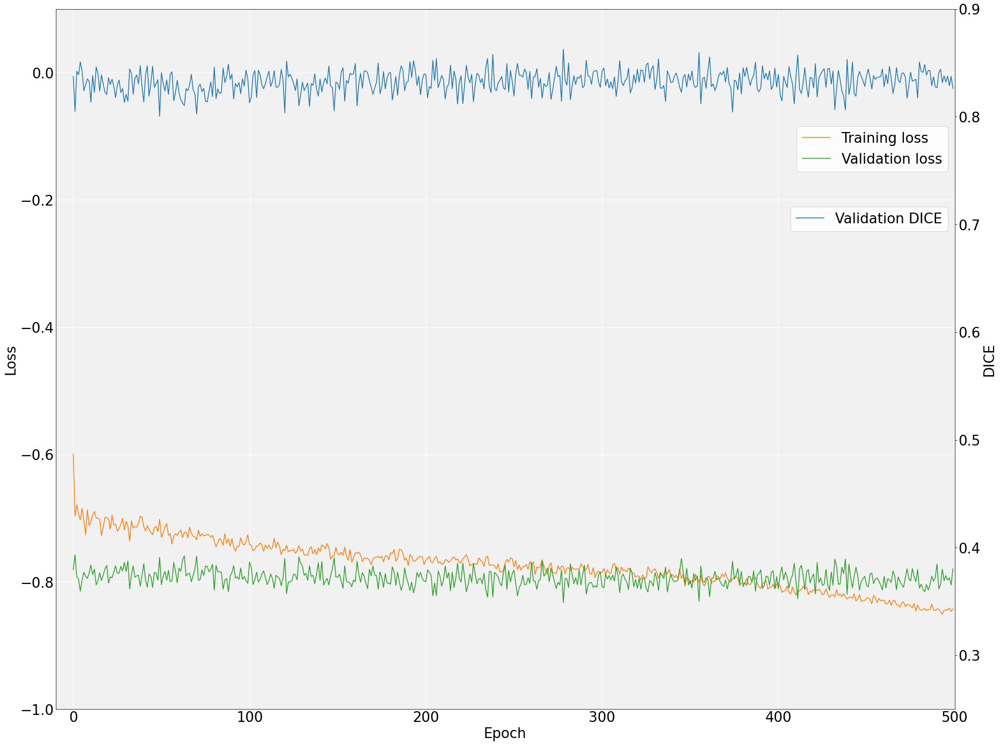

561 3d_fullres 0


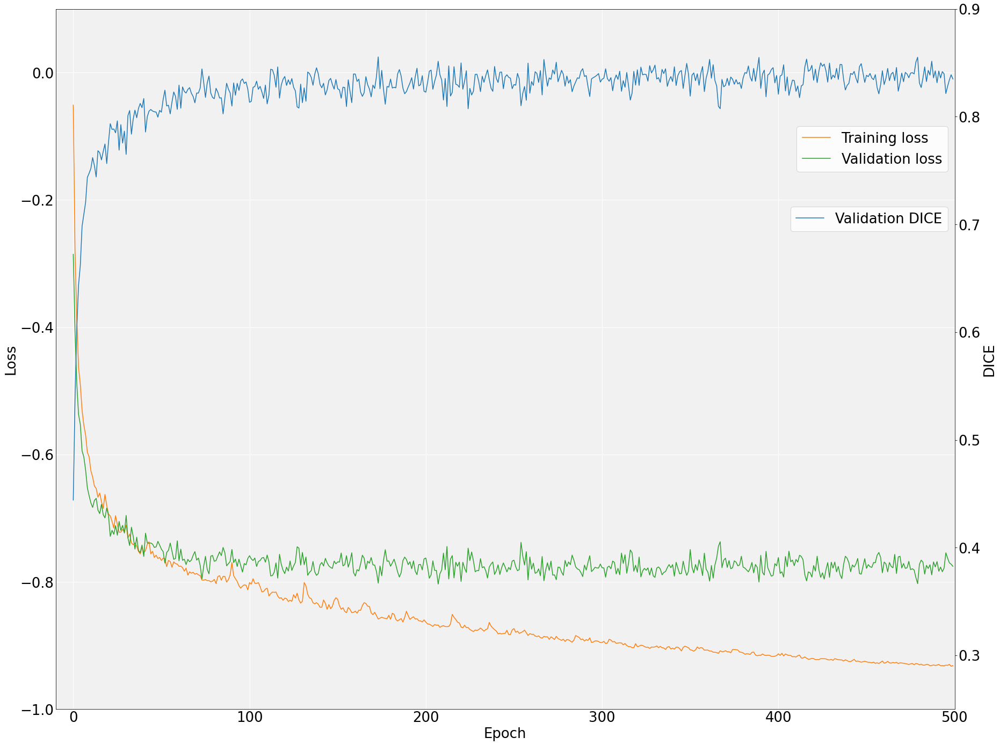

In [40]:
config = con.CONFIG_FULL
folds = [0]
labels = [1]

# Bigger font size
plt.rcParams.update({'font.size': 26})

for task in [con.TASK_501, con.CROP_TASK_MAPPING[con.TASK_501], con.TASK_510, con.CROP_TASK_MAPPING[con.TASK_510]]:
    for config in [con.CONFIG_FULL, con.CONFIG_LOW, con.CONFIG_CAS_FULL]:
        # Cropped tasks do not have low resolution config
        if (task != con.TASK_501 and task != con.TASK_510) and config != con.CONFIG_FULL:
            continue

        # Create convergence plots for each fold 
        for fold in folds:
            print(task, config, fold)
            # Load debug file for fold
            debug = open(os.path.join(thesis_path, "Results", str(task), config, trainer, f"fold_{fold}_dir", "debug.json"))
            debug = json.load(debug)

            # Load metrics
            tr_losses = mana.convert_string_array_to_list(debug["all_tr_losses"])
            val_losses = mana.convert_string_array_to_list(debug["all_val_losses"])
            val_metrics = mana.convert_string_array_to_list(debug["all_val_eval_metrics"])
            epochs = range(0,len(tr_losses))

            # Plot
            fig, ax, ax2 = mana.get_plot_layout(True)
            ax2.plot(epochs, val_metrics, label="Validation DICE", c="C0", ls='-')
            ax.plot(epochs, tr_losses, label="Training loss", c="C1", ls='-')
            ax.plot(epochs, val_losses, label="Validation loss", c="C2", ls='-')
            ax.set_xlabel("Epoch")
            ax.set_ylabel("Loss")
            ax2.set_ylabel("DICE")
            if con != con.CONFIG_CAS_FULL:
                # NIH
                if task == con.TASK_501 or task == con.CROP_TASK_MAPPING[con.TASK_501]:
                    ax.set_ylim(-1, 0)
                    ax2.set_ylim(0.35, 0.9)
                # MSD
                else:
                    ax.set_ylim(-1, 0.1)
                    ax2.set_ylim(0.25, 0.9)
            ax.set_xlim(-10,500)
            ax.legend(loc=7, bbox_to_anchor=(1, 0.8))
            ax2.legend(loc=7, bbox_to_anchor=(1, 0.7))

            # Save
            plt.savefig(f"{figures_path}/{task}/convergence_fullsize_single_fold_{task}_{config}_{trainer}_{fold}", dpi=200, figsize=(8,5), bbox_inches='tight')
            plt.show()

# Back to default font size
plt.rcParams.update({'font.size': 10})

Then we visualise the inter-fold stability metrics of all the network resolution configurations of the two tasks

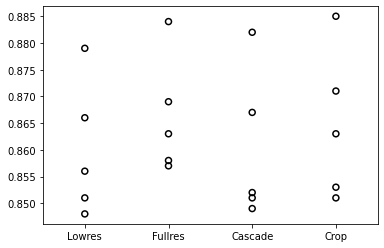

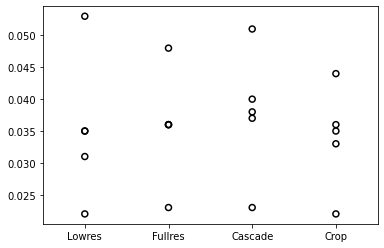

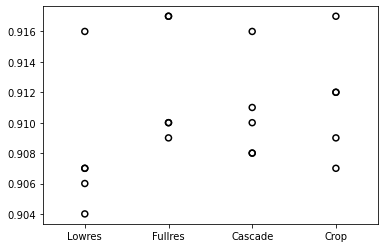

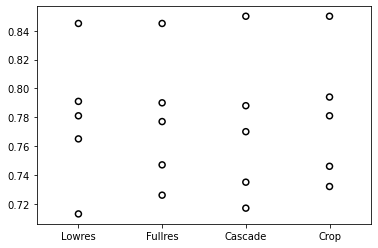

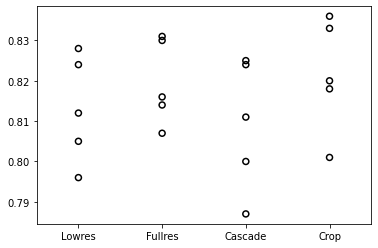

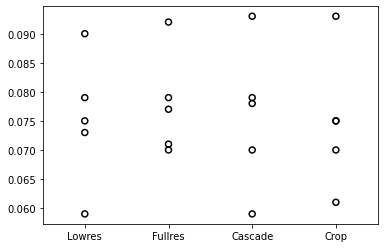

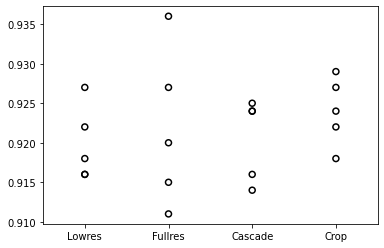

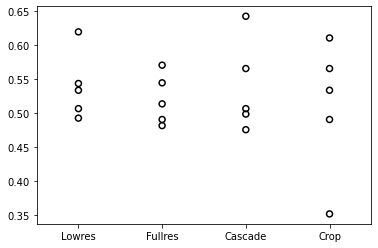

In [5]:
tasks = [con.TASK_501, con.TASK_510]
metrics = ["Mean", "Std", "Max", "Min"]
names = {"Lowres" : con.CONFIG_LOW,
        "Fullres" : con.CONFIG_FULL,
        "Cascade" : con.CONFIG_CAS_FULL,
        "Crop" : con.CONFIG_FULL}

for task in tasks:
    for met in metrics:
        # Get the data for that specific metric for all 4 configs
        data_dict = {}
        for config in names.keys():
            if config == "Crop":
                task_path = f"{results_path}\\{con.CROP_TASK_MAPPING[task]}" # cropped task
            else:
                task_path = f"{results_path}\\{task}" # regular task
            df = pd.read_csv(os.path.join(task_path, f'singlefolds_{names[config]}_{trainer}.csv'), delimiter=";")
            data_dict[config] = df[met]

        # Plot all 4 config metrics        
        fig, ax = plt.subplots()
        ax.boxplot(data_dict.values(), whis=0, showmeans=False, showbox=False, showcaps=False, showfliers = False, medianprops={"linewidth" : "0"})#, flierprops = props, capprops = props)
        for i, x in enumerate(data_dict.keys()):
            ax.scatter([i+1 for _ in data_dict[x]], data_dict[x], marker=MarkerStyle("o", fillstyle="none"), c="black")
        ax.set_xticklabels(data_dict.keys())

        # Save
        plt.savefig(f"{figures_path}\\{task}\\boxplot_{task}_interfolds_allconfigs_{met}.png", dpi=200, bbox_inches= 'tight')

Results experiment 1 - Qualitative analysis

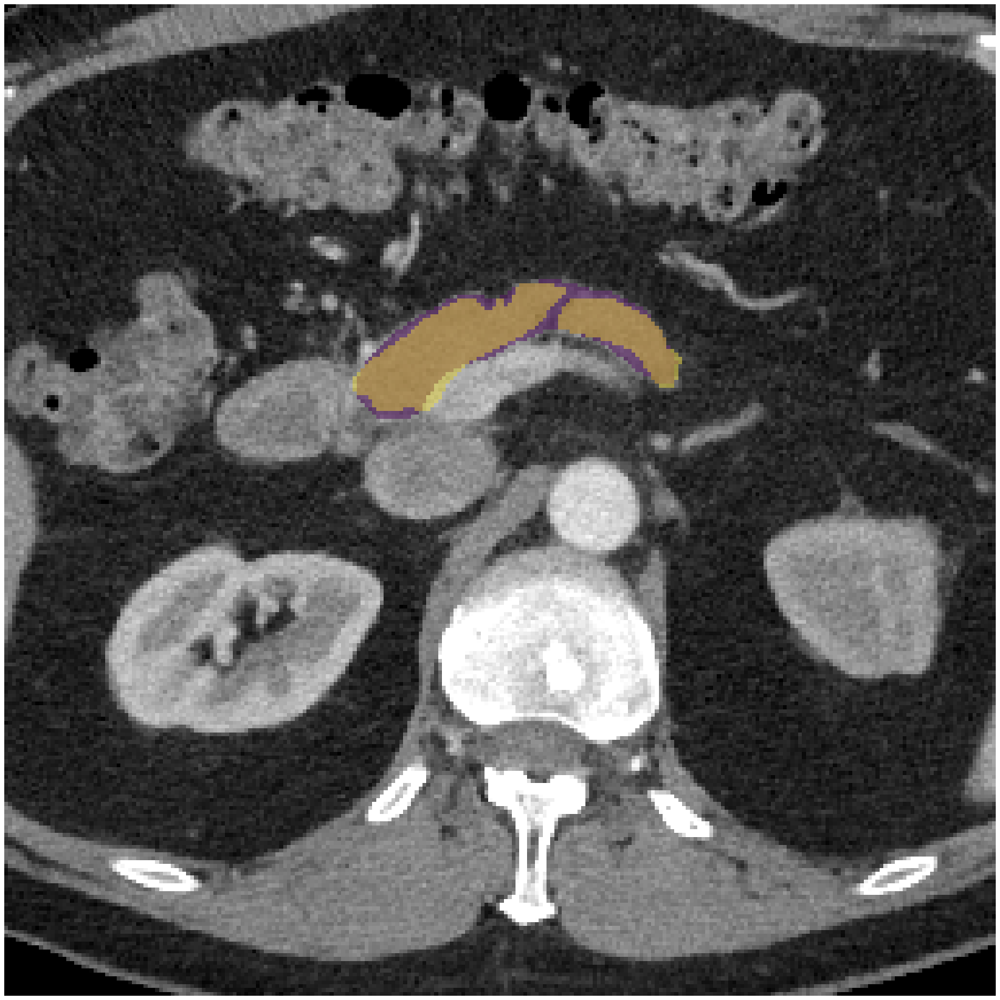

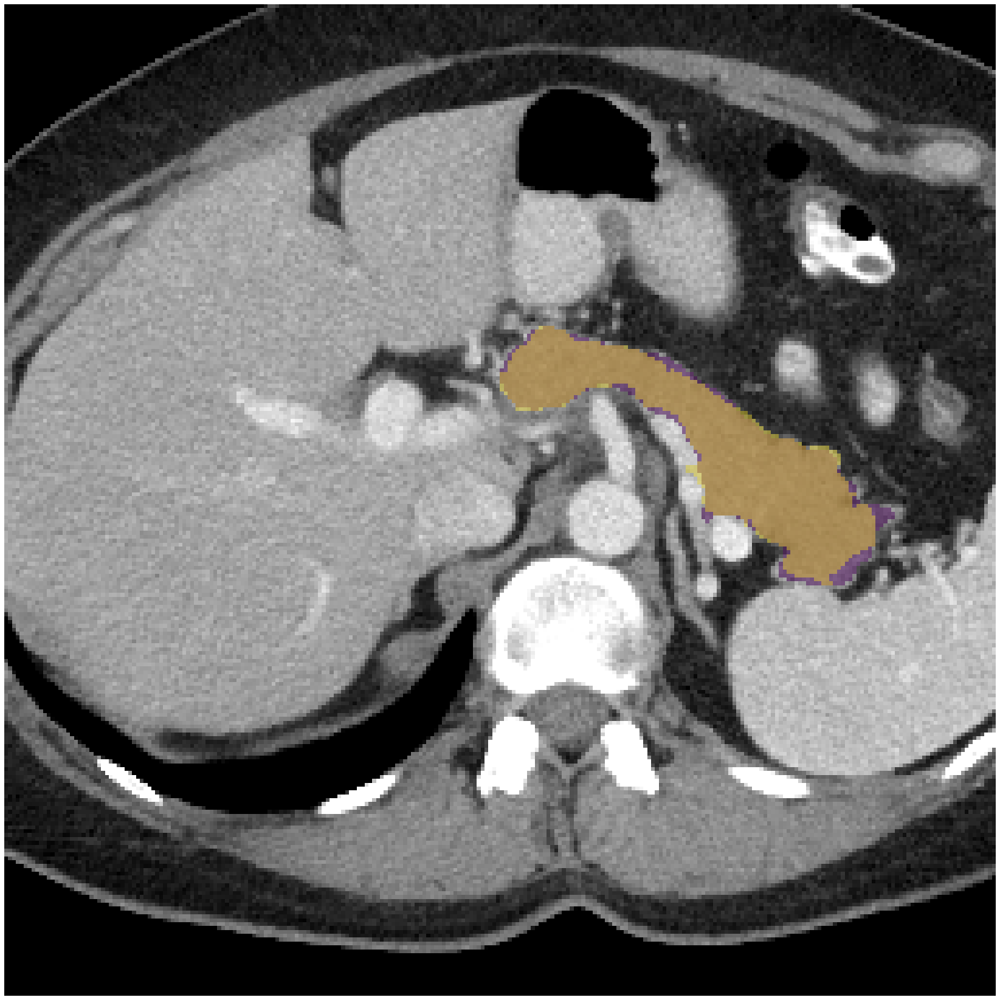

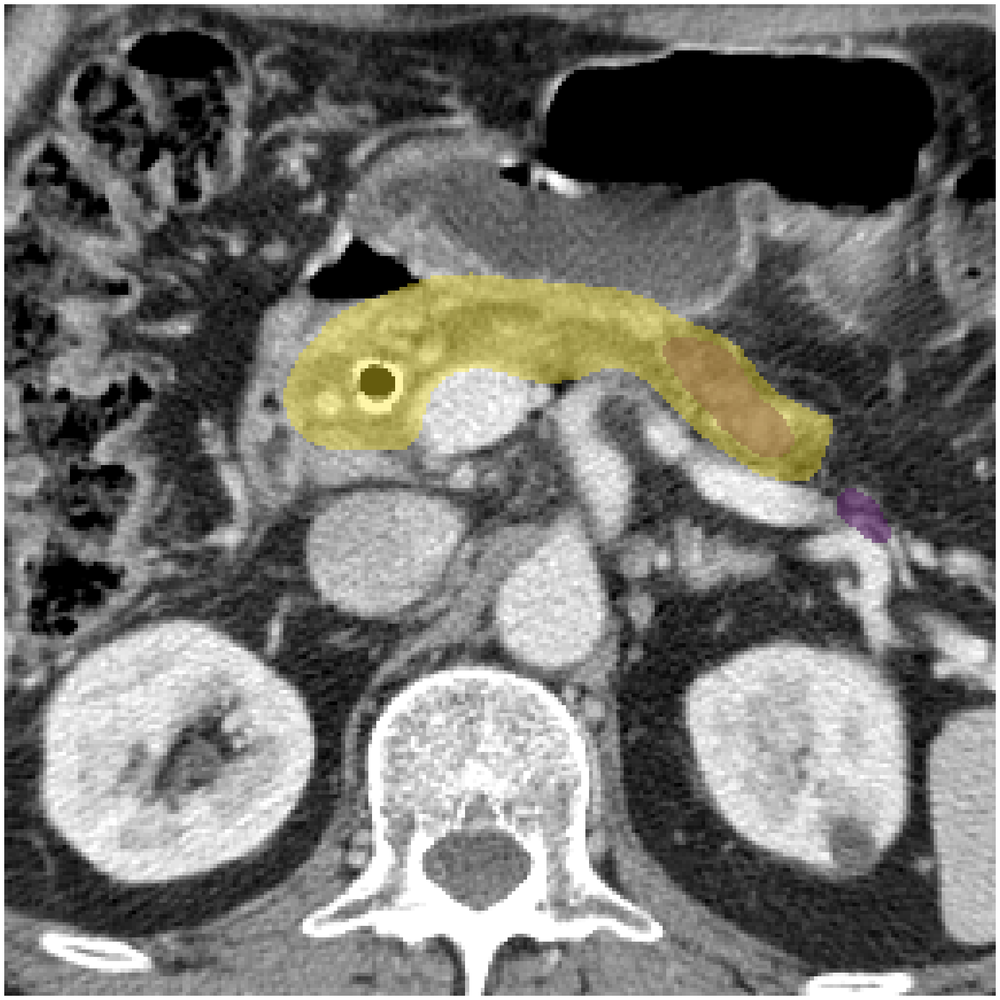

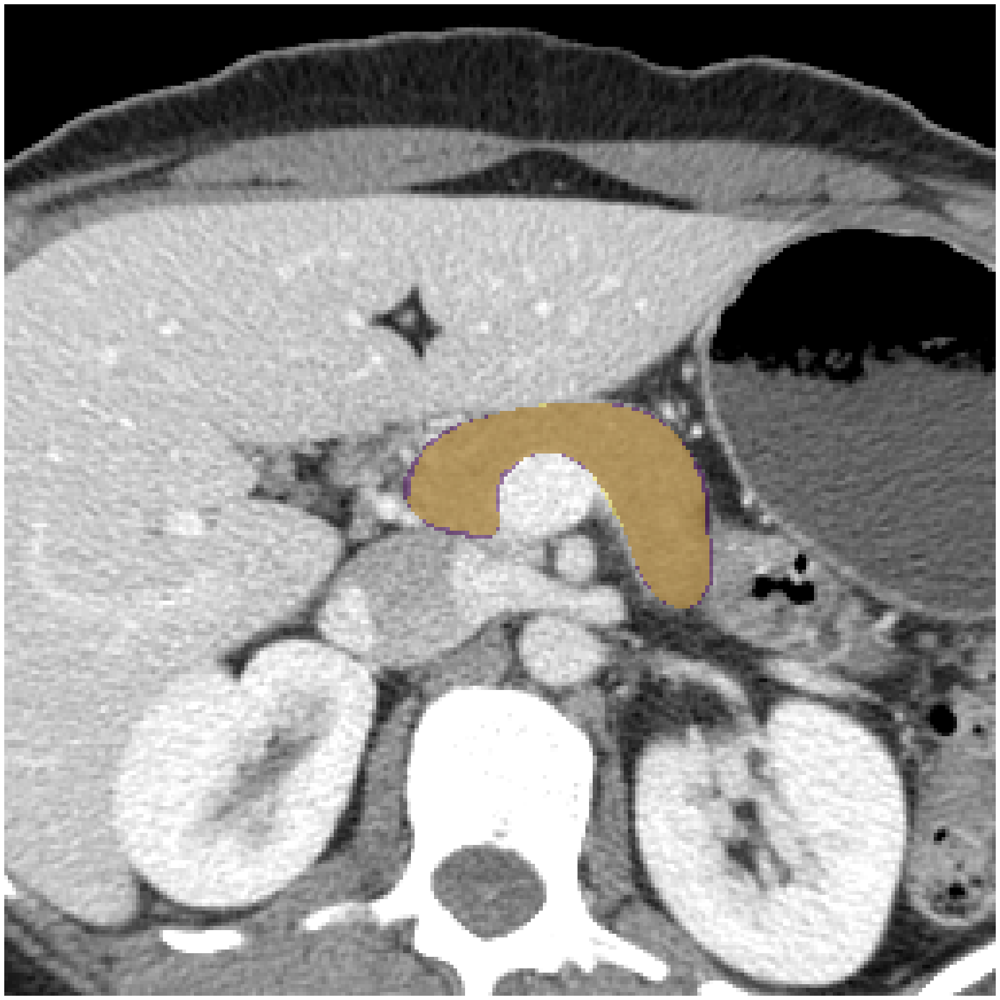

In [6]:
''' NIH '''
task = con.TASK_501
figure = "results_nih_qualitative"

# BAD
config = con.CONFIG_CAS_FULL
data_path, img_path, segmentation_path, label_path = get_paths(task, config, con.TEST, trainer)
create_2d(5, 104, img_path, label_path, modality, segmentation_path, f'{figure}_0', TRANSPOSE, showSeg=True, zoom=True)

# GOOD
config = con.CONFIG_FULL
data_path, img_path, segmentation_path, label_path = get_paths(task, config, con.TEST, trainer)
create_2d(8, 117, img_path, label_path, modality, segmentation_path, f'{figure}_1', TRANSPOSE, showSeg=True, zoom=True)

''' MSD ''' 
task = con.TASK_510
figure = "results_msd_qualitative"

# BAD
config = con.CONFIG_CAS_FULL
data_path, img_path, segmentation_path, label_path = get_paths(task, config, con.TEST, trainer)
create_2d(0, 53, img_path, label_path, modality, segmentation_path, f'{figure}_0', ANTITRANSPOSE, showSeg=True, zoom=True)

# GOOD
config = con.CONFIG_FULL
data_path, img_path, segmentation_path, label_path = get_paths(task, config, con.TEST, trainer)
create_2d(40, 55, img_path, label_path, modality, segmentation_path, f'{figure}_1', ANTITRANSPOSE, showSeg=True, zoom=True)

Results experiment 1 to 4: visualise computational demands

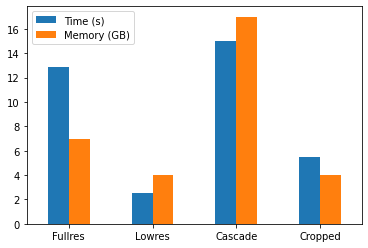

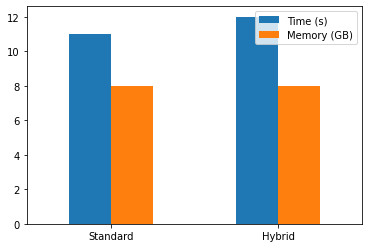

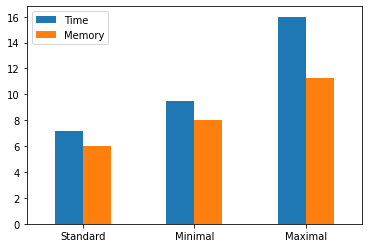

In [7]:
for i in range(1,4):
    df = pd.read_excel(f"{latex_path}/Experiment{i}_performance.xlsx", index_col=0)
    df.plot.bar(rot=0)
    plt.savefig(f"{figures_path}/experiment{i}_performance.png", dpi=200, bbox_inches='tight')  

# Result experiment 2

First, we want to recreate some convergence graphs due to different ranges on the axis.

501 nnUNetTrainerV2 0


C:\Users\ikke_\AppData\Local\Temp\ipykernel_14496\2149330823.py:56: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "figsize" which is no longer supported as of 3.3 and will become an error in 3.6
  plt.savefig(f"{figures_path}/{task}/convergence_fullsize_single_fold_{task}_{config}_{trainer}_{fold}", dpi=200, figsize=(8,5), bbox_inches='tight')


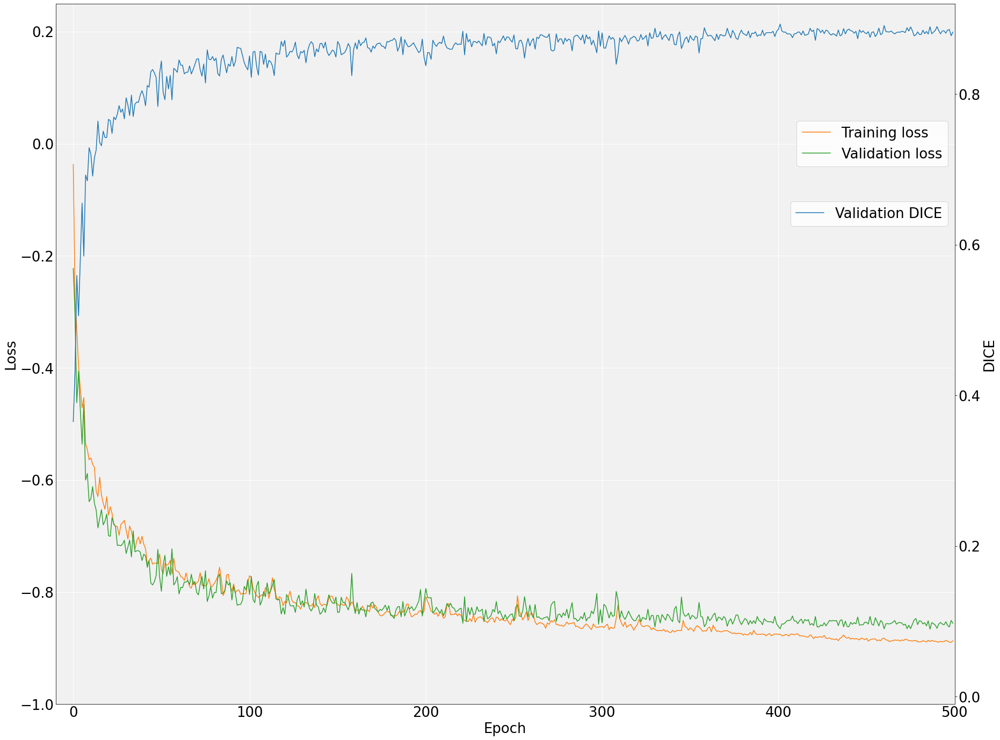

501 nnUNetTrainerV2 1


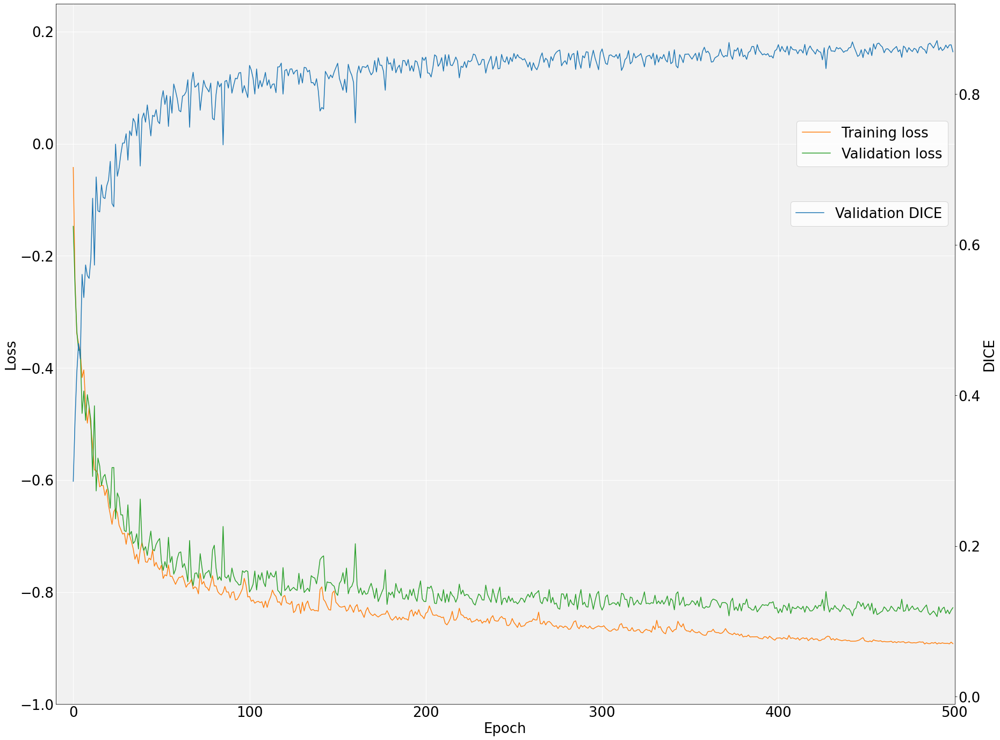

501 nnUNetTrainerV2 3


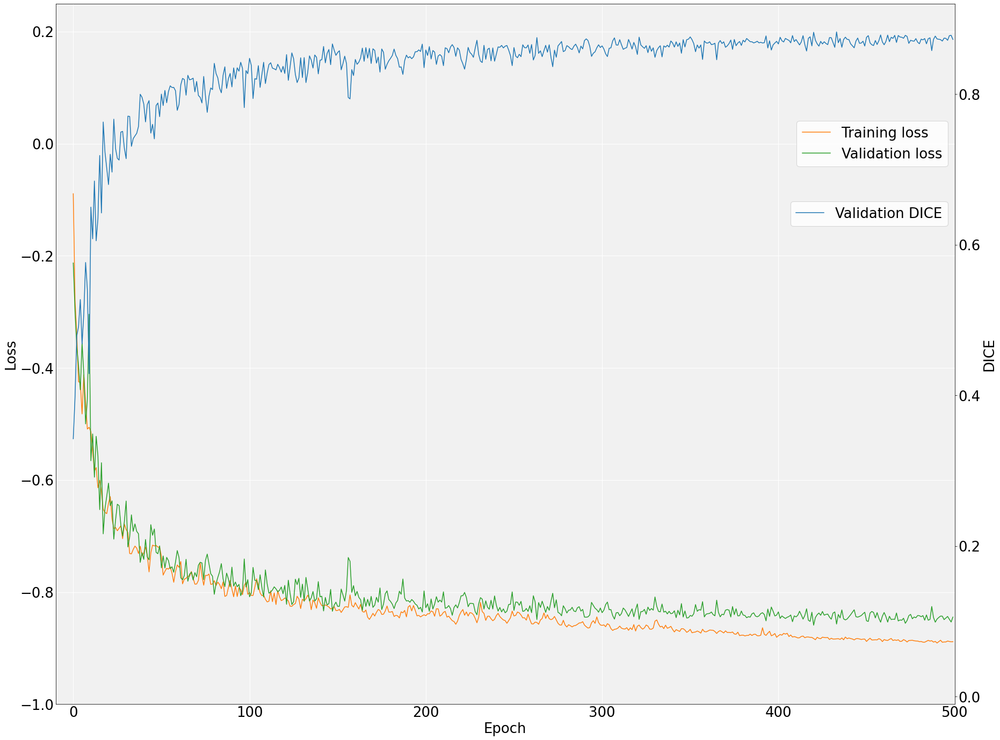

501 nnUNetTrainerV2_1500 0


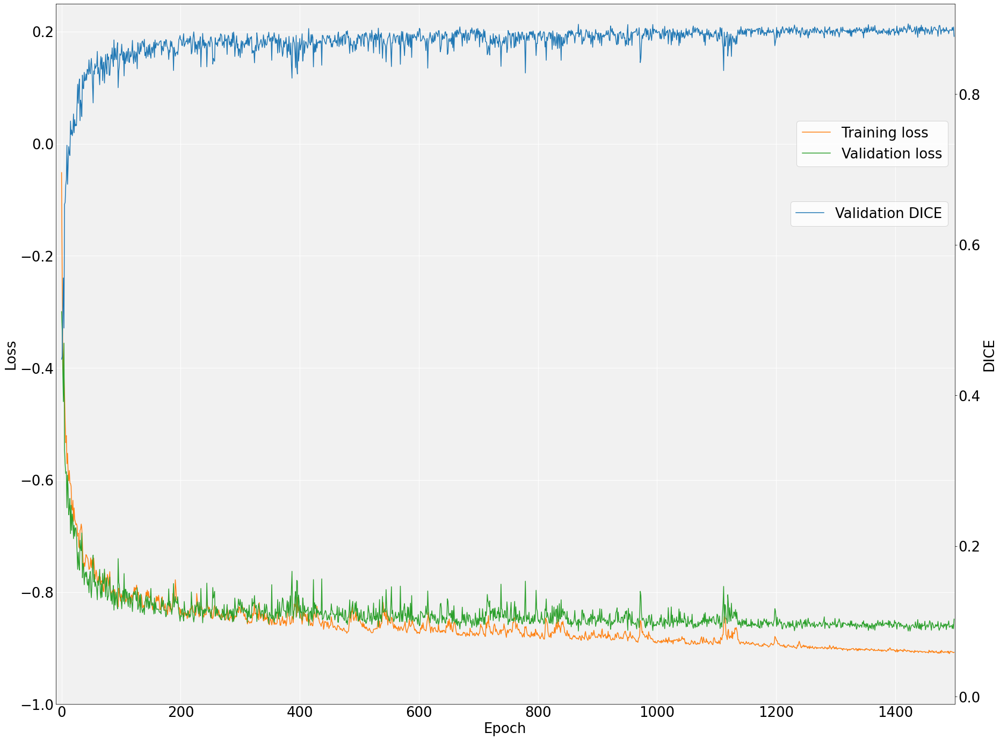

501 nnUNetTrainerV2_1500 1


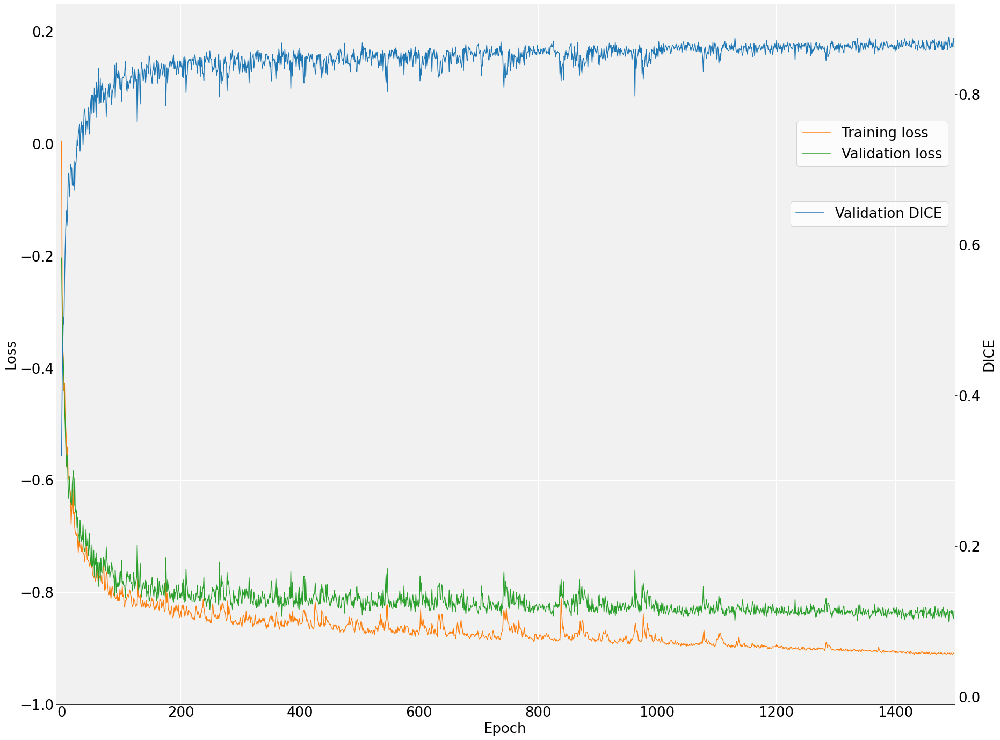

501 nnUNetTrainerV2_1500 3


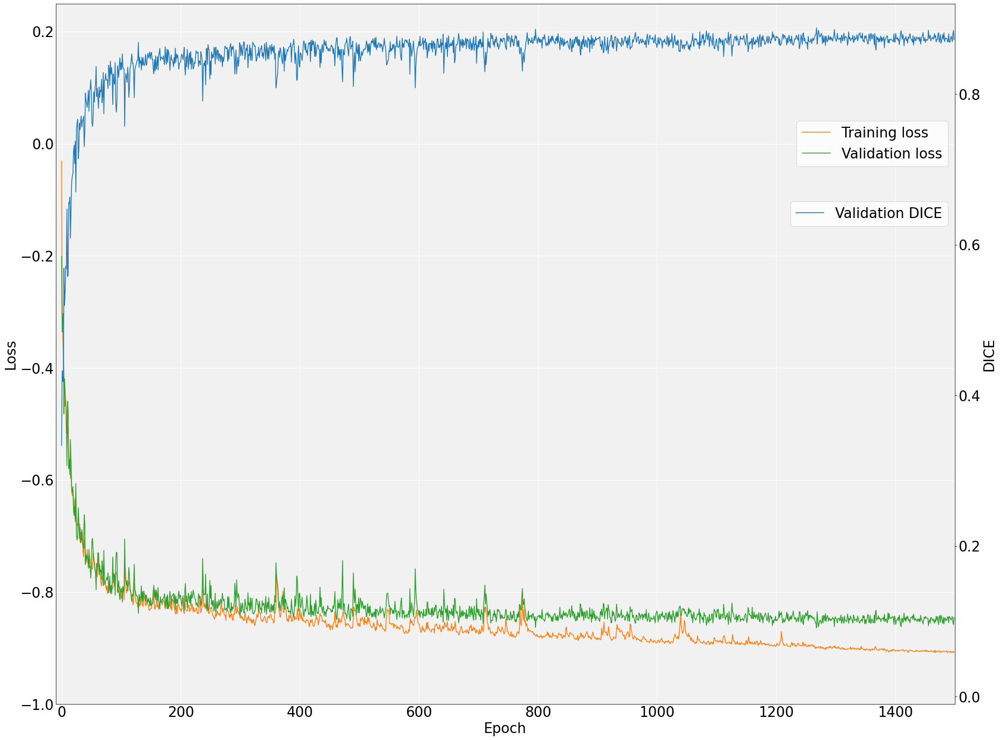

501 nnUNetTrainerV2_Hybrid2 0


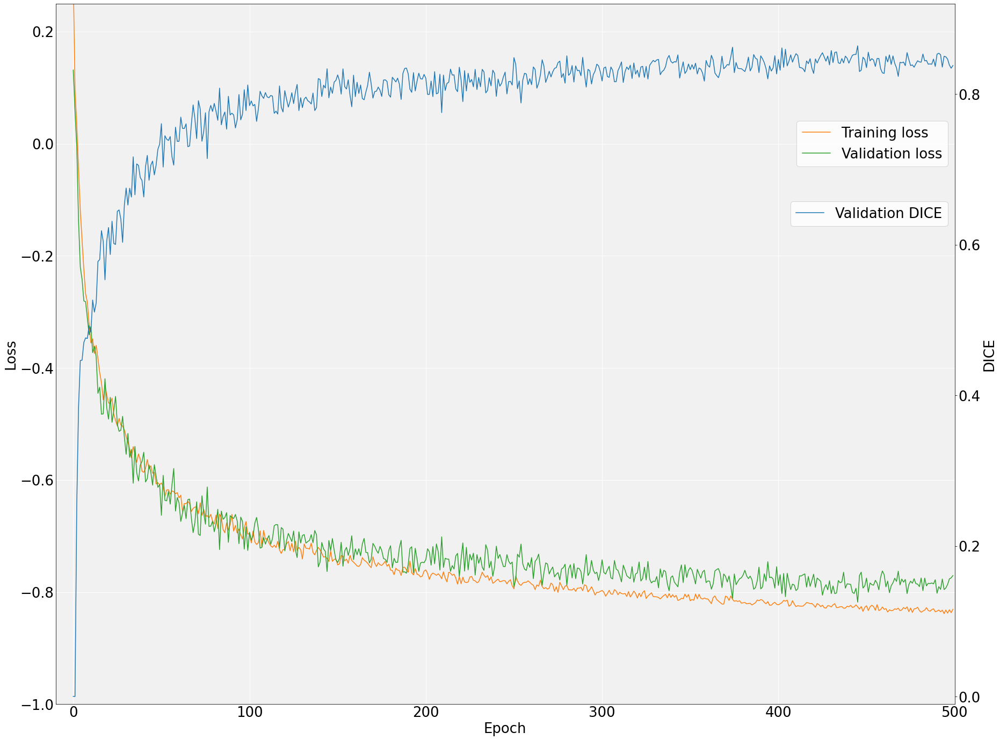

501 nnUNetTrainerV2_Hybrid2 1


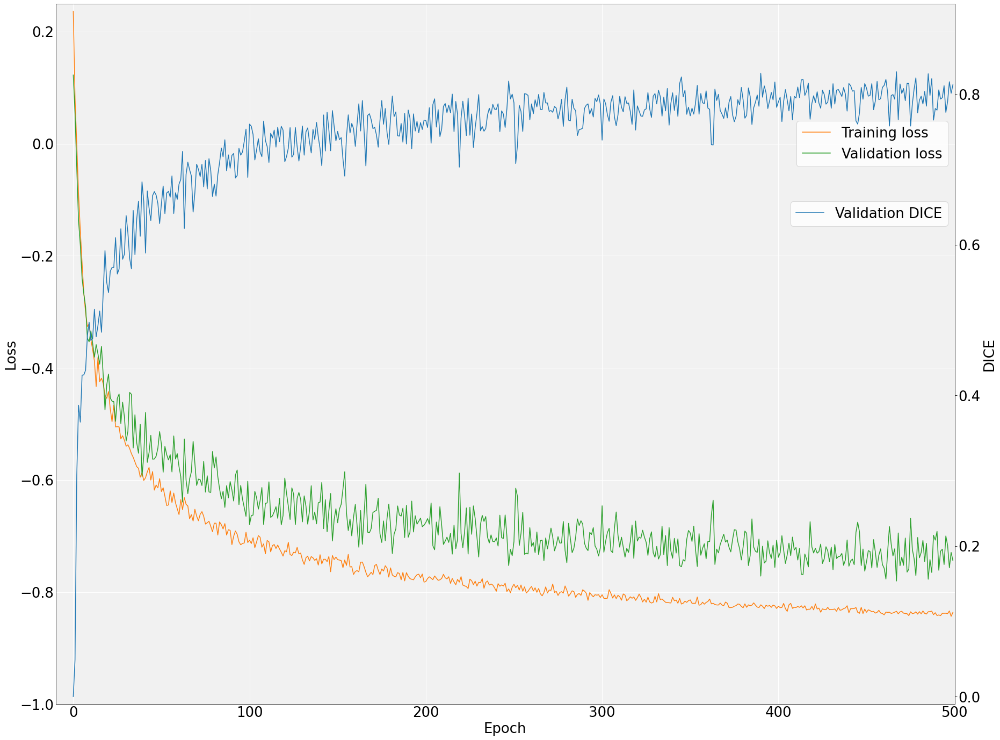

501 nnUNetTrainerV2_Hybrid2 3


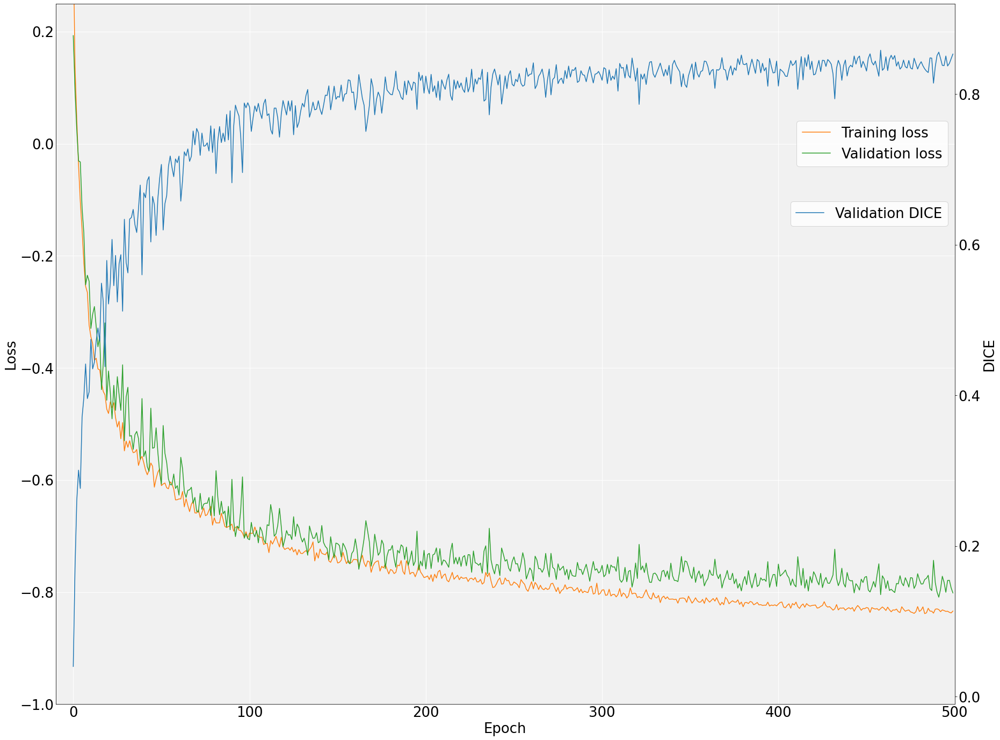

501 nnUNetTrainerV2_Hybrid2LR_1500 0


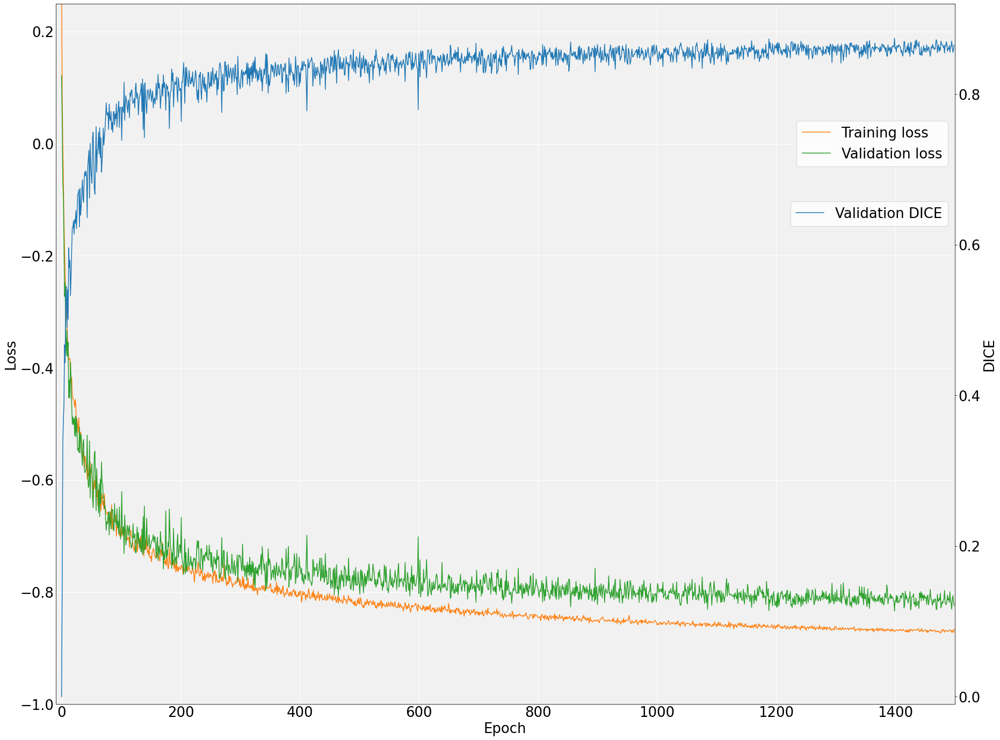

501 nnUNetTrainerV2_Hybrid2LR_1500 1


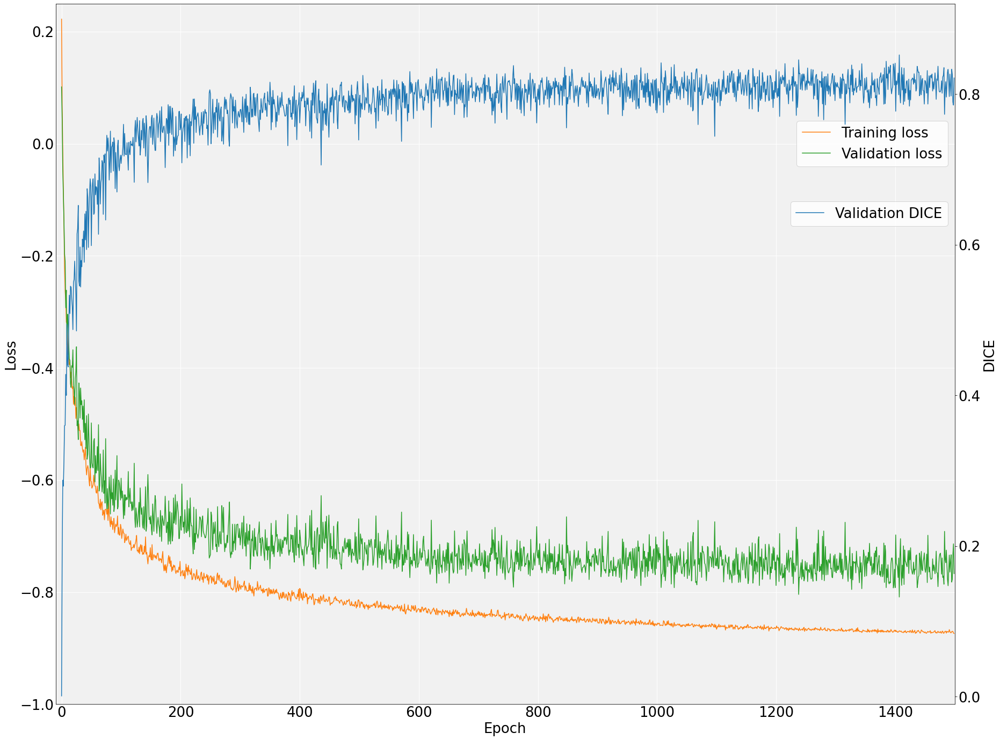

501 nnUNetTrainerV2_Hybrid2LR_1500 3


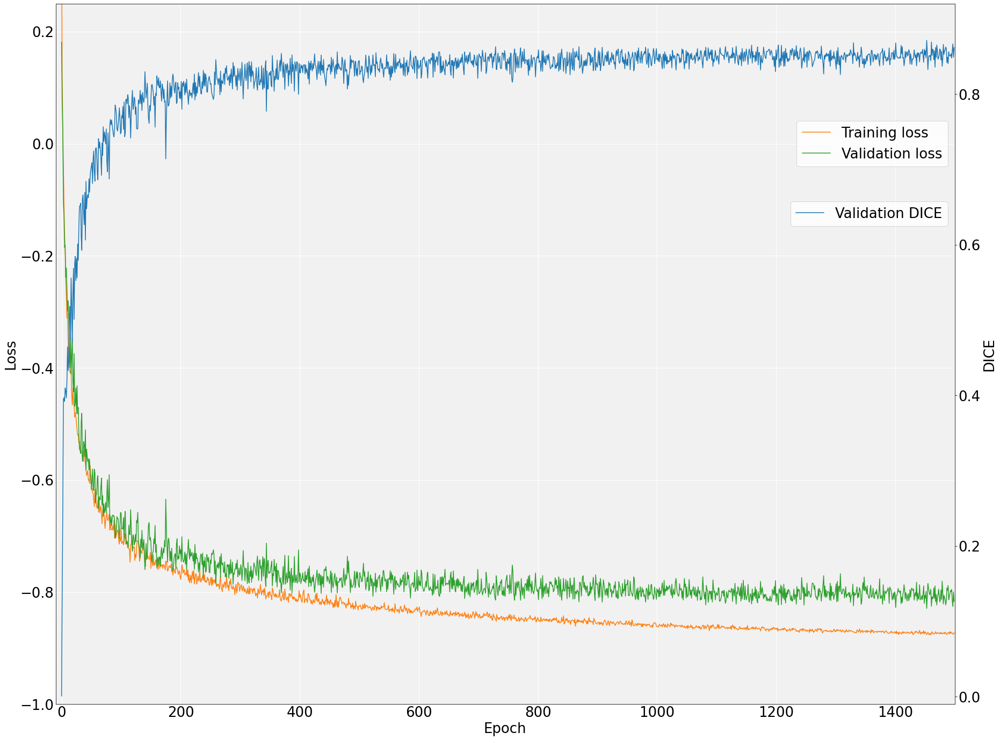

510 nnUNetTrainerV2 0


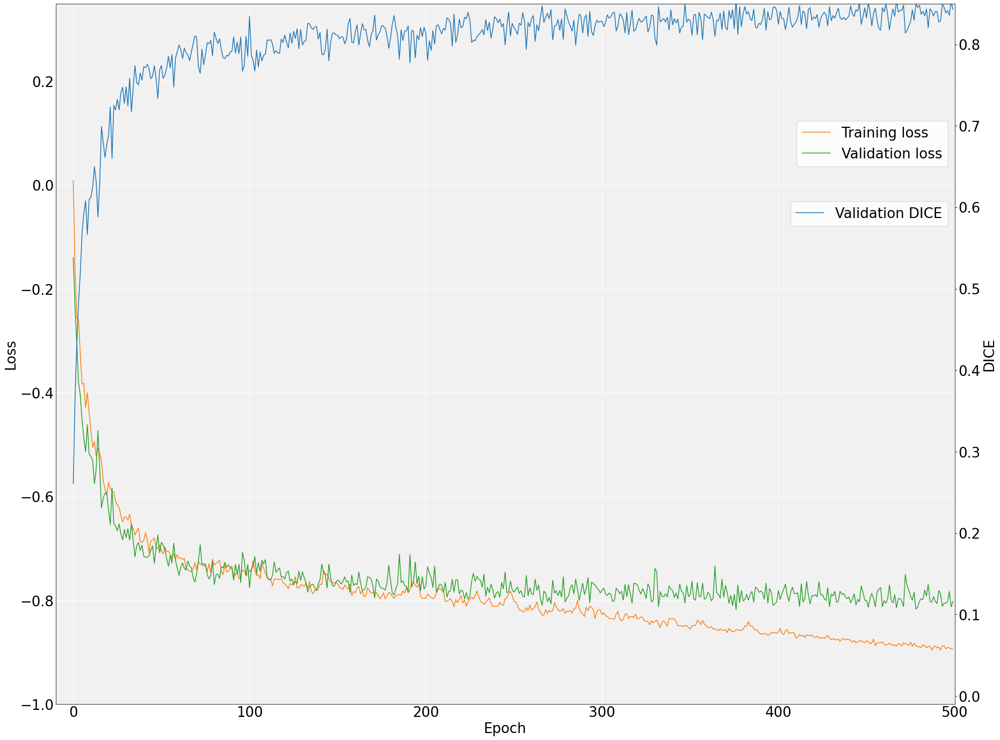

510 nnUNetTrainerV2 1


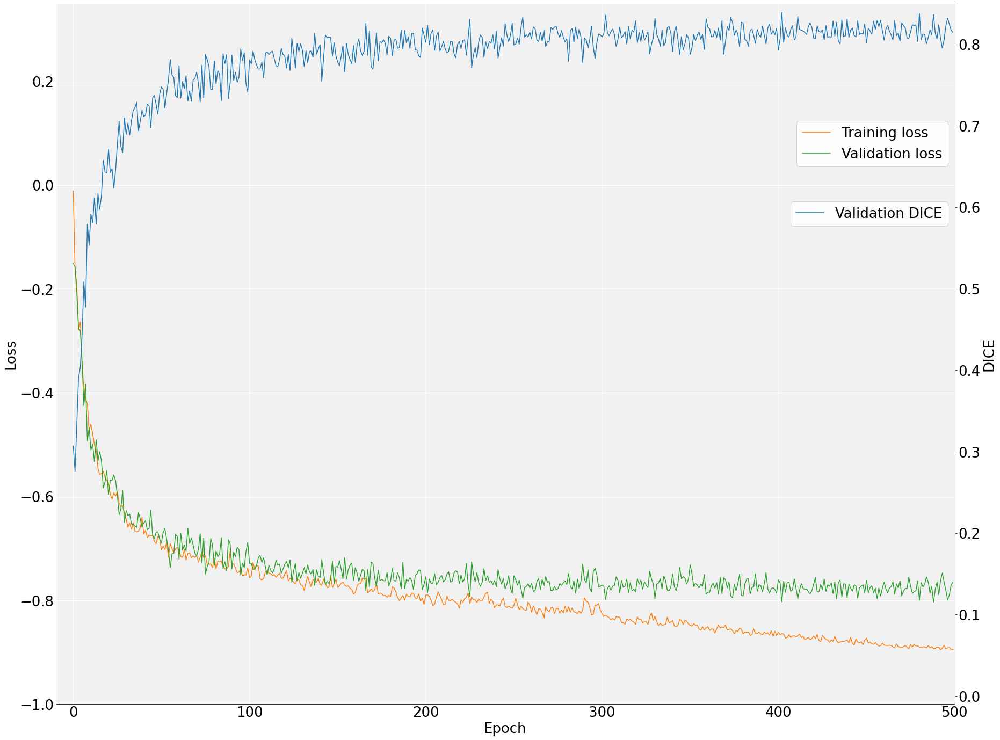

510 nnUNetTrainerV2 3


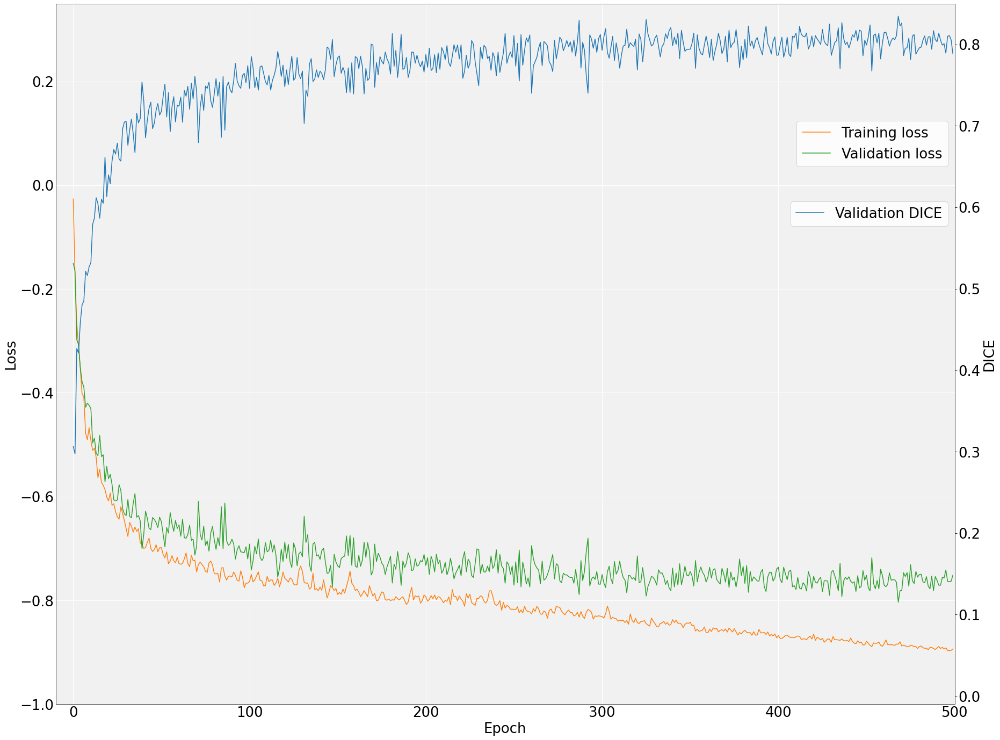

510 nnUNetTrainerV2_Hybrid2 0


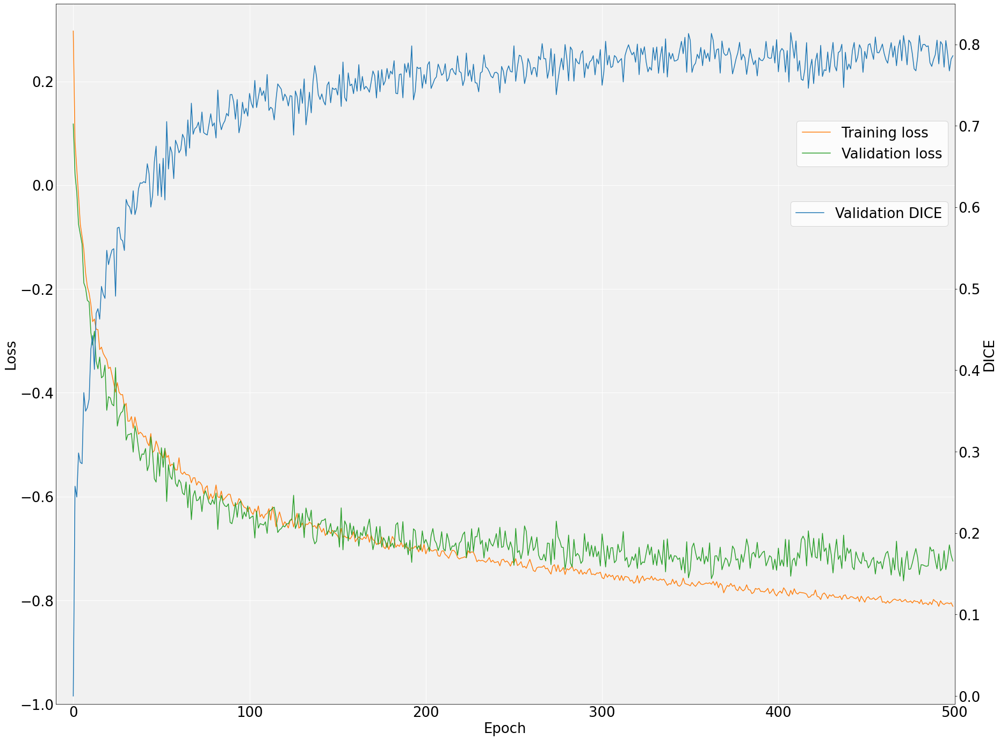

510 nnUNetTrainerV2_Hybrid2 1


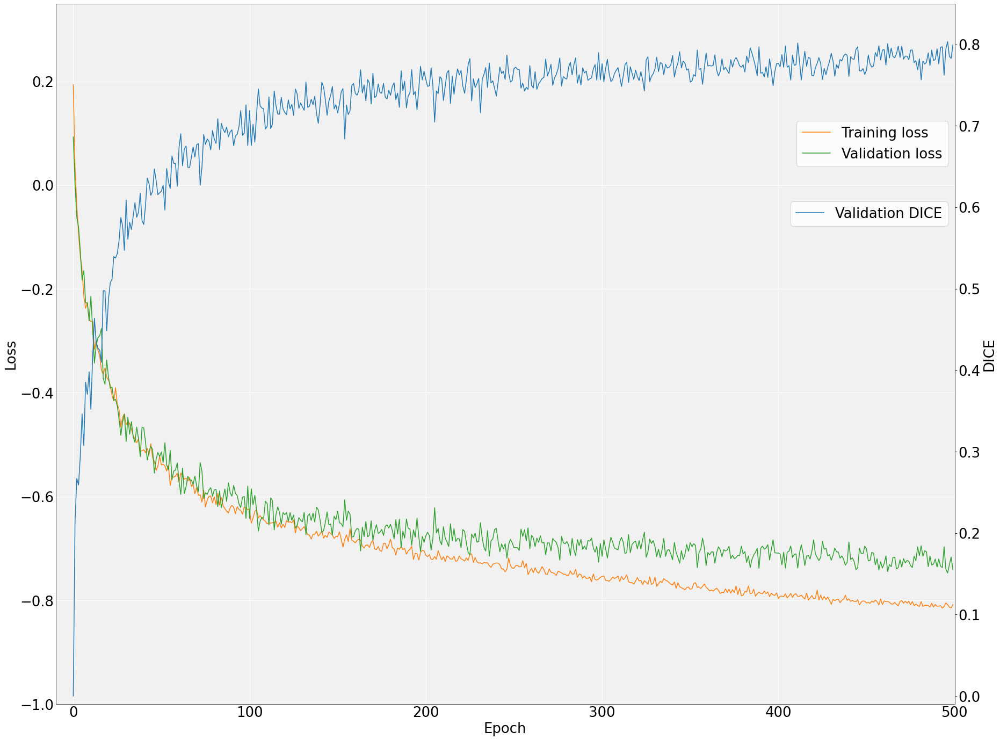

510 nnUNetTrainerV2_Hybrid2 3


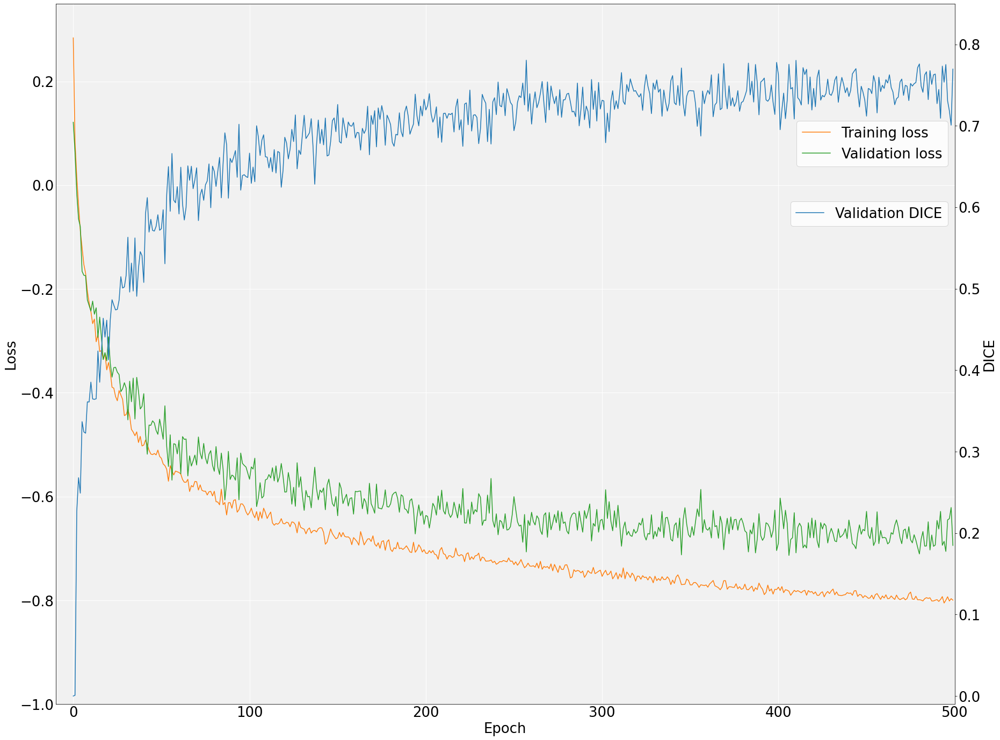

525 nnUNetTrainerV2 0


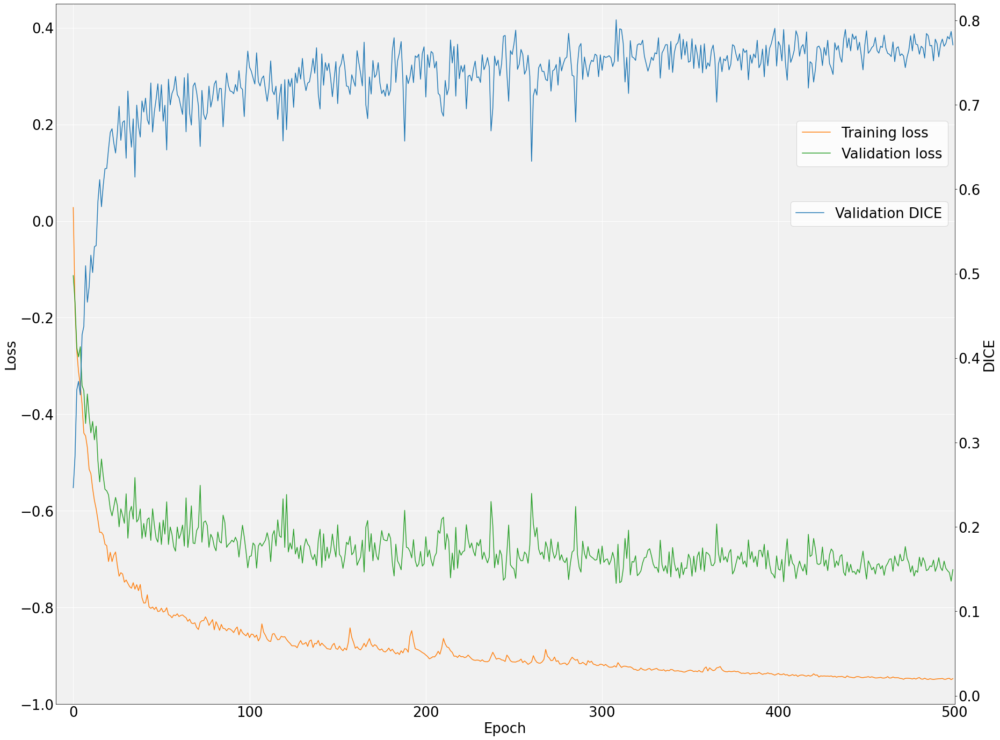

525 nnUNetTrainerV2 1


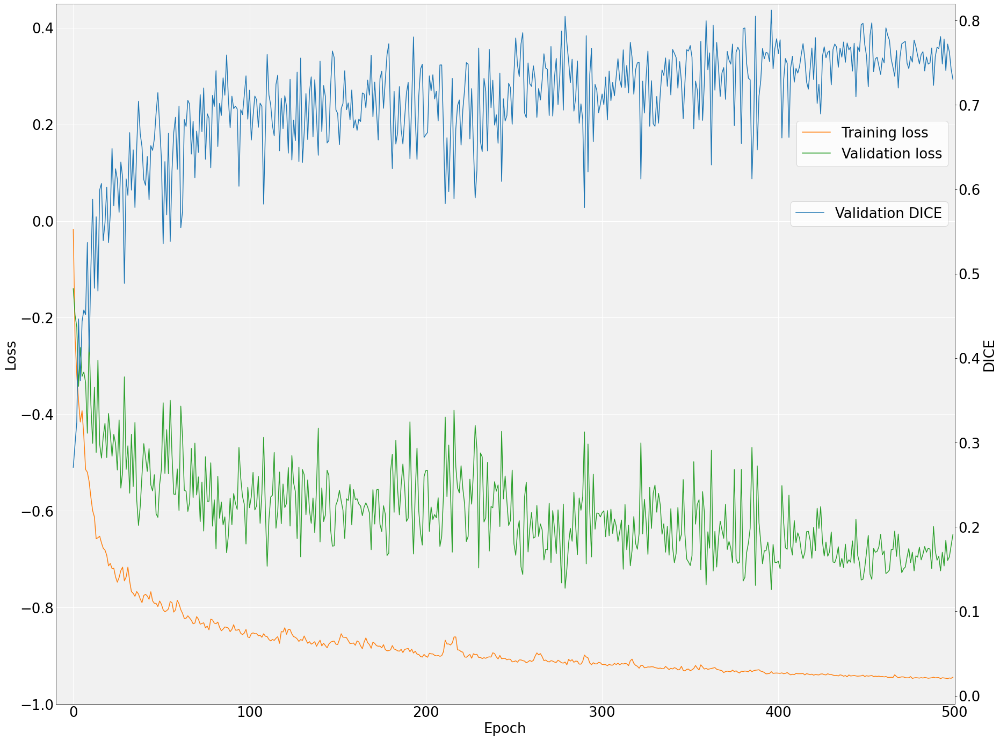

525 nnUNetTrainerV2 3


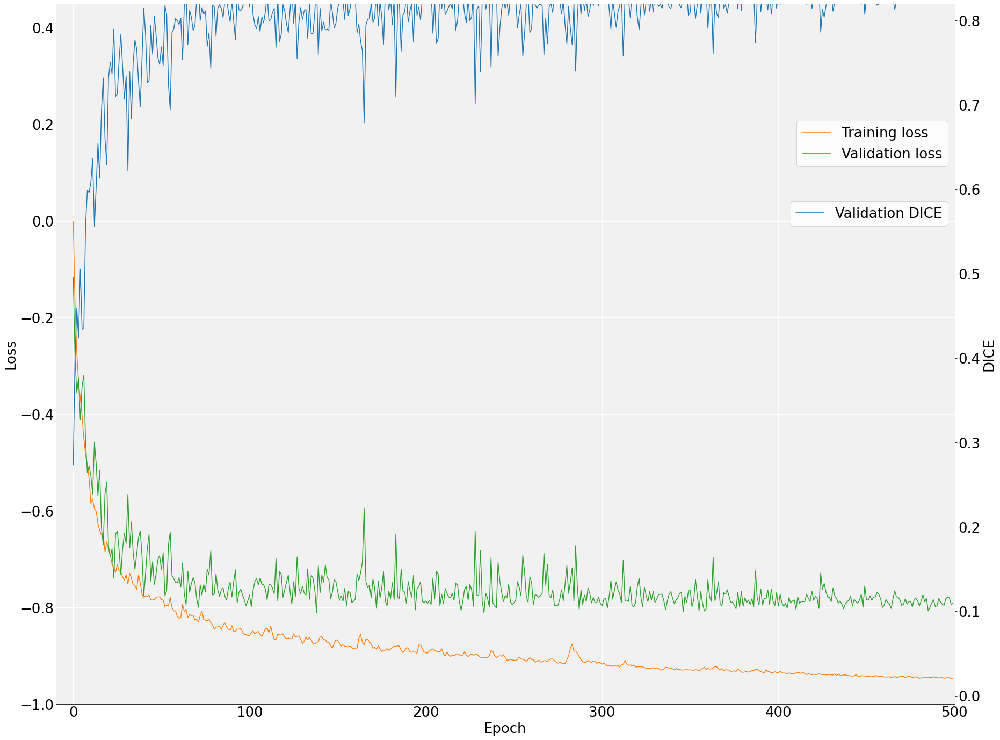

525 nnUNetTrainerV2_Hybrid2 0


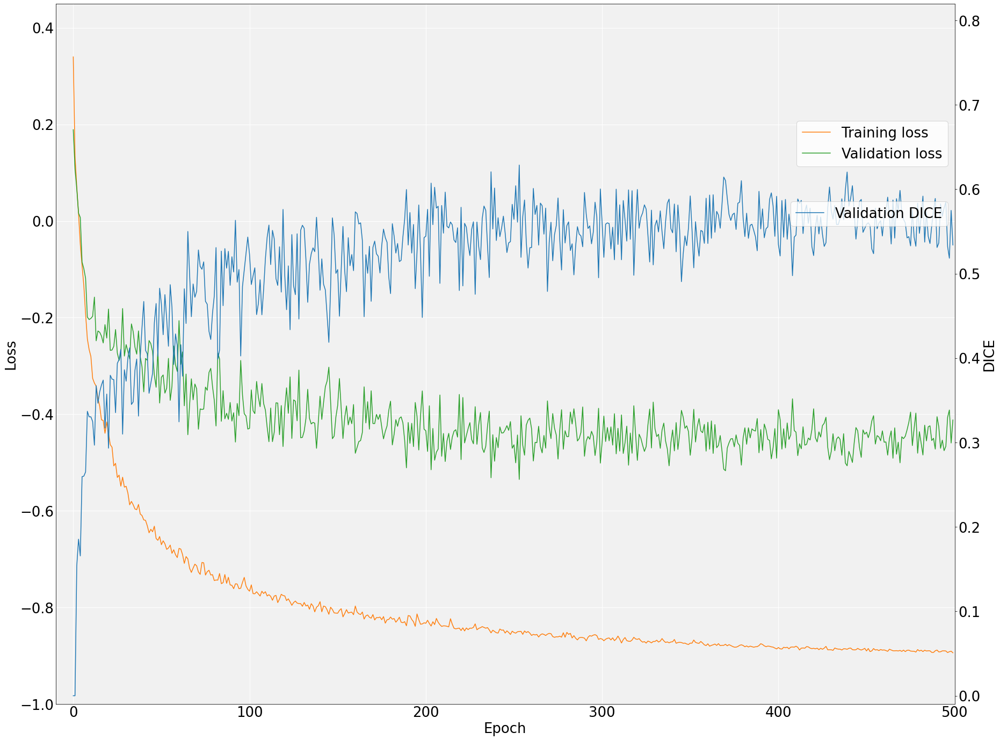

525 nnUNetTrainerV2_Hybrid2 1


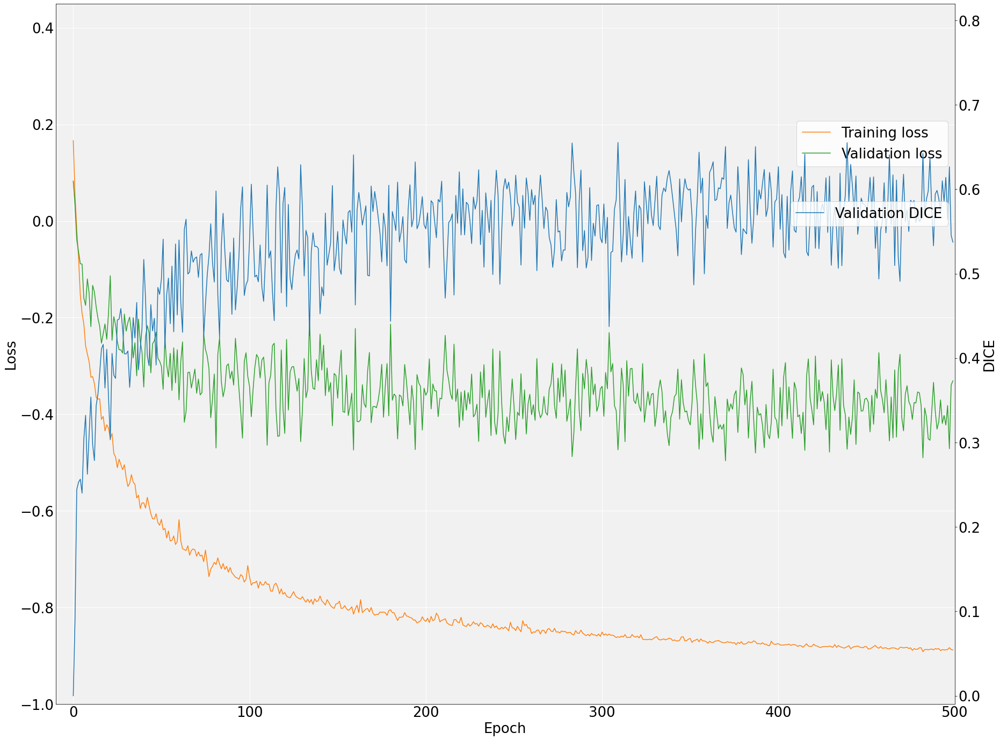

525 nnUNetTrainerV2_Hybrid2 3


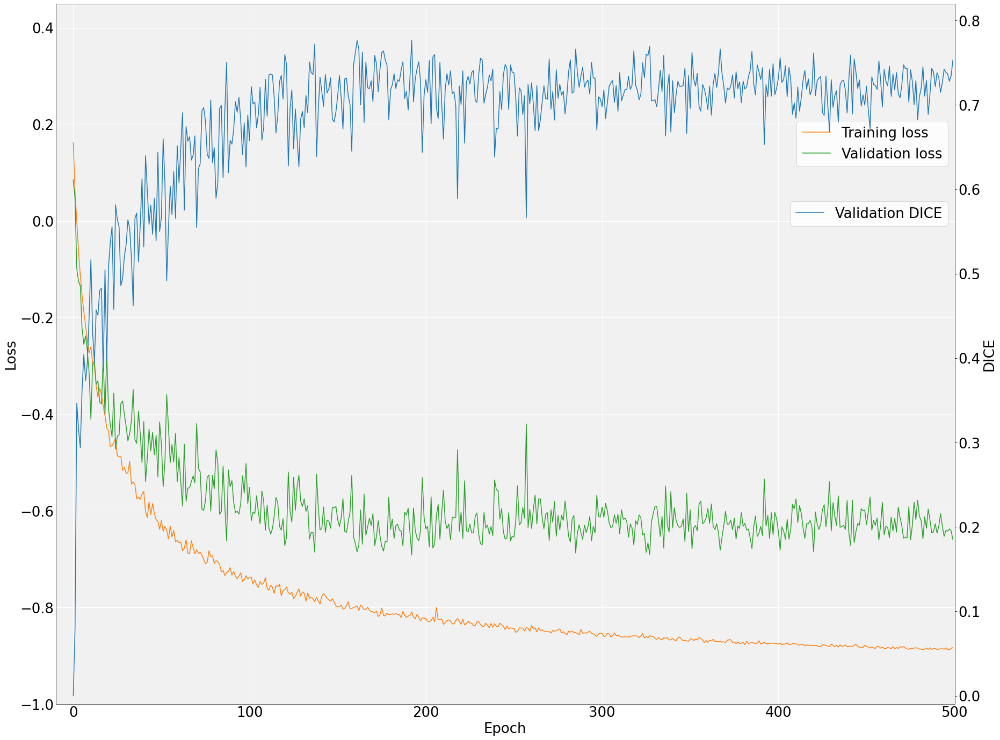

In [41]:
config = con.CONFIG_FULL
folds = [0,1,3]
labels = [1]

# Bigger font size
plt.rcParams.update({'font.size': 26})

for task in [con.TASK_501, con.TASK_510, con.TASK_525]:
    for trainer in [con.CLASSIC, con.CLASSIC_1500, con.HYBRID2, con.HYBRID2LR_1500]:
        # Only NIH was trained till 1500, so skip this configuration for MSD and CSV
        if task != con.TASK_501 and (trainer == con.CLASSIC_1500 or trainer == con.HYBRID2LR_1500):
            continue

        # Create convergence plots for each fold 
        for fold in folds:
            print(task, trainer, fold)
            # Load debug file for fold
            debug = open(os.path.join(thesis_path, "Results", str(task), config, trainer, f"fold_{fold}_dir", "debug.json"))
            debug = json.load(debug)

            # Load metrics
            tr_losses = mana.convert_string_array_to_list(debug["all_tr_losses"])
            val_losses = mana.convert_string_array_to_list(debug["all_val_losses"])
            val_metrics = mana.convert_string_array_to_list(debug["all_val_eval_metrics"])
            epochs = range(0,len(tr_losses))

            # Plot
            fig, ax, ax2 = mana.get_plot_layout(True)
            ax2.plot(epochs, val_metrics, label="Validation DICE", c="C0", ls='-')
            ax.plot(epochs, tr_losses, label="Training loss", c="C1", ls='-')
            ax.plot(epochs, val_losses, label="Validation loss", c="C2", ls='-')
            ax.set_xlabel("Epoch")
            ax.set_ylabel("Loss")
            # MSD
            if task == con.TASK_510:
                ax.set_ylim(-1, 0.35)
                ax2.set_ylim(-0.01, 0.85)
            # BCV
            elif task == con.TASK_525:
                ax.set_ylim(-1, 0.45)
                ax2.set_ylim(-0.01, 0.82)
            # NIH
            else:
                ax.set_ylim(-1, 0.25)
                ax2.set_ylim(-0.01, 0.92)

            if trainer == con.CLASSIC_1500 or trainer == con.HYBRID2LR_1500:
                ax.set_xlim(-10,1500)
            else:
                ax.set_xlim(-10,500)
            ax2.set_ylabel("DICE")
            ax.legend(loc=7, bbox_to_anchor=(1, 0.8))
            ax2.legend(loc=7, bbox_to_anchor=(1, 0.7))

            # Save
            plt.savefig(f"{figures_path}/{task}/convergence_fullsize_single_fold_{task}_{config}_{trainer}_{fold}", dpi=200, figsize=(8,5), bbox_inches='tight')
            plt.show()

# Back to default font size
plt.rcParams.update({'font.size': 10})

Experiment 2 - visualise inter-folds stability metrics for each task

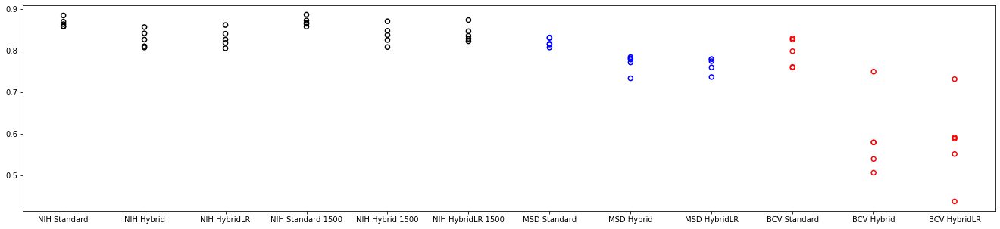

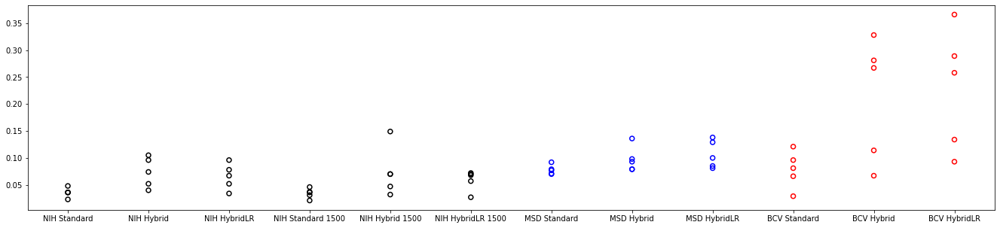

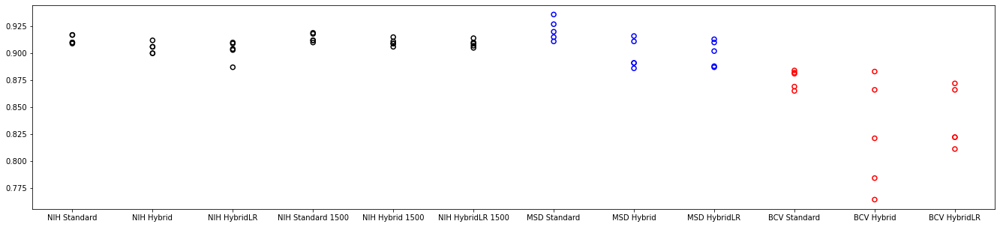

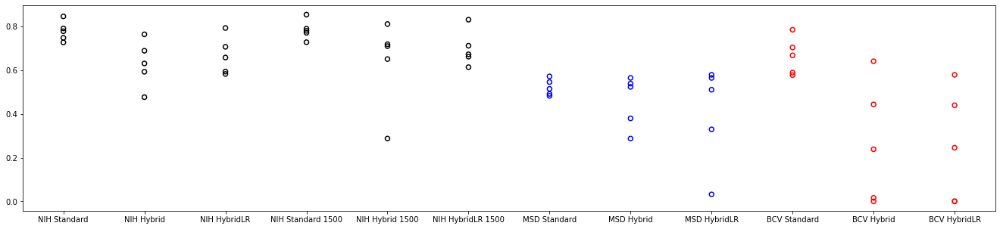

In [28]:
tasks = [con.TASK_501, con.TASK_510, con.TASK_525]
config = con.CONFIG_FULL
metrics = ["Mean", "Std", "Max", "Min"]
names = {"Standard" : con.CLASSIC,
        "Hybrid" : con.HYBRID2,
        "HybridLR" : con.HYBRID2LR,
        "Standard 1500" : con.CLASSIC_1500,
        "Hybrid 1500" : con.HYBRID2_1500,
        "HybridLR 1500" : con.HYBRID2LR_1500}

# Create 1 box plot per metric
for met in metrics:

    # Matplotlib figure
    fig, ax = plt.subplots(figsize=(23, 5))
    data_dict = {}

    # Gather data from all configs per task for this specific metric
    for task in tasks:
        for name, trainer in names.items():
            if task != con.TASK_501 and trainer in [con.CLASSIC_1500, con.HYBRID2_1500, con.HYBRID2LR_1500]:
                continue
            task_path = f"{results_path}\\{task}"
            df = pd.read_csv(os.path.join(task_path, f'singlefolds_{config}_{trainer}.csv'), delimiter=";")
            name_string = con.TASK_NAME_MAPPING[task] + " " + name
            data_dict[name_string] = df[met] # Example: "MSD Standard" = 10

    # Plot
    ax.boxplot(data_dict.values(), whis=0, showmeans=False, showbox=False, showcaps=False, showfliers = False, medianprops={"linewidth" : "0"})#, flierprops = props, capprops = props)
    
    # Change colours depending on task
    for i, x in enumerate(data_dict.keys()):
        if x.startswith('MSD'):
            color = "blue"
        elif x.startswith('BCV'):
            color = "red"
        else:
            color = "black"
        ax.scatter([i+1 for _ in data_dict[x]], data_dict[x], marker=MarkerStyle("o", fillstyle="none"), c=color)

    # Set x-axis labels
    ax.set_xticklabels(data_dict.keys())
    # ax.set_xlim(0, 0.01)

    # Save
    plt.savefig(f"{figures_path}\\{task}\\PRESENTATIE_boxplot_{task}_interfolds_alltrainers_{met}.png", dpi=200, bbox_inches='tight')

# Experiment 3

First, we recreate the convergence graph of the maximal model.

C:\Users\ikke_\AppData\Local\Temp\ipykernel_14496\102653084.py:38: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "figsize" which is no longer supported as of 3.3 and will become an error in 3.6
  plt.savefig(f"{figures_path}/{task}/convergence_fullsize_single_fold_{task}_{config}_{trainer}_{fold}", dpi=200, figsize=(8,5), bbox_inches='tight')


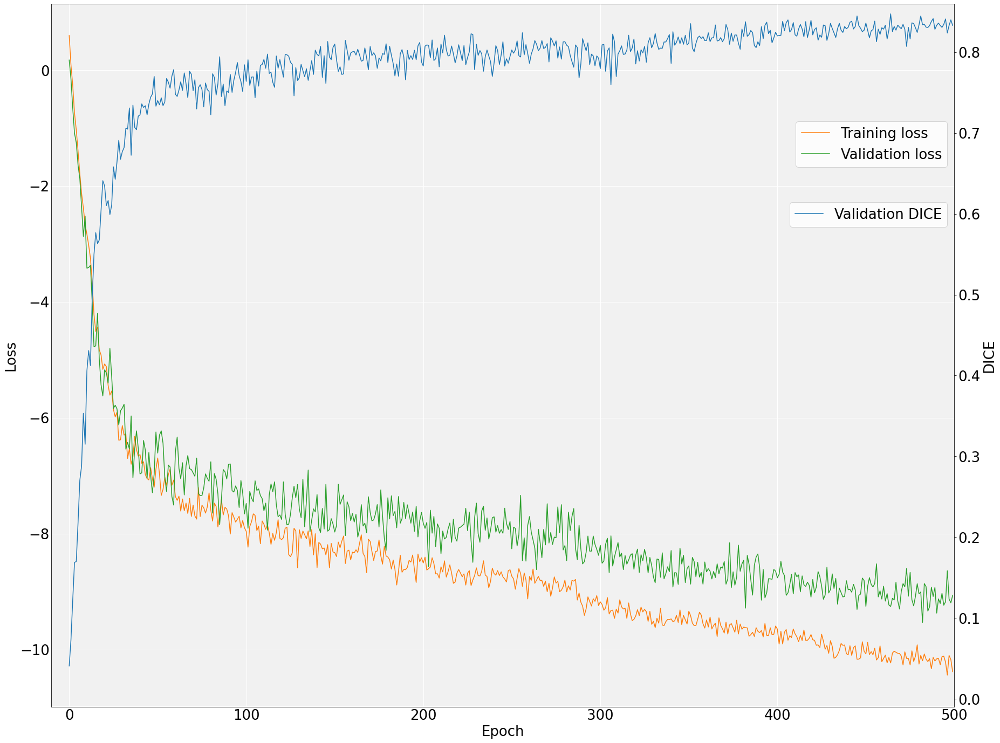

In [45]:
task = con.TASK_526
config = con.CONFIG_FULL
trainer = con.CLASSIC
fold = 0
labels = [1]

# bigger font size
plt.rcParams.update({'font.size': 26})

# load debug file for fold
debug = open(os.path.join(thesis_path, "Results", str(task), config, trainer, f"fold_{fold}_dir", "debug.json"))
debug = json.load(debug)

# load metrics
tr_losses = mana.convert_string_array_to_list(debug["all_tr_losses"])
val_losses = mana.convert_string_array_to_list(debug["all_val_losses"])
val_metrics = mana.convert_string_array_to_list(debug["all_val_eval_metrics"])
epochs = range(0,len(tr_losses))

# plot
fig, ax, ax2 = mana.get_plot_layout(True)
ax2.plot(epochs, val_metrics, label="Validation DICE", c="C0", ls='-')
ax.plot(epochs, tr_losses, label="Training loss", c="C1", ls='-')
ax.plot(epochs, val_losses, label="Validation loss", c="C2", ls='-')
ax.set_xlabel("Epoch")
ax.set_ylabel("Loss")
ax2.set_ylabel("DICE")

# Set axis ranges for DICE
ax.set_xlim(-10,500) # x-axis range
ax2.set_ylim(-0.01, 0.86)
        
# Make legend and position it
ax.legend(loc=7, bbox_to_anchor=(1, 0.8))
ax2.legend(loc=7, bbox_to_anchor=(1, 0.7))

# Save
plt.savefig(f"{figures_path}/{task}/convergence_fullsize_single_fold_{task}_{config}_{trainer}_{fold}", dpi=200, figsize=(8,5), bbox_inches='tight')
plt.show()
        
# Default font size
plt.rcParams.update({'font.size': 10})

Then we create boxplots visualising the inter-folds stability of various metrics.

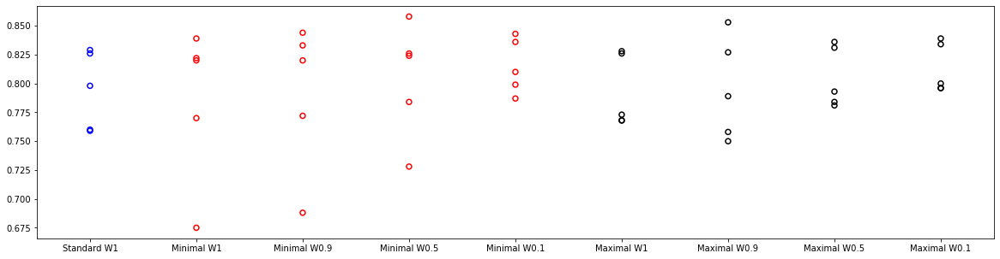

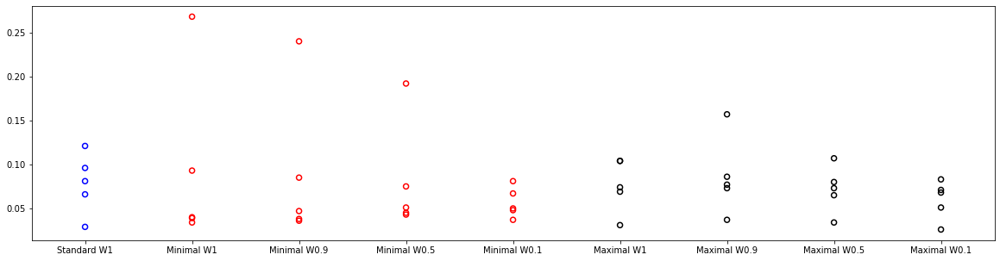

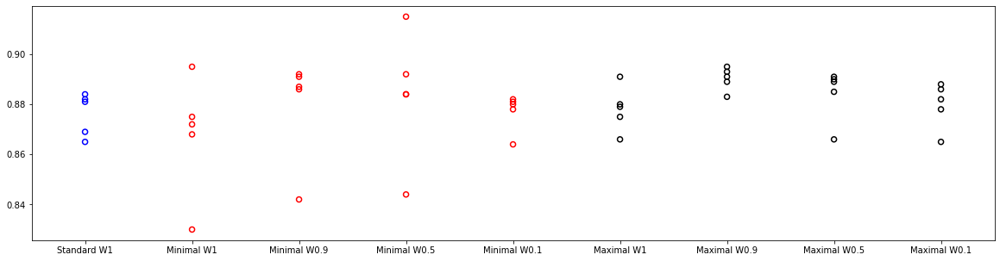

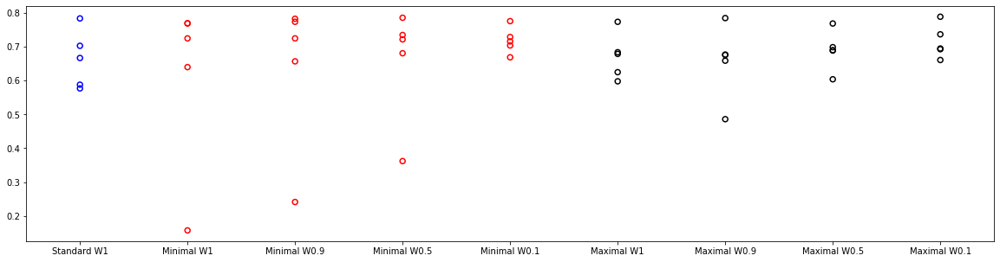

In [29]:
tasks = [con.TASK_525, con.TASK_526, con.TASK_527]
config = con.CONFIG_FULL
metrics = ["Mean", "Std", "Max", "Min"]
names = {"W1" : con.CLASSIC,
        "W0.9" : con.WEIGHT09,
        "W0.5" : con.WEIGHT05,
        "W0.1" : con.WEIGHT01}
name_mapping = {con.TASK_525: "Standard",
                con.TASK_526 : "Minimal",
                con.TASK_527 : "Maximal"}

# Make 1 box-plot per metric 
for met in metrics:

    # Matplotlib figure
    fig, ax = plt.subplots(figsize=(20, 5))
    data_dict = {}

    # Gather data from each task (and config)
    for task in tasks:
        for name, trainer in names.items():
            # Task 525 = task with single organ, so it only has classic and no weighted loss
            if task == con.TASK_525 and trainer != con.CLASSIC:
                continue
            task_path = f"{results_path}\\{task}"
            df = pd.read_csv(os.path.join(task_path, f'singlefolds_{config}_{trainer}.csv'), delimiter=";")
            name_string = name_mapping[task] + " " + name
            data_dict[name_string] = df[met] # Example: "Minimal W0.1 = 10"

    # Plot
    ax.boxplot(data_dict.values(), whis=0, showmeans=False, showbox=False, showcaps=False, showfliers = False, medianprops={"linewidth" : "0"})#, flierprops = props, capprops = props)
    
    # Update colors depending on the task
    for i, x in enumerate(data_dict.keys()):
        if x.startswith('Standard'):
            color = "blue"
        elif x.startswith('Minimal'):
            color = "red"
        else:
            color = "black"
        ax.scatter([i+1 for _ in data_dict[x]], data_dict[x], marker=MarkerStyle("o", fillstyle="none"), c=color)
    
    # Set x-axis labels
    ax.set_xticklabels(data_dict.keys())
    
    # ax.set_xlim(0, 0.01)

    # Save
    plt.savefig(f"{figures_path}\\{task}\\PRESENTATIE_boxplot_interfolds_alltasks_alltrainers_{met}.png", dpi=200, bbox_inches='tight')

Experiment 3 - qualitative analysis

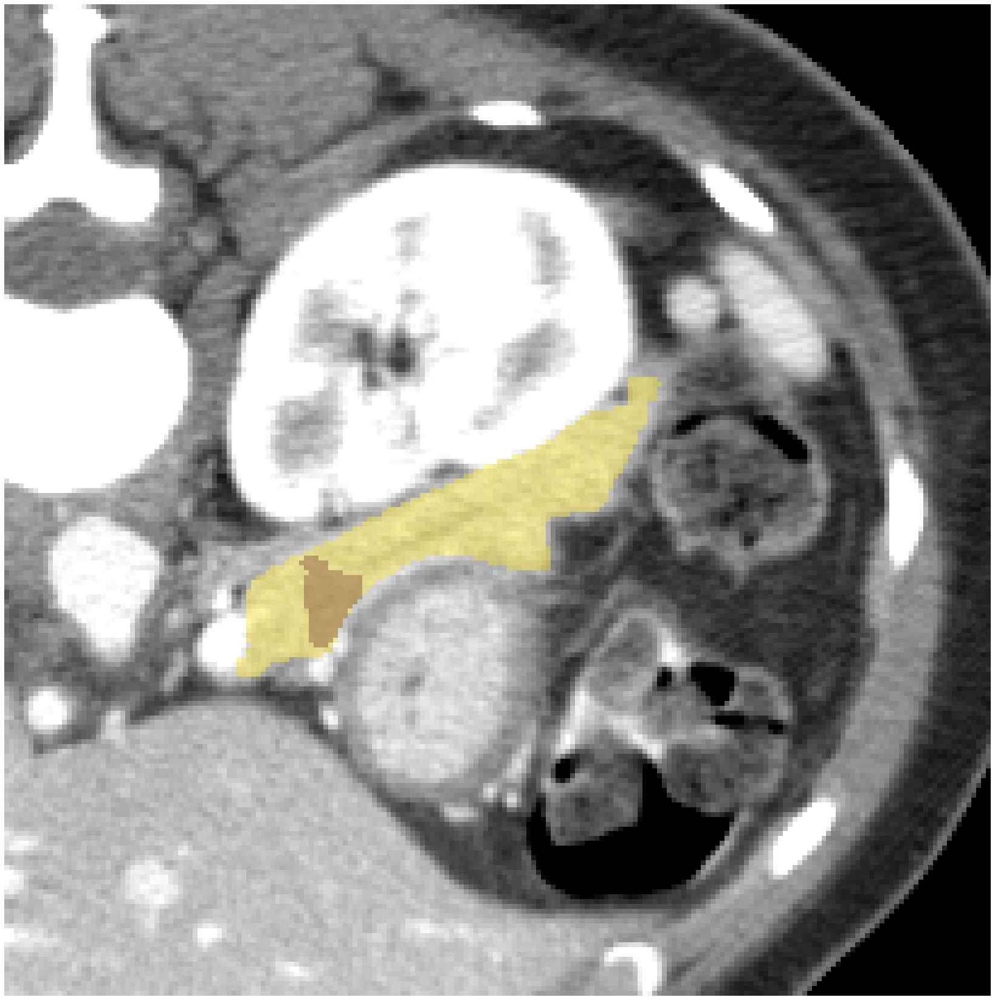

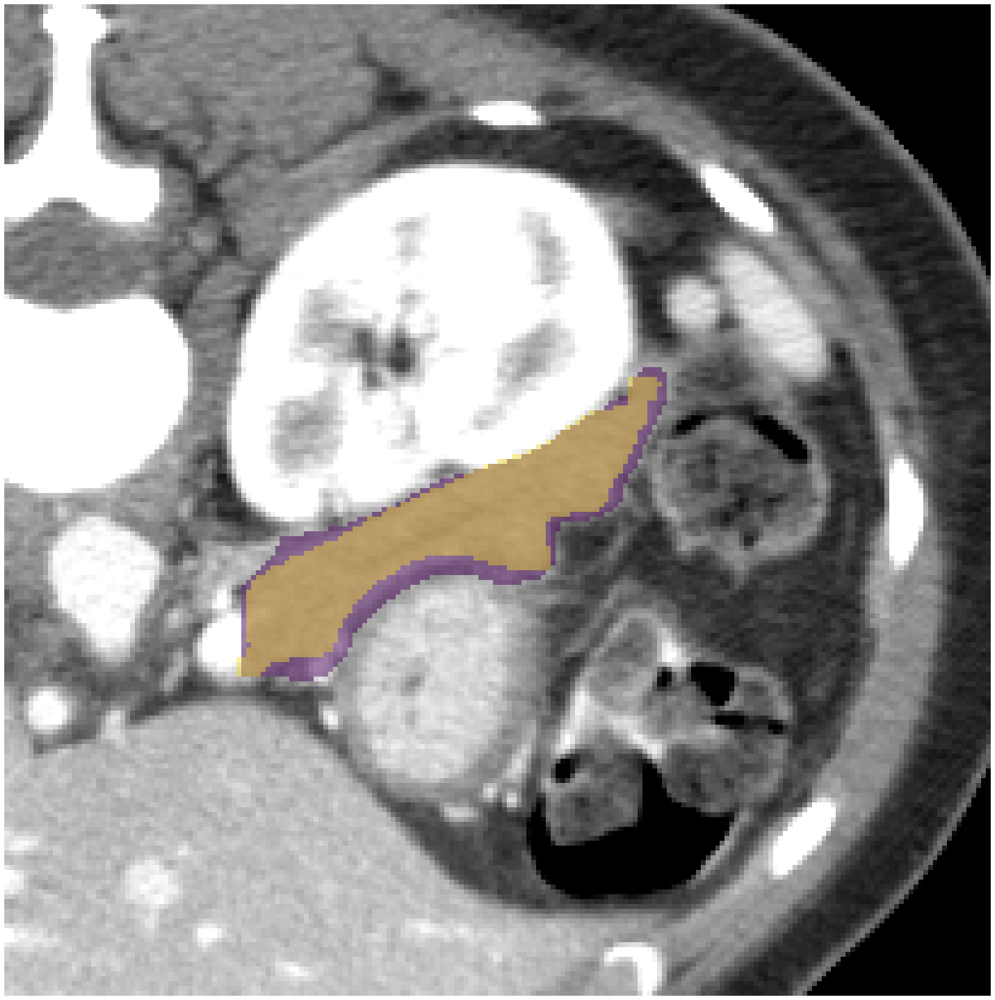

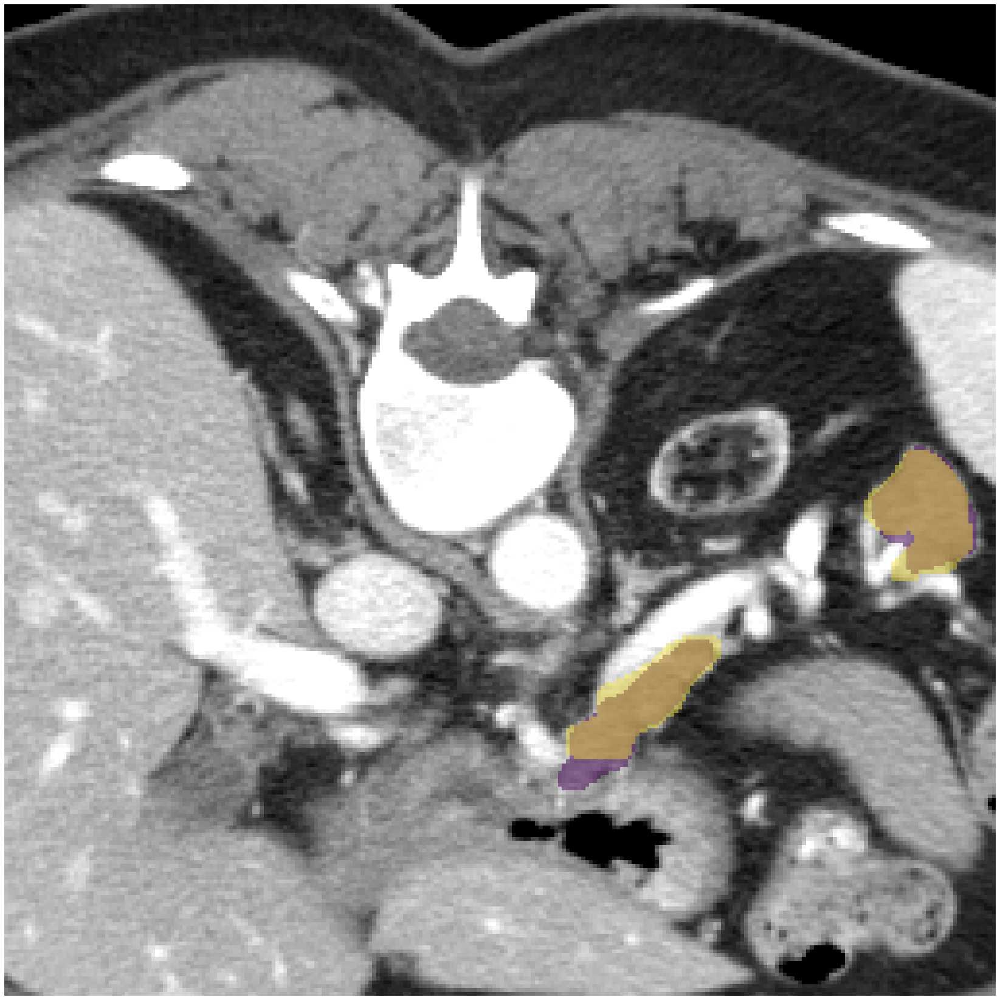

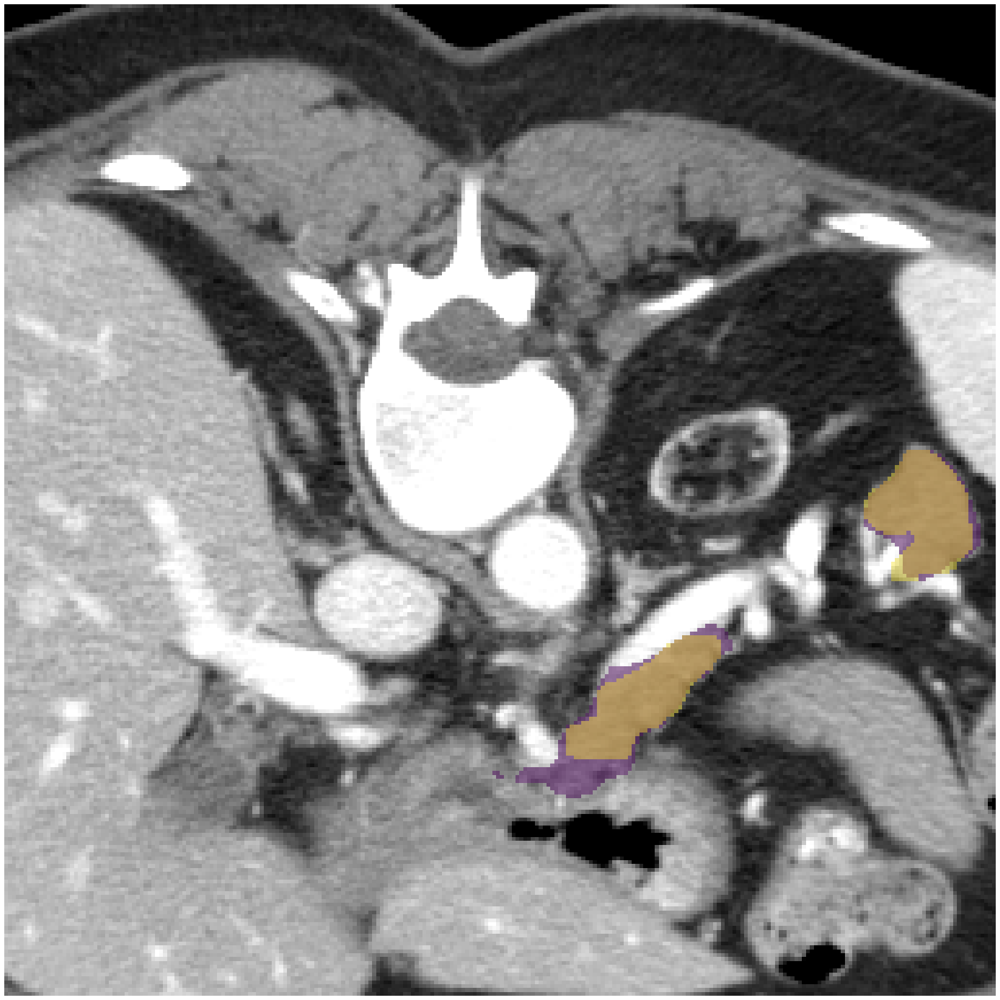

In [11]:
config = con.CONFIG_FULL
figure = "results_exp3_qualitative"

# BAD
task = con.TASK_525
trainer = con.CLASSIC
data_path, img_path, segmentation_path, label_path = get_paths(task, config, con.TEST, trainer)
create_2d(0, 101, img_path, label_path, modality, segmentation_path, f'{figure}_{task}_{trainer}', TRANSPOSE, showSeg=True, zoom=True, zoom_x_min=0.1, zoom_x_max=0.5, zoom_y_min=0.5, zoom_y_max=0.9)

task = con.TASK_526
trainer = con.WEIGHT01
data_path, img_path, segmentation_path, label_path = get_paths(task, config, con.TEST, trainer)
create_2d(0, 101, img_path, label_path, modality, segmentation_path, f'{figure}_{task}_{trainer}', TRANSPOSE, showSeg=True, zoom=True, zoom_x_min=0.1, zoom_x_max=0.5, zoom_y_min=0.5, zoom_y_max=0.9)

# GOOD
task = con.TASK_525
trainer = con.CLASSIC
data_path, img_path, segmentation_path, label_path = get_paths(task, config, con.TEST, trainer)
create_2d(1, 114, img_path, label_path, modality, segmentation_path, f'{figure}_{task}_{trainer}_2', TRANSPOSE, showSeg=True, zoom=True)#, zoom_x_min=0.1, zoom_x_max=0.5, zoom_y_min=0.5, zoom_y_max=0.9)

task = con.TASK_526
trainer = con.WEIGHT01
data_path, img_path, segmentation_path, label_path = get_paths(task, config, con.TEST, trainer)
create_2d(1, 114, img_path, label_path, modality, segmentation_path, f'{figure}_{task}_{trainer}_2', TRANSPOSE, showSeg=True, zoom=True)#, zoom_x_min=0.1, zoom_x_max=0.5, zoom_y_min=0.5, zoom_y_max=0.9)



# Experiment 4

First new convergence plot because of axis differences

1


C:\Users\ikke_\AppData\Local\Temp\ipykernel_14496\2215611124.py:43: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "figsize" which is no longer supported as of 3.3 and will become an error in 3.6
  plt.savefig(f"{figures_path}/{task}/convergence_fullsize_single_fold_{task}_{config}_{trainer}_{fold}", dpi=200, figsize=(8,5), bbox_inches='tight')


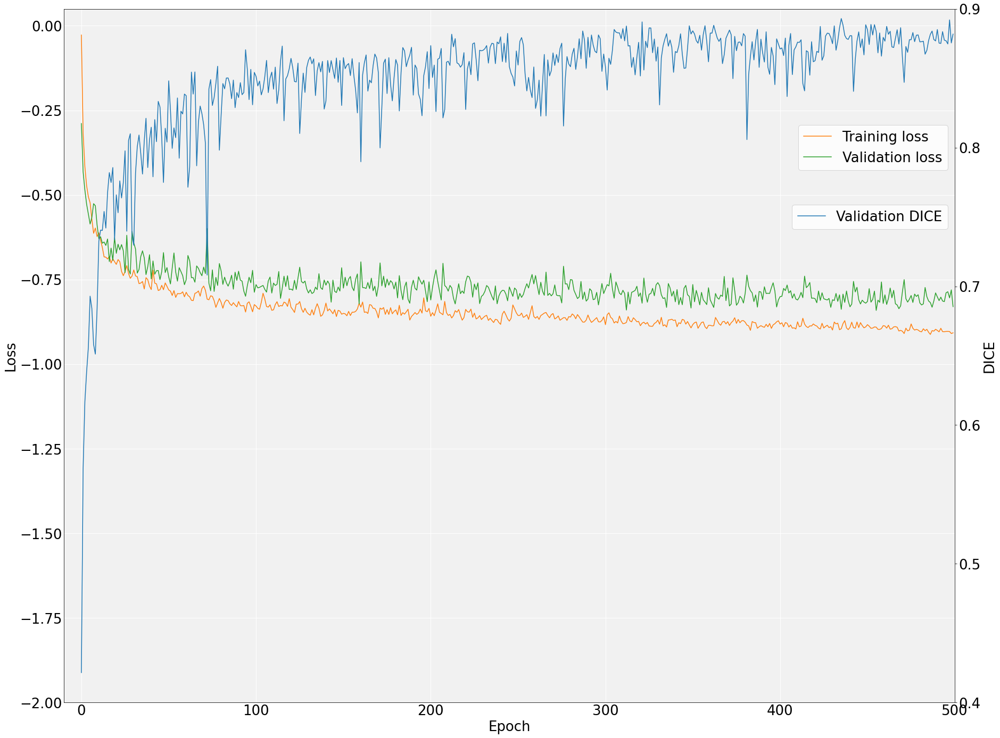

1


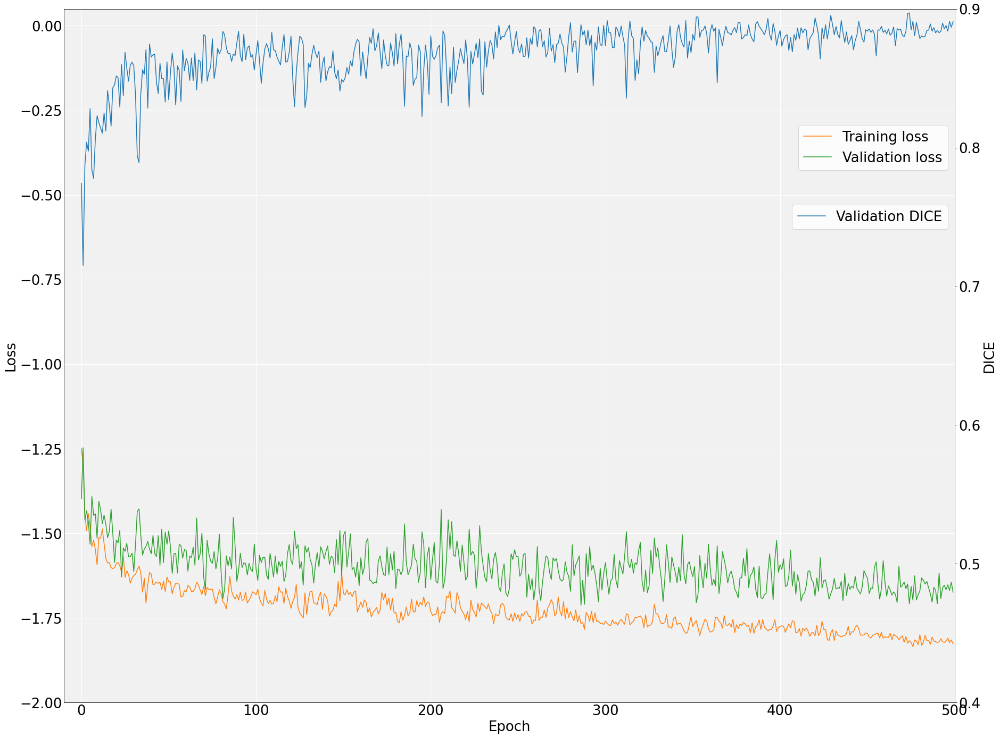

In [44]:
config = con.CONFIG_FULL
trainer = con.CLASSIC
folds = [1]
labels = [1]

# bigger font size
plt.rcParams.update({'font.size': 26})

for task in [con.TASK_600, con.TASK_601]:
    # create convergence plots for each fold 
    for fold in folds:
        print(fold)
        # load debug file for fold
        debug = open(os.path.join(thesis_path, "Results", str(task), config, trainer, f"fold_{fold}_dir", "debug.json"))
        debug = json.load(debug)

        # load metrics
        tr_losses = mana.convert_string_array_to_list(debug["all_tr_losses"])
        val_losses = mana.convert_string_array_to_list(debug["all_val_losses"])
        val_metrics = mana.convert_string_array_to_list(debug["all_val_eval_metrics"])
        epochs = range(0,len(tr_losses))

        # plot
        fig, ax, ax2 = mana.get_plot_layout(True)
        ax2.plot(epochs, val_metrics, label="Validation DICE", c="C0", ls='-')
        ax.plot(epochs, tr_losses, label="Training loss", c="C1", ls='-')
        ax.plot(epochs, val_losses, label="Validation loss", c="C2", ls='-')
        ax.set_xlabel("Epoch")
        ax.set_xlim(-10,500) # x-axis range
        ax.set_ylim(-1.95,0.1) # y-axis range for LOSS
        ax.set_ylabel("Loss")
        ax2.set_ylabel("DICE")

        # Set y-axis range for DICE
        ax.set_ylim(-2, 0.05)
        ax2.set_ylim(0.4, 0.9)
        
        # Make legend and position it
        ax.legend(loc=7, bbox_to_anchor=(1, 0.8))
        ax2.legend(loc=7, bbox_to_anchor=(1, 0.7))

        # Save
        plt.savefig(f"{figures_path}/{task}/convergence_fullsize_single_fold_{task}_{config}_{trainer}_{fold}", dpi=200, figsize=(8,5), bbox_inches='tight')
        plt.show()
        
# Default font size
plt.rcParams.update({'font.size': 10})

Then we create boxplots visualising inter-folds stability of various metrics

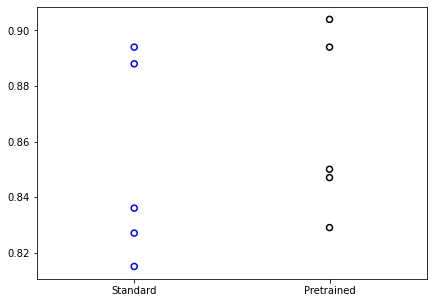

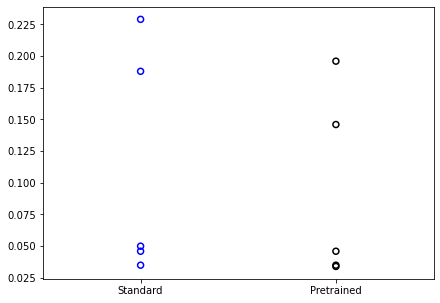

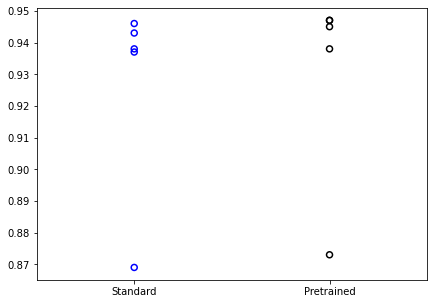

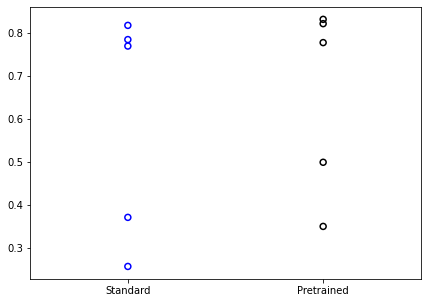

In [13]:
tasks = [con.TASK_600, con.TASK_601]
config = con.CONFIG_FULL
trainer = con.CLASSIC
metrics = ["Mean", "Std", "Max", "Min"]
names = {con.TASK_600 : "Standard",
        con.TASK_601 : "Pretrained"}

# Make 1 boxplot per metric
for met in metrics:

    # Matplotlib figure
    fig, ax = plt.subplots(figsize=(7, 5))
    data_dict = {}

    # Gather data from standard and pretrained tasks
    for task in tasks:
        task_path = f"{results_path}\\{task}"
        df = pd.read_csv(os.path.join(task_path, f'singlefolds_{config}_{trainer}.csv'), delimiter=";")
        data_dict[names[task]] = df[met]

    # Plot
    ax.boxplot(data_dict.values(), whis=0, showmeans=False, showbox=False, showcaps=False, showfliers = False, medianprops={"linewidth" : "0"})#, flierprops = props, capprops = props)
    
    # Update colours
    for i, x in enumerate(data_dict.keys()):
        if x.startswith('St'):
            color = "blue"
        else:
            color = "black"
        ax.scatter([i+1 for _ in data_dict[x]], data_dict[x], marker=MarkerStyle("o", fillstyle="none"), c=color)
    # Set labels
    ax.set_xticklabels(data_dict.keys())

    # Save
    plt.savefig(f"{figures_path}\\{task}\\boxplot_{task}_interfolds_experiment4_{met}.png", dpi=200, bbox_inches='tight')

Experiment 4 - Qualitative

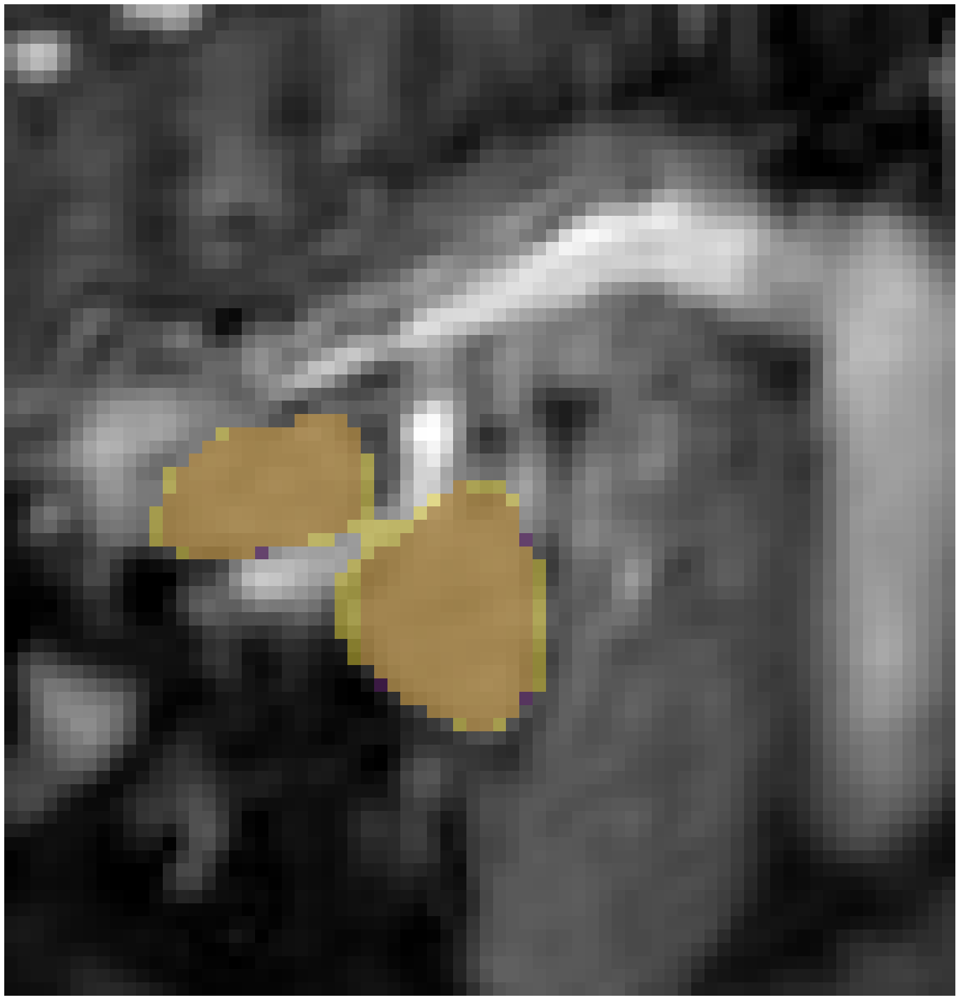

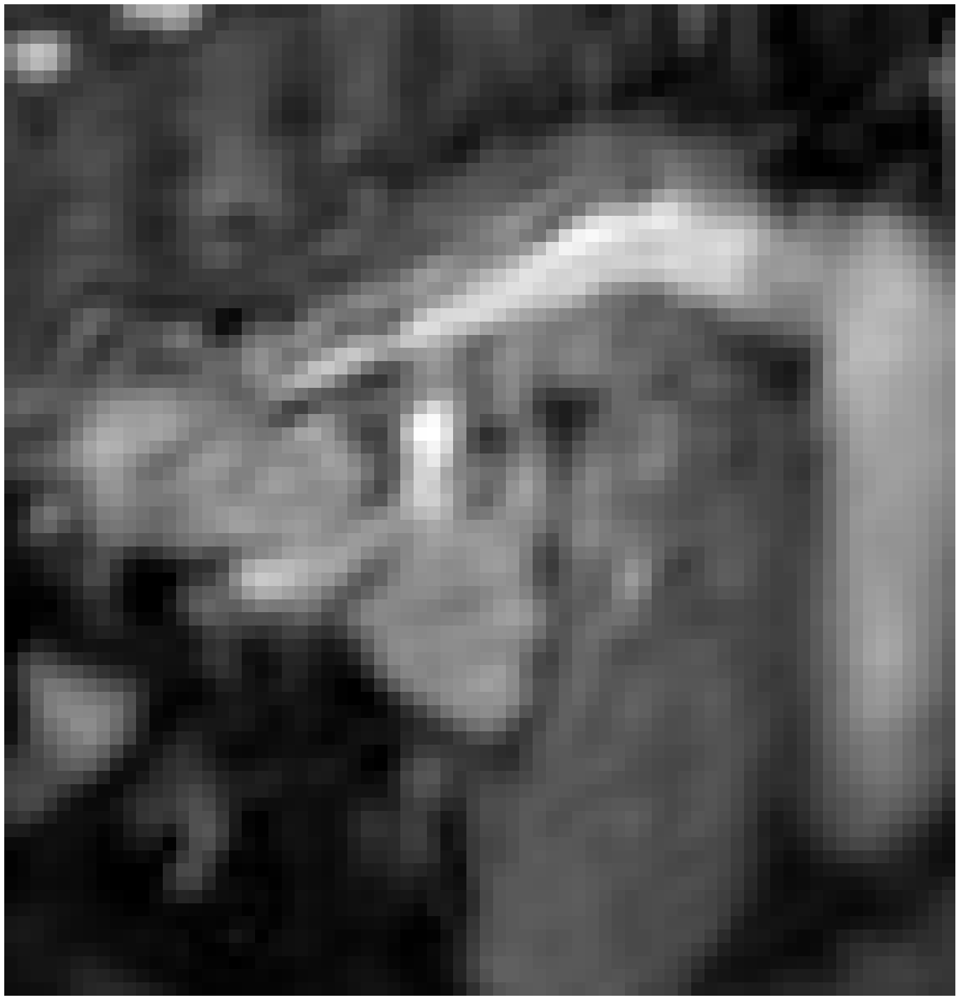

In [14]:
task = con.TASK_600
config = con.CONFIG_FULL
trainer = con.CLASSIC
figure = "results_exp4_qualitative"

# REALLY GOOD (better than ground truth)
data_path, img_path, segmentation_path, label_path = get_paths(task, config, con.TEST, trainer)
create_2d(4, 145, img_path, label_path, modality, segmentation_path, f'{figure}_segmentation', None, showSeg=True, view=SAGITTAL, rescale=False,
            zoom = True, zoom_x_min = 0.4, zoom_x_max=0.72, zoom_y_min = 0, zoom_y_max=1) 


# normal scan
data_path, img_path, segmentation_path, label_path = get_paths(task, config, con.TEST, trainer)
create_2d(4, 145, img_path, label_path, modality, segmentation_path, f'{figure}_gt', None, showLabel=False, showSeg=False, view=SAGITTAL, rescale=False,
            zoom = True, zoom_x_min = 0.4, zoom_x_max=0.72, zoom_y_min = 0, zoom_y_max=1) 


# Experiment 5

First, we create two figures showcasing the benefits of continuos learning.

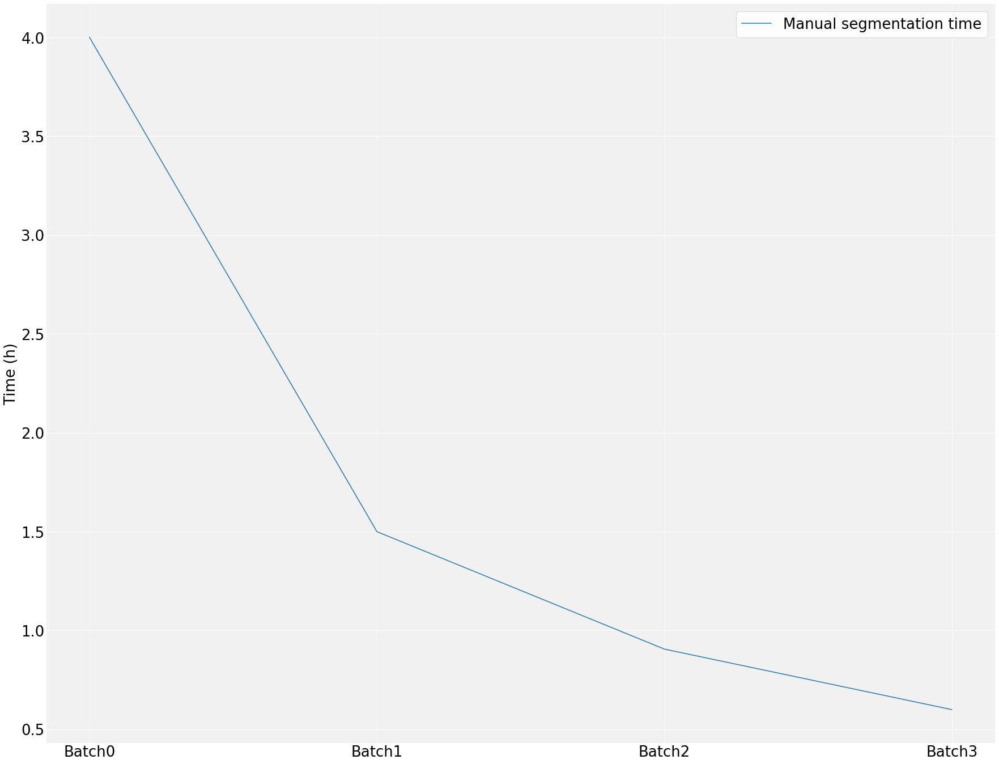

In [30]:
df = pd.read_csv(f"{latex_path}/Experiment5_continuouslearning_time.csv", sep=";",index_col=0).T

# Get matplotlib figure and set bigger font size
plt.rcParams.update({'font.size': 26})
fig, ax = mana.get_plot_layout()

# Define axes
ax.set_ylabel("Time (h)")

# Plot
ax.plot(df.index, df.iloc[:,0], c="C0", label = "Manual segmentation time")

# Make legend and position
ax.legend()

plt.savefig(f"{figures_path}/experiment5_continuous_learning_time.png", dpi=200, bbox_inches='tight')  
plt.rcParams.update({'font.size': 10})

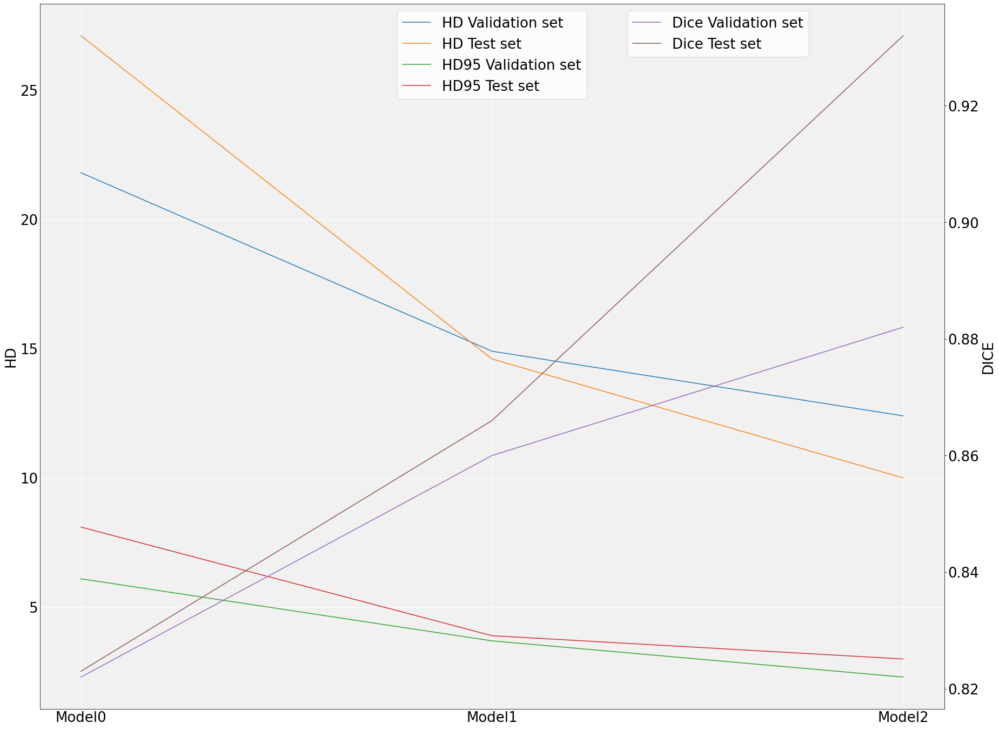

In [26]:
df = pd.read_csv(f"{latex_path}/Experiment5_continuouslearning_performance.csv", sep=";",index_col=0).T

# Get matplotlib figure and set bigger font size
plt.rcParams.update({'font.size': 26})
fig, ax, ax2 = mana.get_plot_layout(True)

# Define axes
ax2.set_ylabel("DICE")
ax.set_ylabel("HD")

# Plot
ax.plot(df.index, df.iloc[:,0], c="C0", label= "HD Validation set")
ax.plot(df.index, df.iloc[:,1], c="C1", label = "HD Test set")
ax.plot(df.index, df.iloc[:,2], c="C2", label= "HD95 Validation set")
ax.plot(df.index, df.iloc[:,3], c="C3", label = "HD95 Test set")
ax2.plot(df.index, df.iloc[:,4], c="C4", label= "Dice Validation set")
ax2.plot(df.index, df.iloc[:,5], c="C5", label= "Dice Test set")

# Make legend and position
ax.legend(loc=9, bbox_to_anchor=(0.5, 1))
ax2.legend(loc=9, bbox_to_anchor=(0.75, 1))

plt.savefig(f"{figures_path}/experiment5_continuous_learning_benefits_performance.png", dpi=200, bbox_inches='tight')  
plt.rcParams.update({'font.size': 10})

First, we create boxplots visualising the inter-folds stability of various metrics of all the models

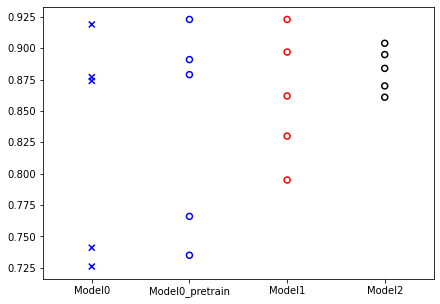

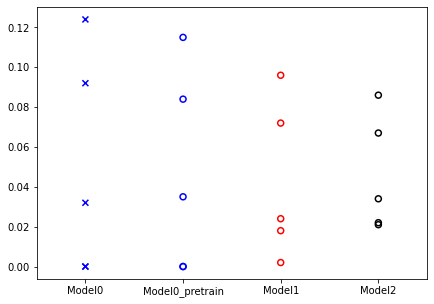

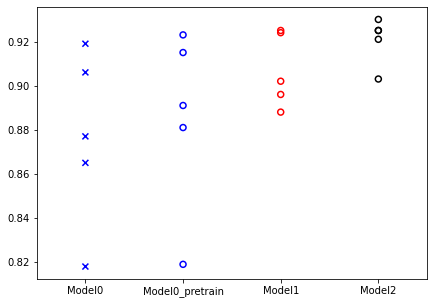

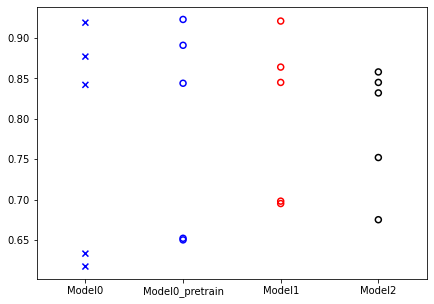

In [17]:
tasks = [con.TASK_610, con.TASK_611, con.TASK_612, con.TASK_613]
config = con.CONFIG_FULL
trainer = con.CLASSIC
metrics = ["Mean", "Std", "Max", "Min"]
names = {con.TASK_610 : "Model0",
        con.TASK_611 : "Model0_pretrain",
        con.TASK_612: "Model1",
        con.TASK_613: "Model2"}

# Make boxplot per metric
for met in metrics:

    # Matplotlib figure
    fig, ax = plt.subplots(figsize=(7, 5))

    # Gather data from all models
    data_dict = {}
    for task in tasks:
        task_path = f"{results_path}\\{task}"
        df = pd.read_csv(os.path.join(task_path, f'singlefolds_{config}_{trainer}.csv'), delimiter=";")
        data_dict[names[task]] = df[met]

    # Plot
    ax.boxplot(data_dict.values(), whis=0, showmeans=False, showbox=False, showcaps=False, showfliers = False, medianprops={"linewidth" : "0"})#, flierprops = props, capprops = props)
    
    # Update colors
    for i, x in enumerate(data_dict.keys()):
        if x == "Model0":
            color = "blue"
            mark = "x"
        elif x == "Model0_pretrain":
            color = "blue"
            mark = "o"
        elif x == "Model1":
            color = "red"
            mark = "o"
        else:
            color = "black"
            mark = "o"
        ax.scatter([i+1 for _ in data_dict[x]], data_dict[x], marker=MarkerStyle(mark, fillstyle="none"), c=color)
    # Set labels on ax
    ax.set_xticklabels(data_dict.keys())

    # Save
    plt.savefig(f"{figures_path}\\{task}\\boxplot_standard_pretrained_batch0_experiment5_{met}.png", dpi=200, bbox_inches='tight')

Experiment 5 - recreate convergence graphs due to different axis ranges and we need to compare it

0


C:\Users\ikke_\AppData\Local\Temp\ipykernel_14496\1927341251.py:47: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "figsize" which is no longer supported as of 3.3 and will become an error in 3.6
  plt.savefig(f"{figures_path}/{task}/convergence_fullsize_single_fold_{task}_{config}_{trainer}_{fold}", dpi=300, figsize=(8,5))


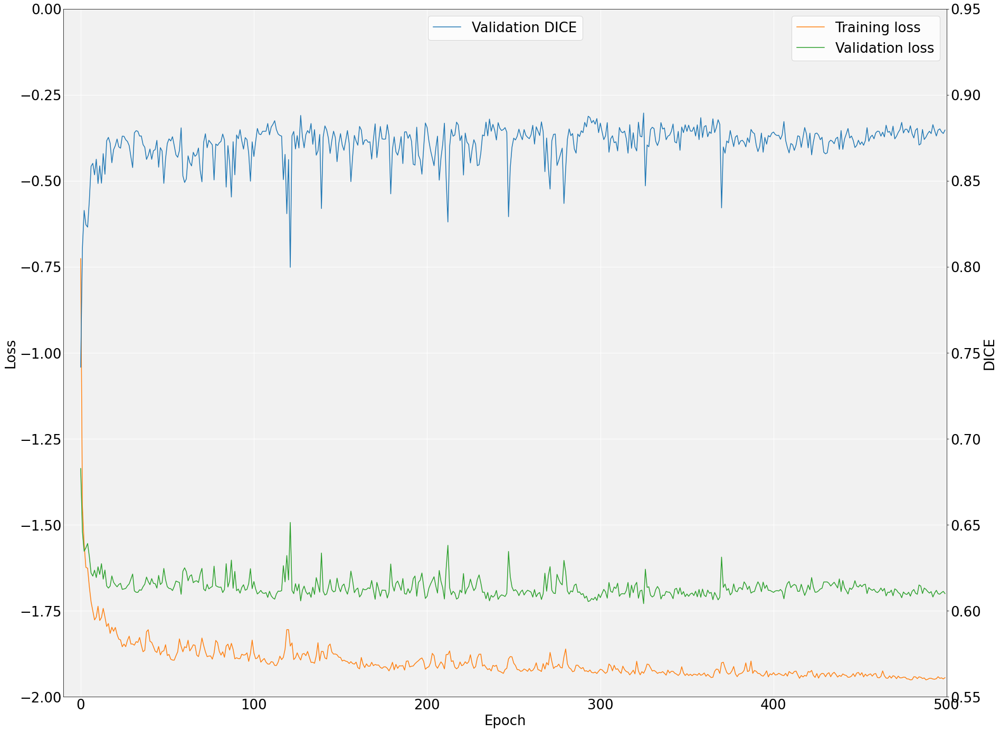

1


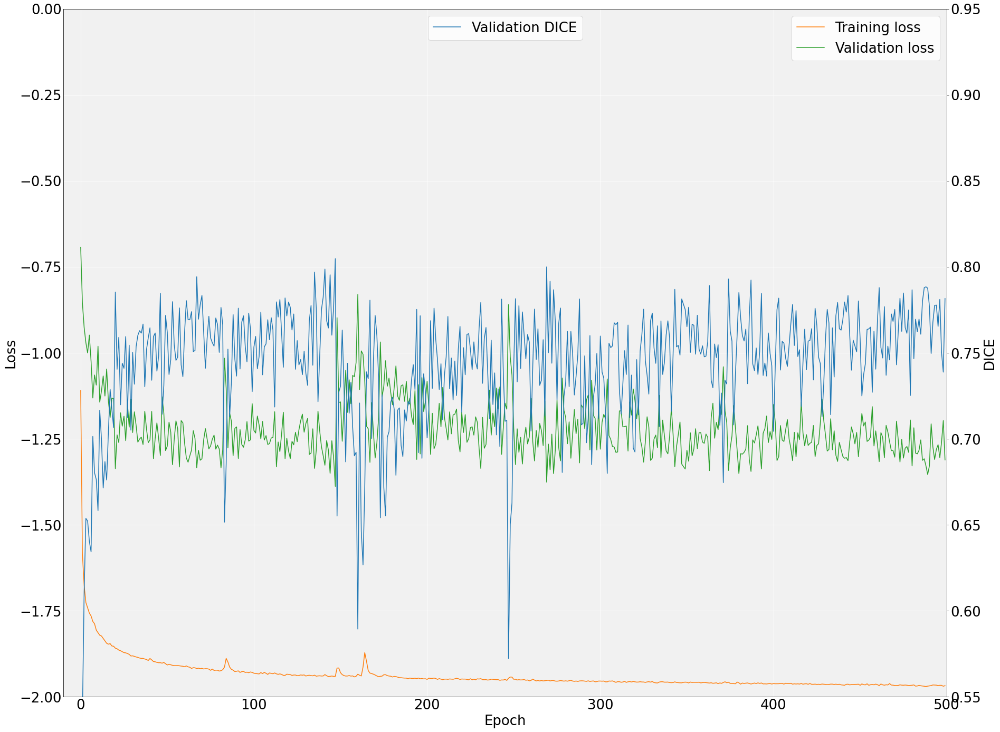

2


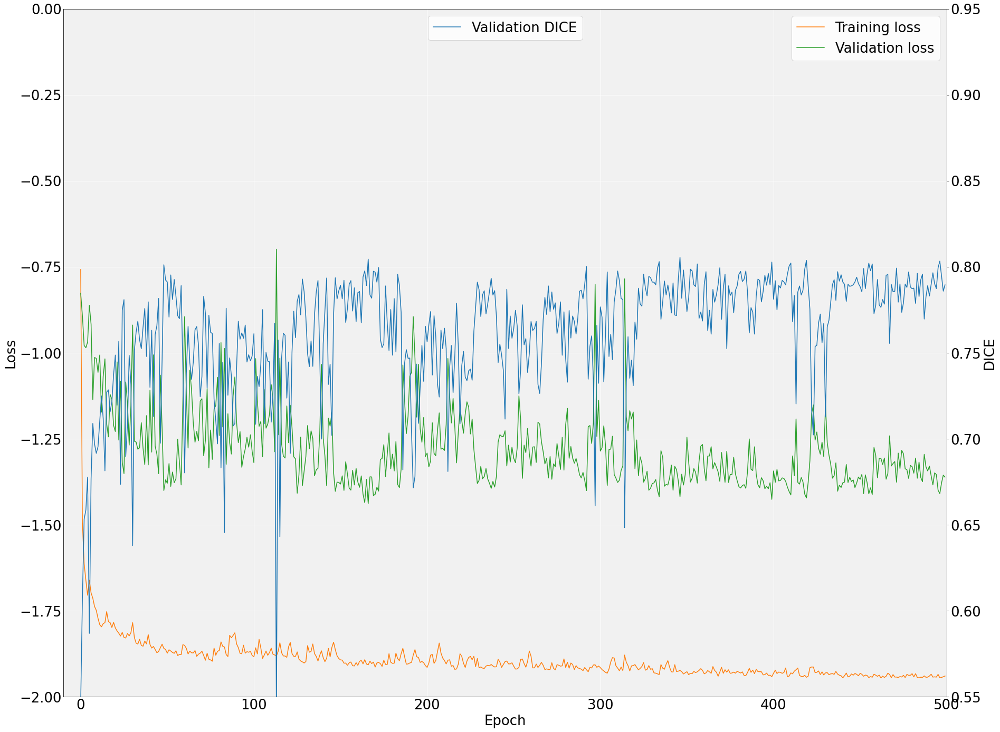

3


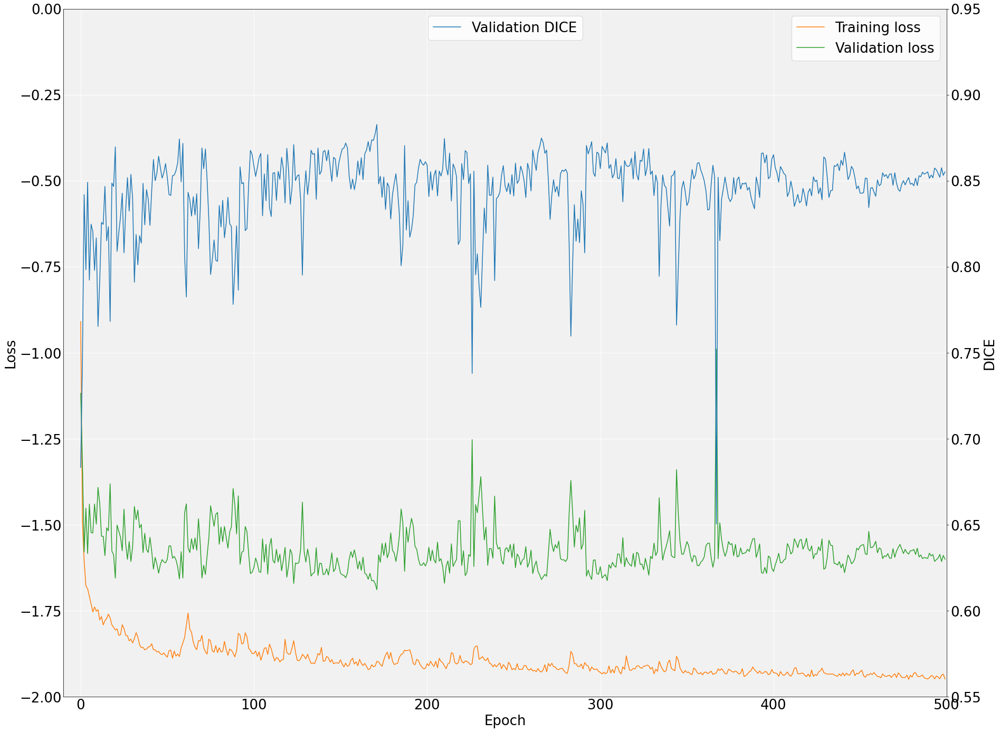

4


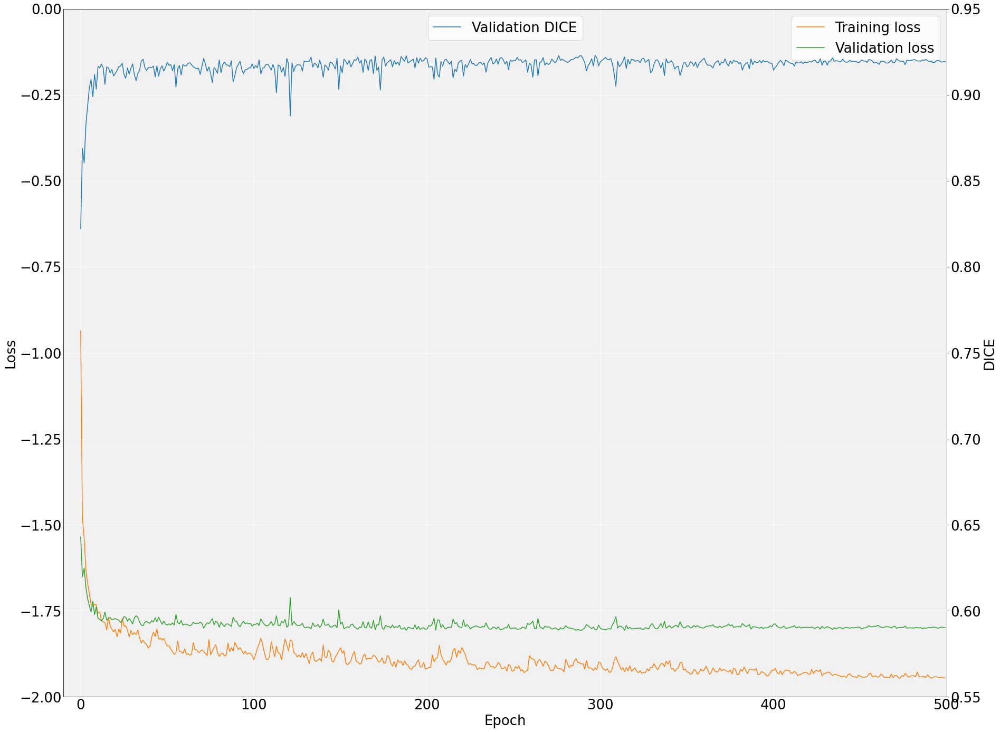

0


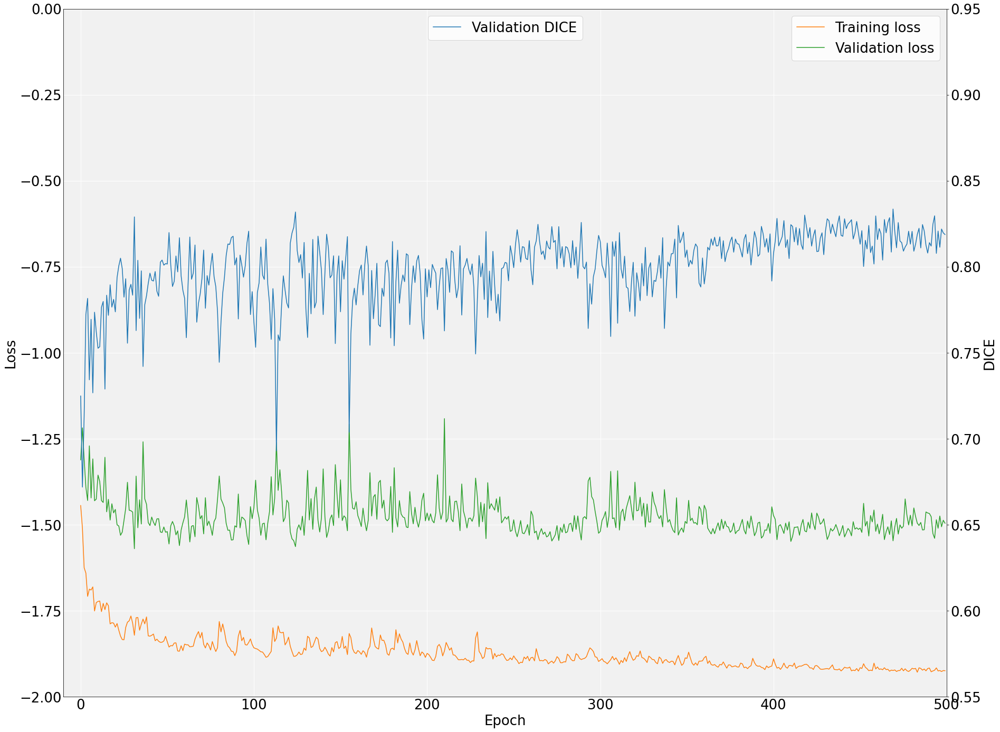

1


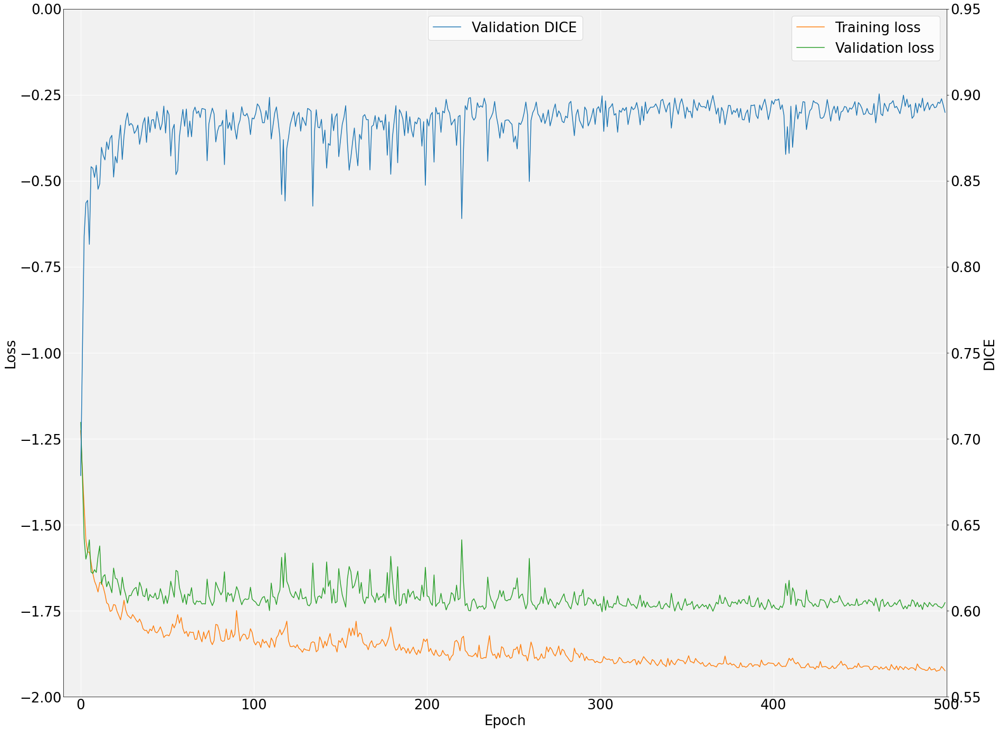

2


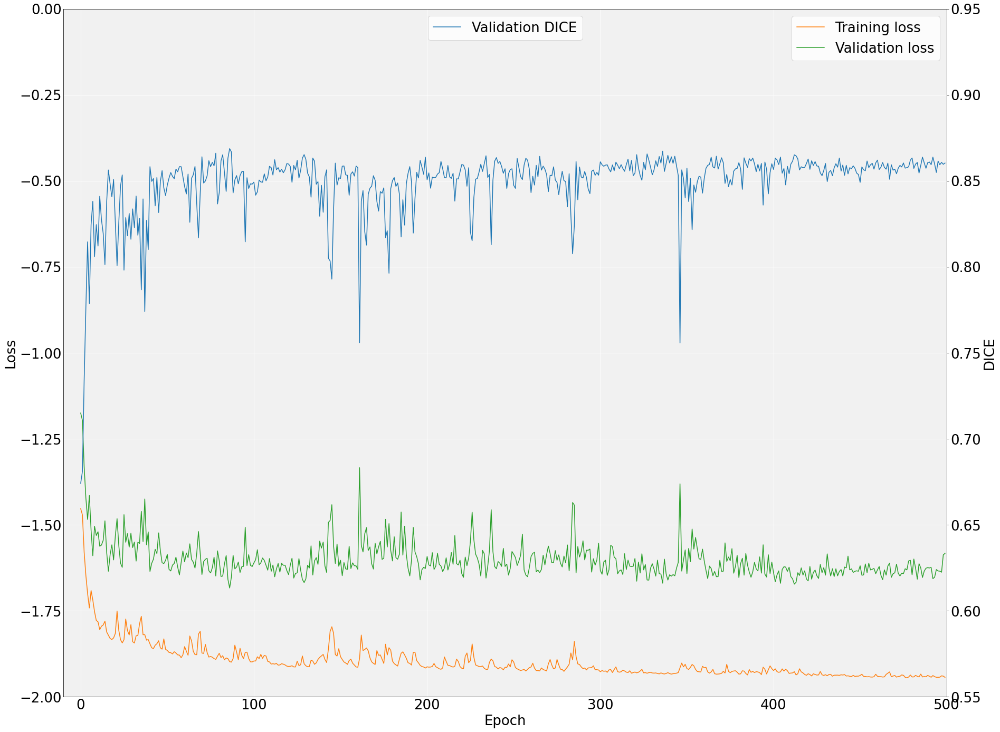

3


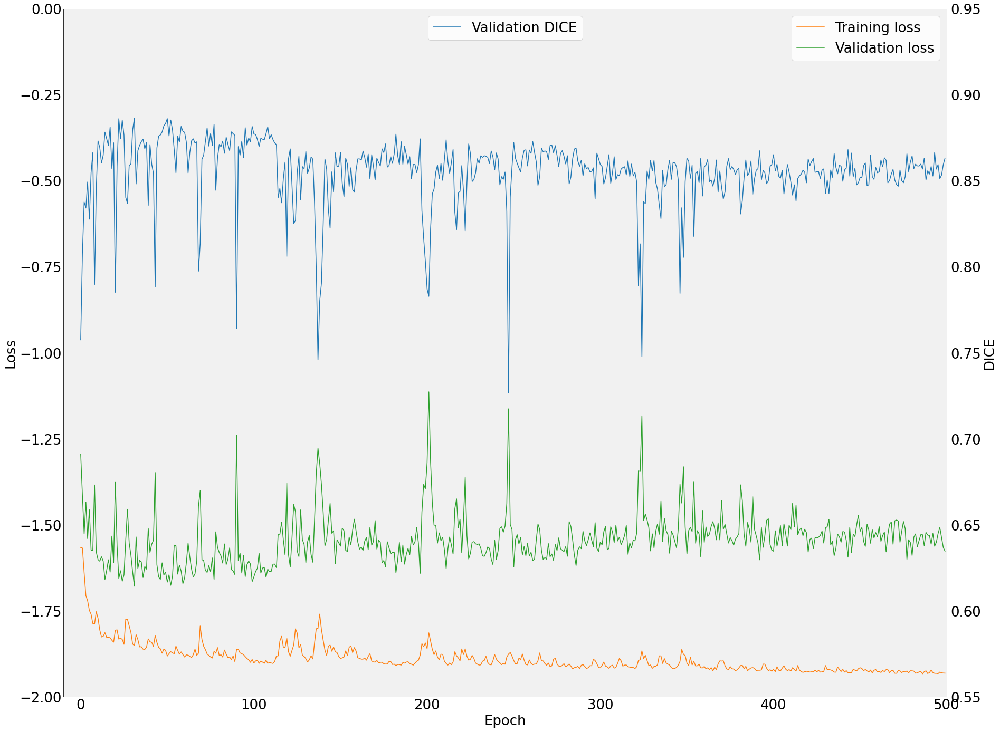

4


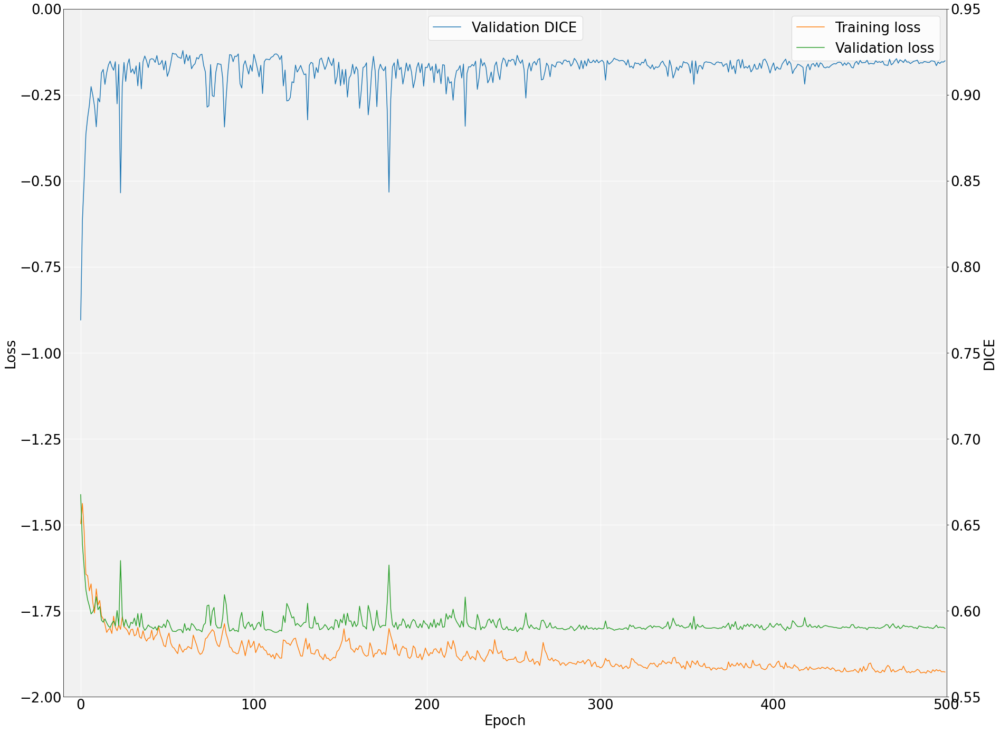

0


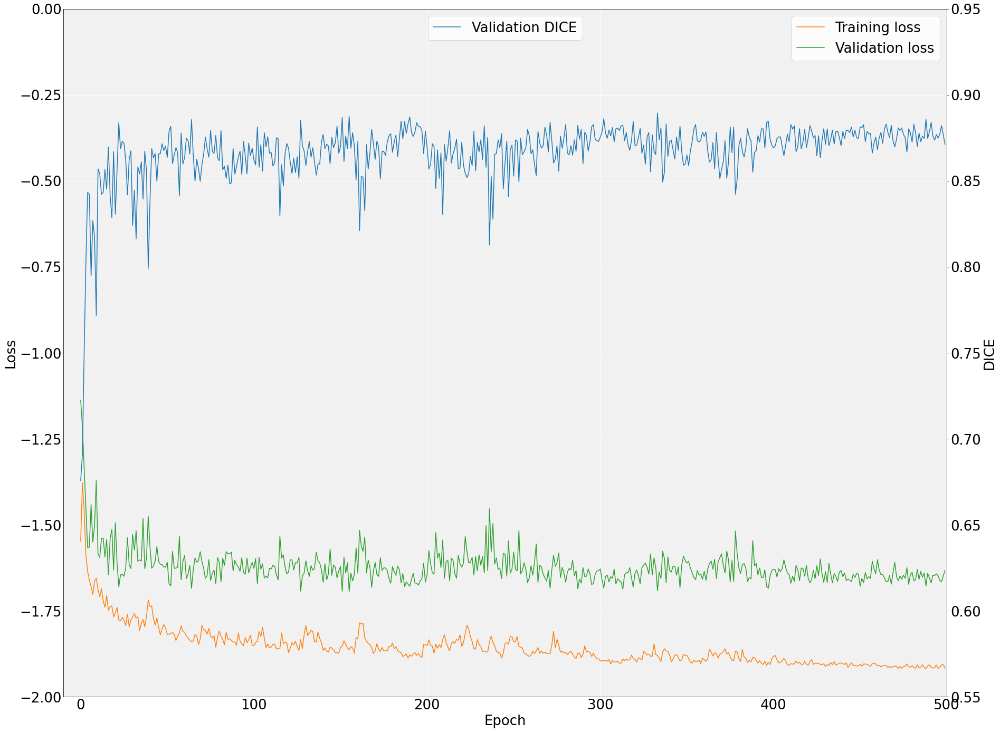

1


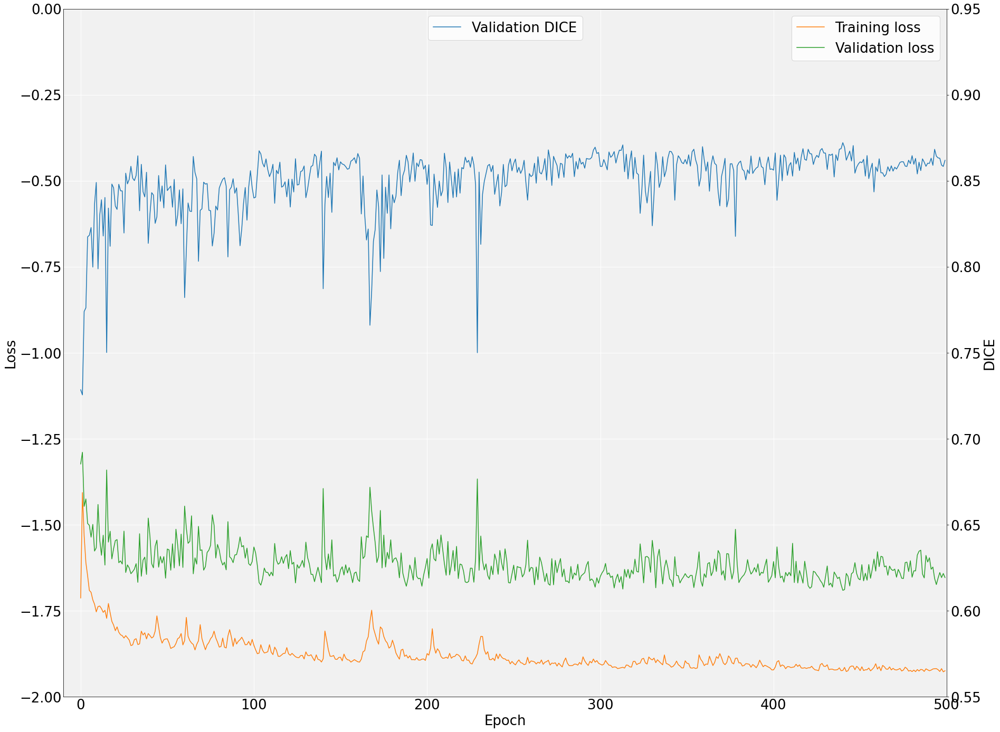

2


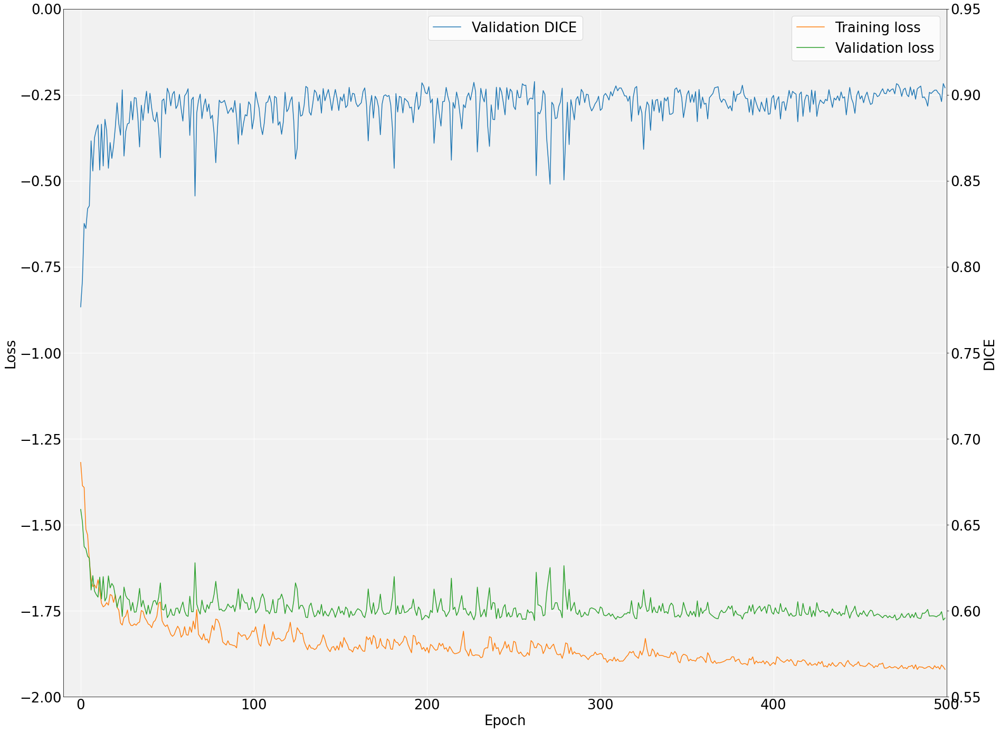

3


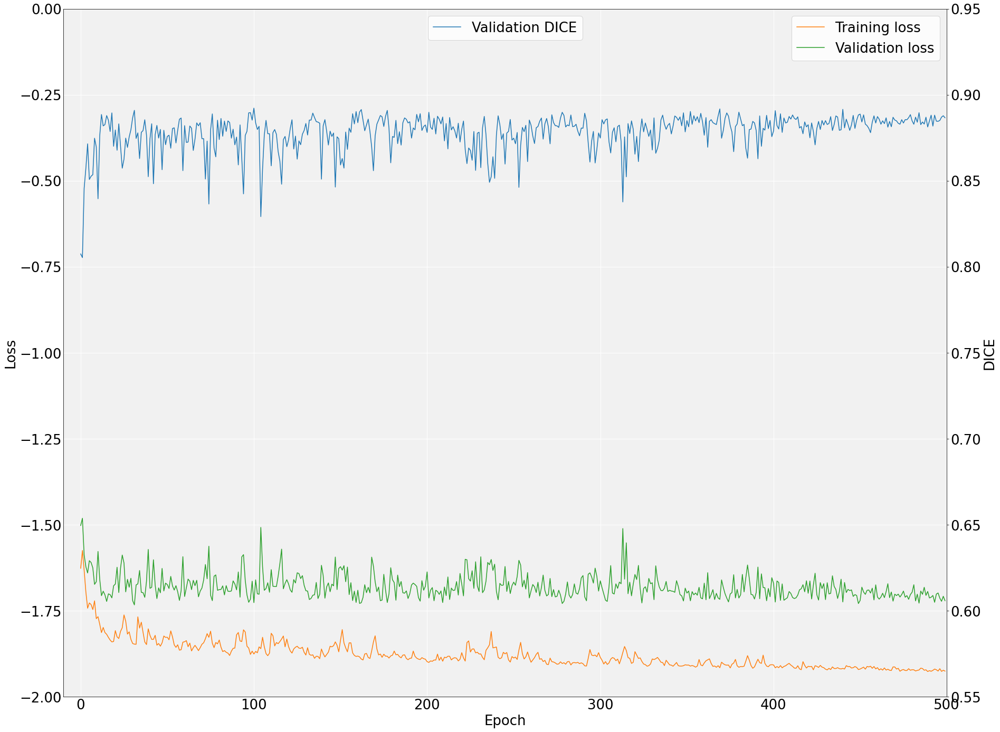

4


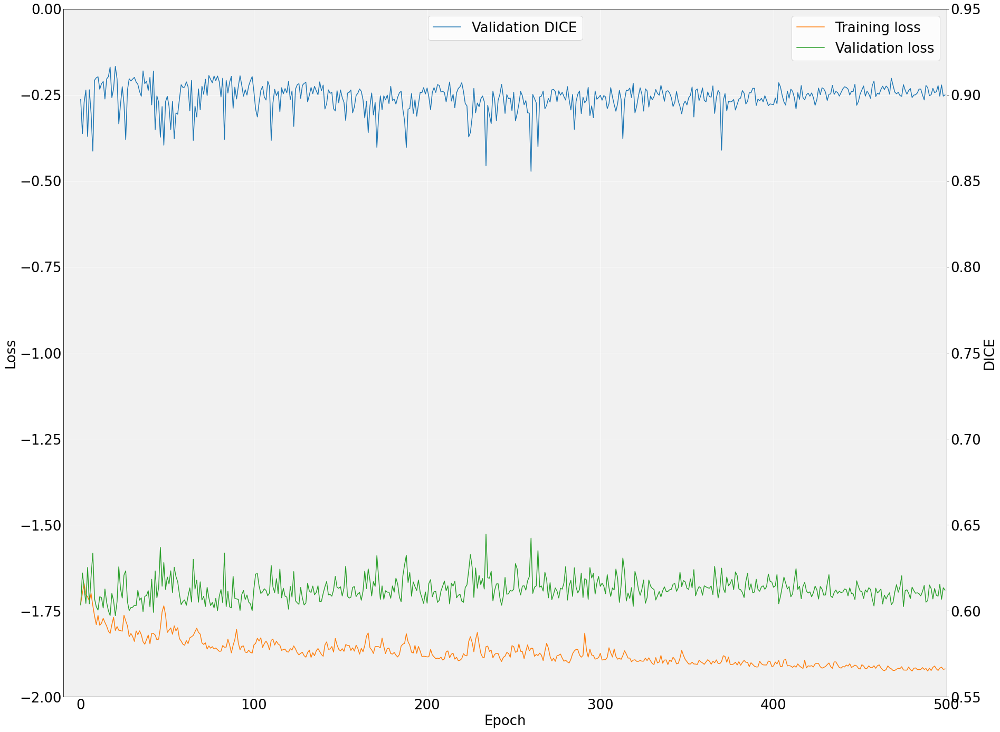

In [18]:
tasks = [con.TASK_611, con.TASK_612, con.TASK_613]
config = con.CONFIG_FULL
trainer = con.CLASSIC
folds = [0,1,2,3,4]
labels = [1]

# Bigger font size
plt.rcParams.update({'font.size': 26})

# Create convergence plots for each fold 
for task in tasks:
    for fold in folds:
        print(fold)
        # Load debug file for fold
        debug = open(os.path.join(thesis_path, "Results", str(task), config, trainer, f"fold_{fold}_dir", "debug.json"))
        debug = json.load(debug)

        # Load metrics
        tr_losses = mana.convert_string_array_to_list(debug["all_tr_losses"])
        val_losses = mana.convert_string_array_to_list(debug["all_val_losses"])
        val_metrics = mana.convert_string_array_to_list(debug["all_val_eval_metrics"])
        epochs = range(0,len(tr_losses))

        # Plot
        fig, ax, ax2 = mana.get_plot_layout(True)
        ax2.plot(epochs, val_metrics, label="Validation DICE", c="C0", ls='-')
        ax.plot(epochs, tr_losses, label="Training loss", c="C1", ls='-')
        ax.plot(epochs, val_losses, label="Validation loss", c="C2", ls='-')

        # X-axis information
        ax.set_xlabel("Epoch")
        ax.set_xlim(-10, 500)

        # Y-axis LOSS information
        ax.set_ylabel("Loss")
        ax.set_ylim(-2, 0)

        # Y-axis DICE information
        ax2.set_ylabel("DICE")
        ax2.set_ylim(0.55, 0.95)

        # Make legend and position it where we want
        ax.legend()
        ax2.legend(loc=9)

        # Save
        plt.savefig(f"{figures_path}/{task}/convergence_fullsize_single_fold_{task}_{config}_{trainer}_{fold}", dpi=300, figsize=(8,5))
        plt.show()
plt.rcParams.update({'font.size': 10})

Experiment 5 - Qualitative analysis batch1

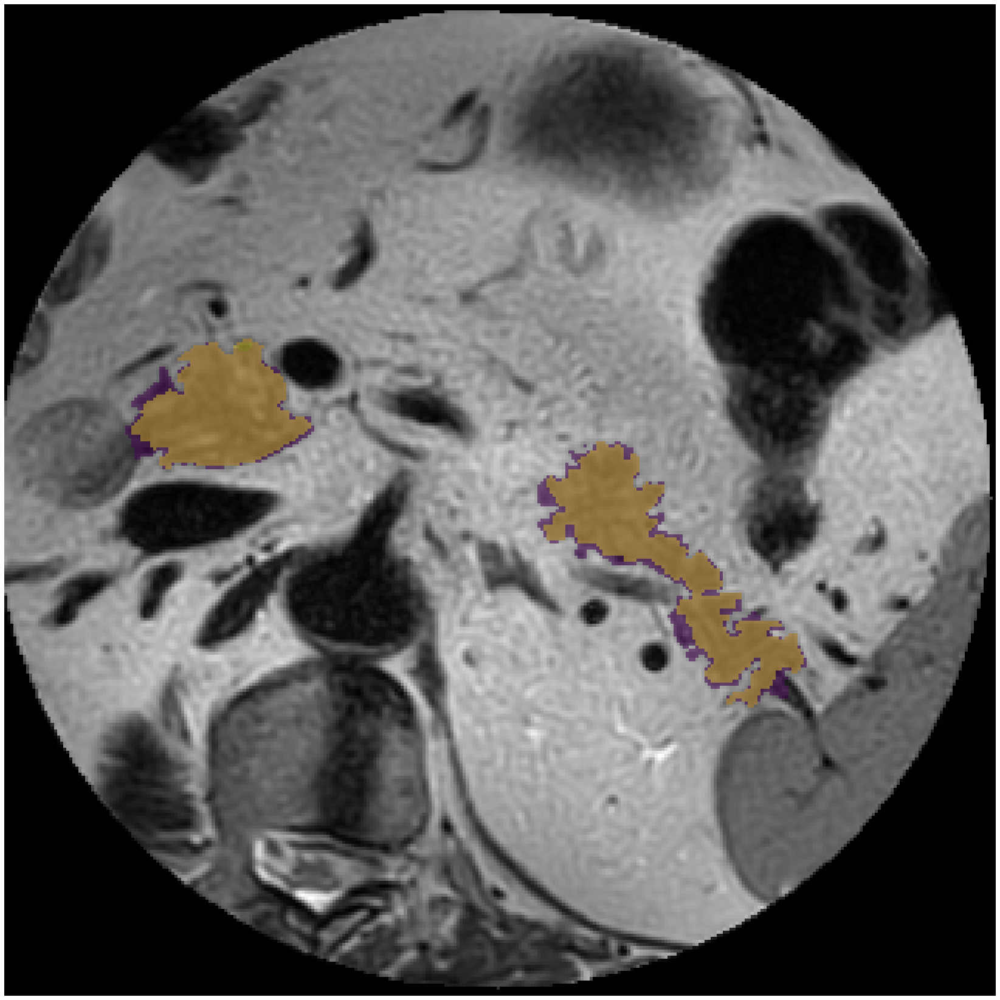

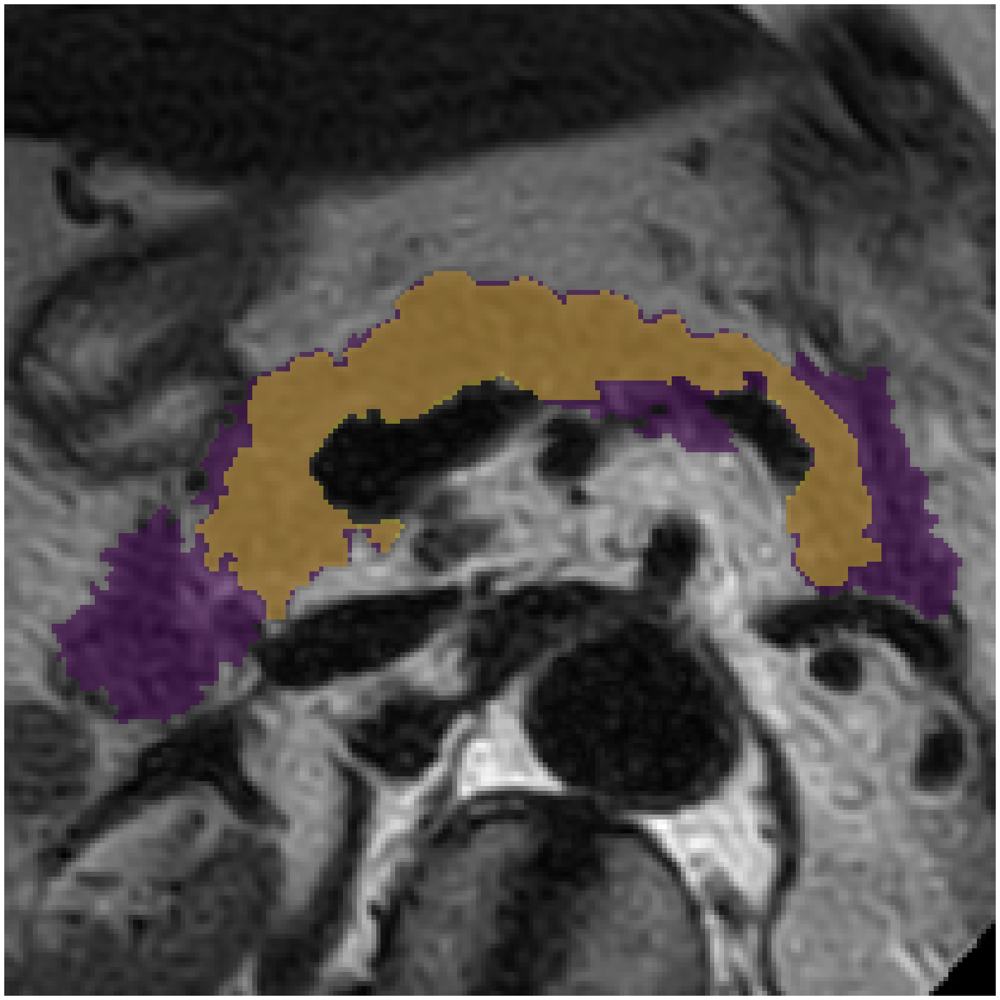

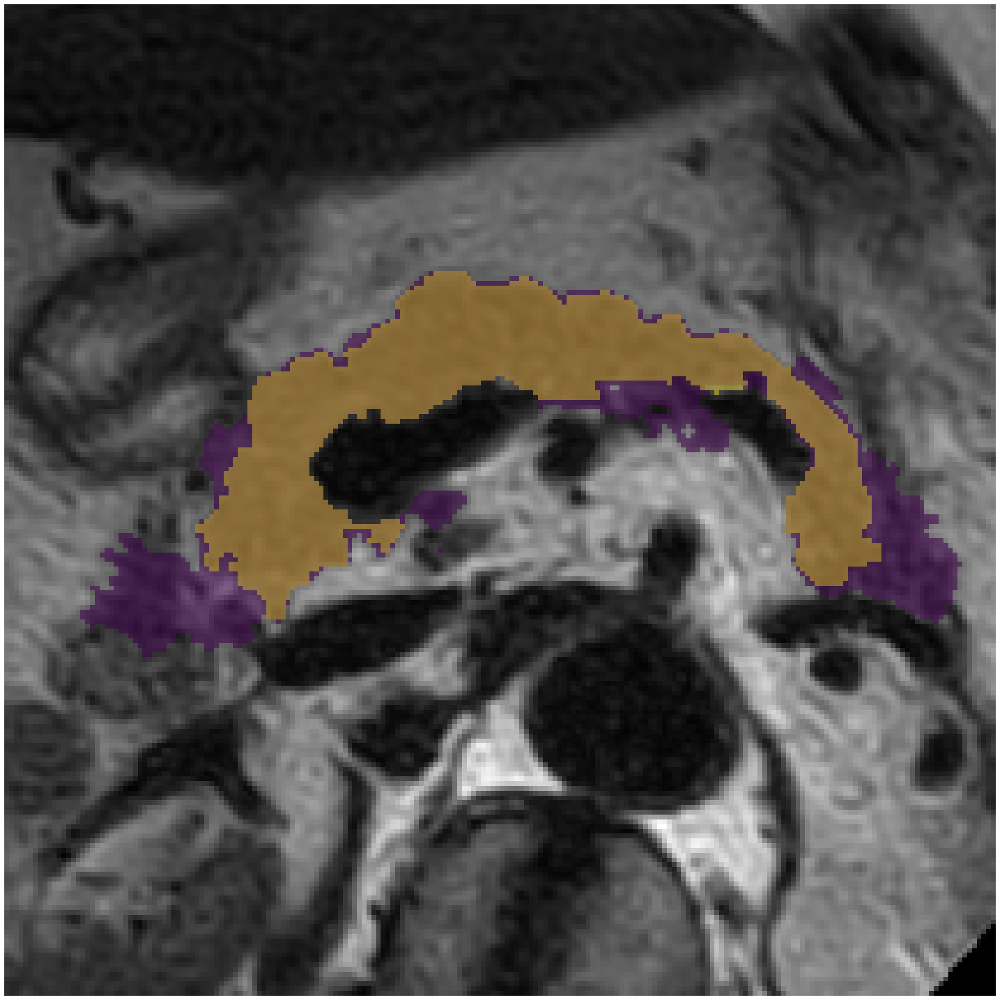

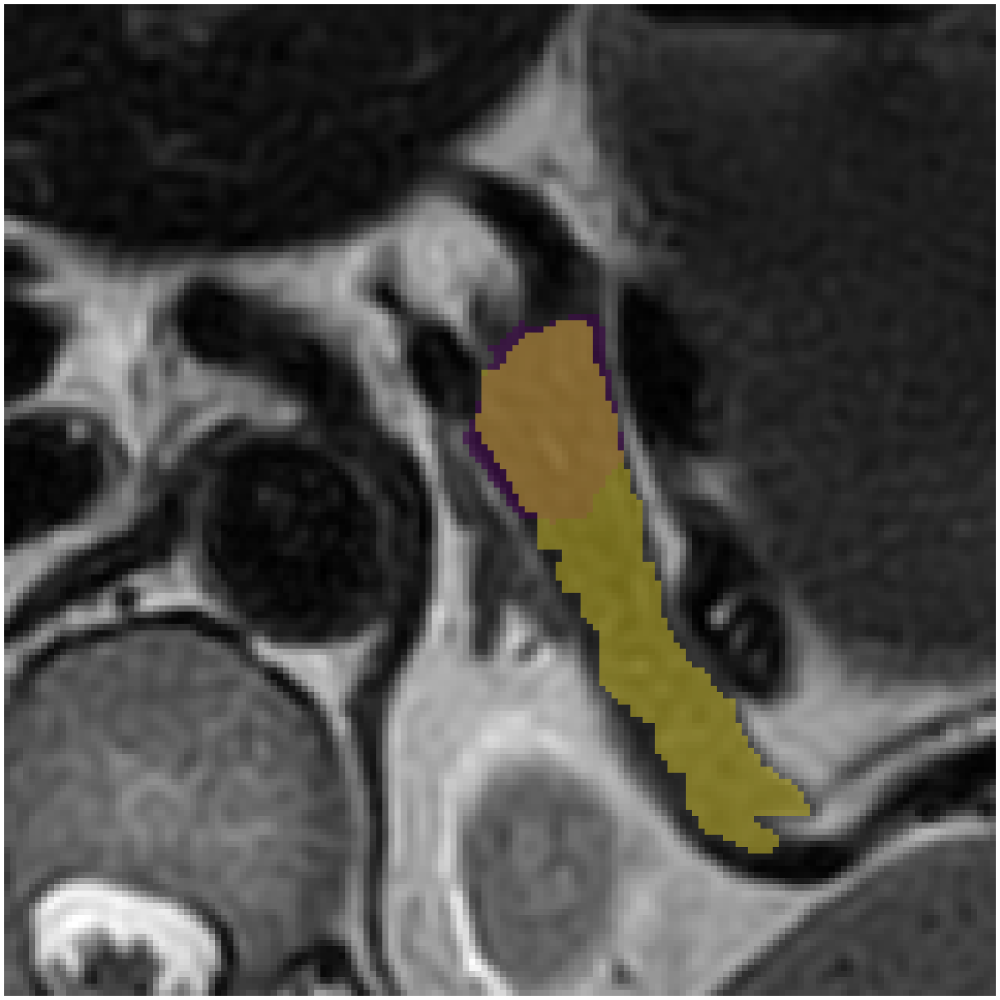

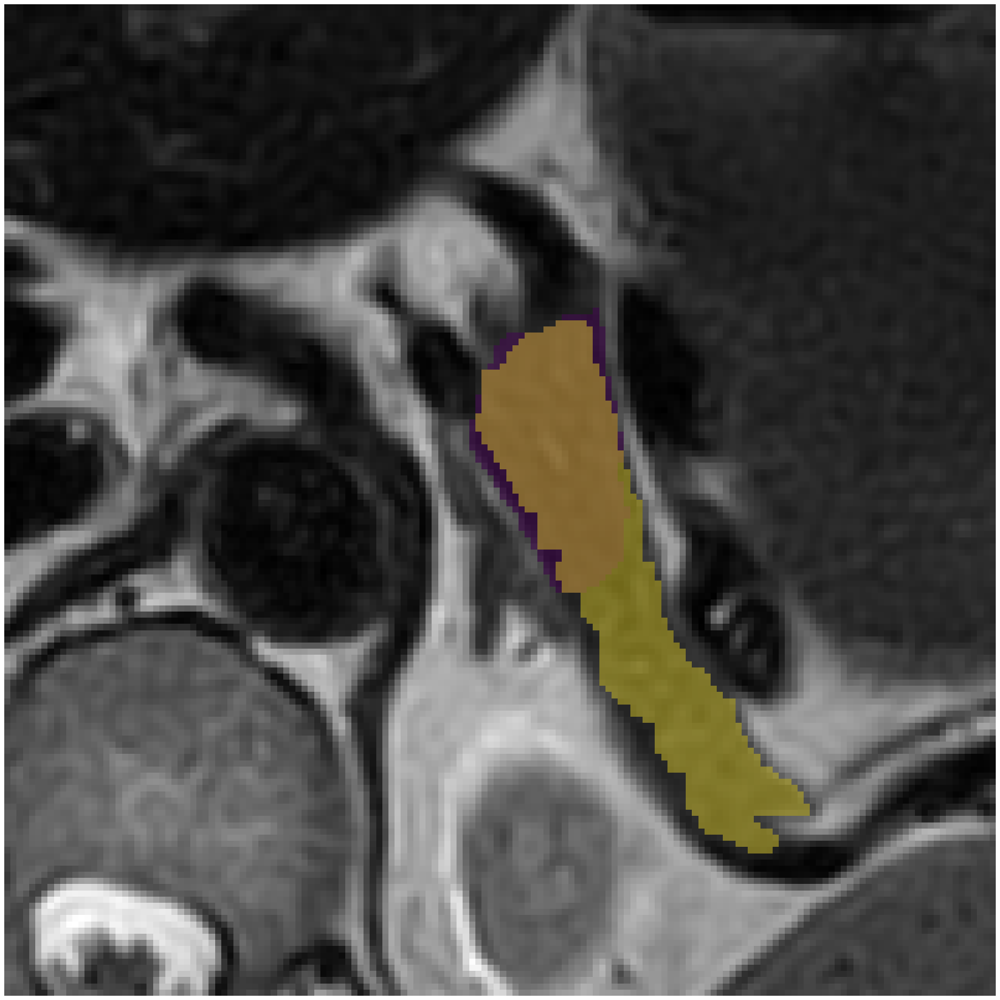

In [19]:
# Defaults 
config = con.CONFIG_FULL
trainer = con.CLASSIC
modality = "0000"

''' PART 1: compare model0 with model0_pretrained '''
figure = "experiment5_data"
task = con.TASK_610
task2 = con.TASK_611
tstr = con.TEST
data_path, img_path, segmentation_path, label_path = get_paths(task, config, tstr, trainer)
_, img_path2, segmentation_path2, label_path2 = get_paths(task2, config, tstr, trainer)

# GOOD, only slight oversegmentation
create_2d(9, 13, img_path, label_path, modality, segmentation_path2, f'{figure}_p16_batch0_good_1', ANTITRANSPOSE, rescale=False, showSeg=True)

# Severe oversegmentation where model0_pretrained outperforms model0
create_2d(2, 24, img_path, label_path, modality, segmentation_path, f'{figure}_p16_batch0_bad_1_610', ANTITRANSPOSE, zoom=True, rescale=False, showSeg=True,
                   zoom_x_min=0.20, zoom_x_max=0.85, zoom_y_min=0.25, zoom_y_max=0.90)
create_2d(2, 24, img_path, label_path, modality, segmentation_path2, f'{figure}_p16_batch0_bad_1_611', ANTITRANSPOSE, zoom=True, rescale=False, showSeg=True,
                   zoom_x_min=0.20, zoom_x_max=0.85, zoom_y_min=0.25, zoom_y_max=0.90)

# Undersegmentation tail by both model0_pretrained and model0
create_2d(4, 30, img_path, label_path, modality, segmentation_path, f'{figure}_p16_batch0_bad_2_610', ANTITRANSPOSE,zoom=True,rescale=False, showSeg=True,
                    zoom_x_min=0.23, zoom_x_max=0.73, zoom_y_min=0.4, zoom_y_max=0.9)
create_2d(4, 30, img_path, label_path, modality,  segmentation_path2, f'{figure}_p16_batch0_bad_2_611', ANTITRANSPOSE,zoom=True,rescale=False, showSeg=True,
                    zoom_x_min=0.23, zoom_x_max=0.73, zoom_y_min=0.4, zoom_y_max=0.9)




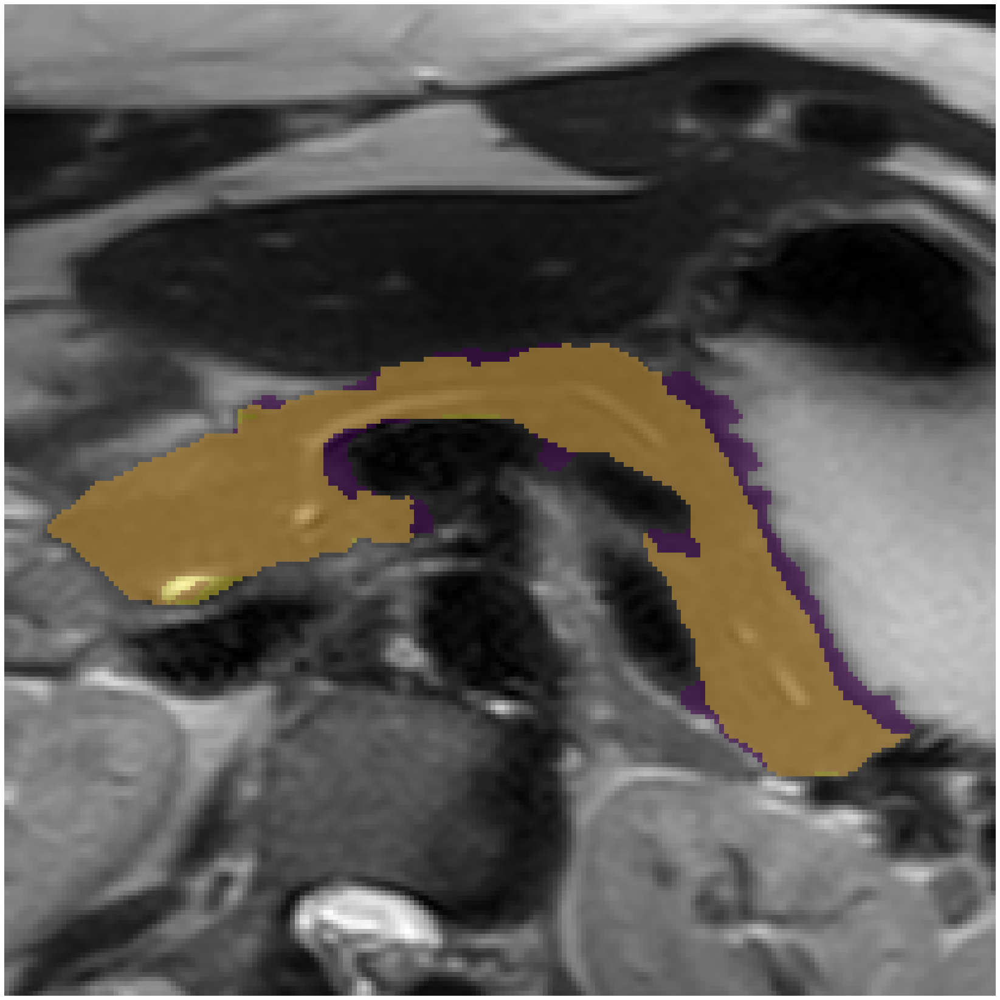

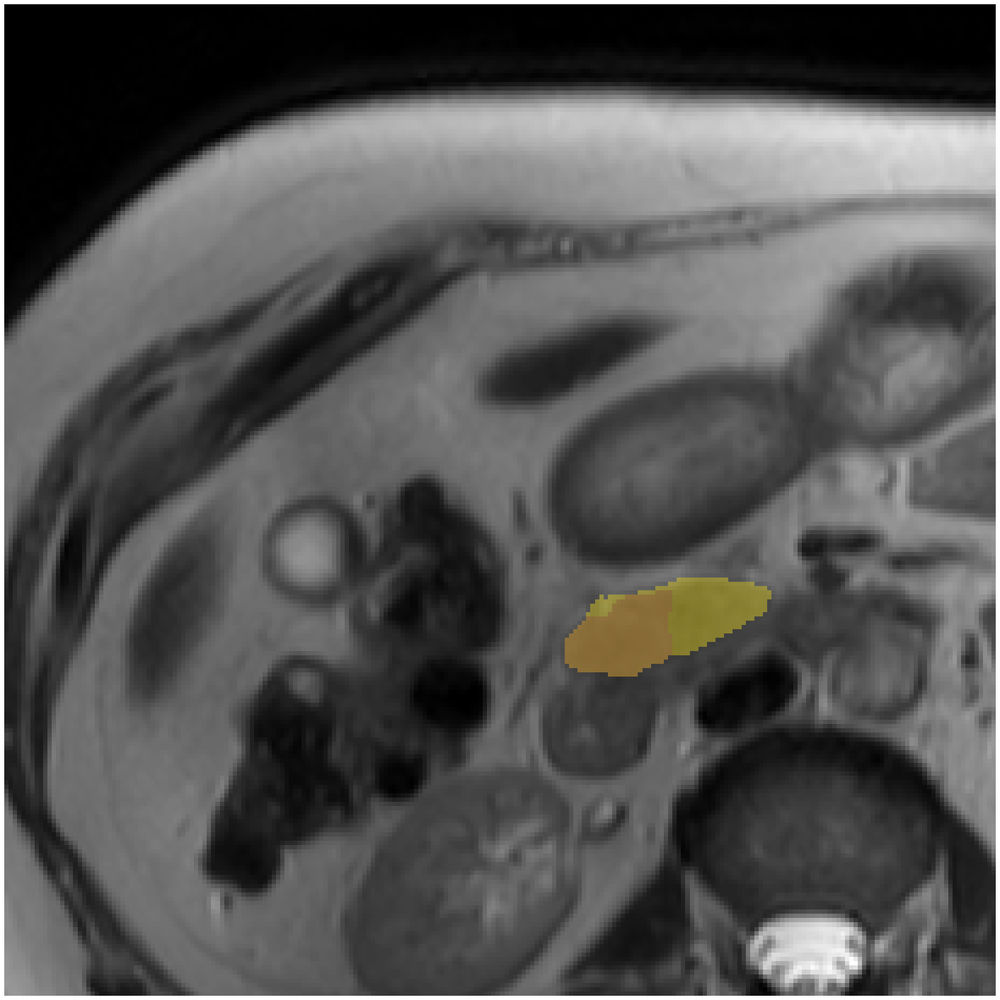

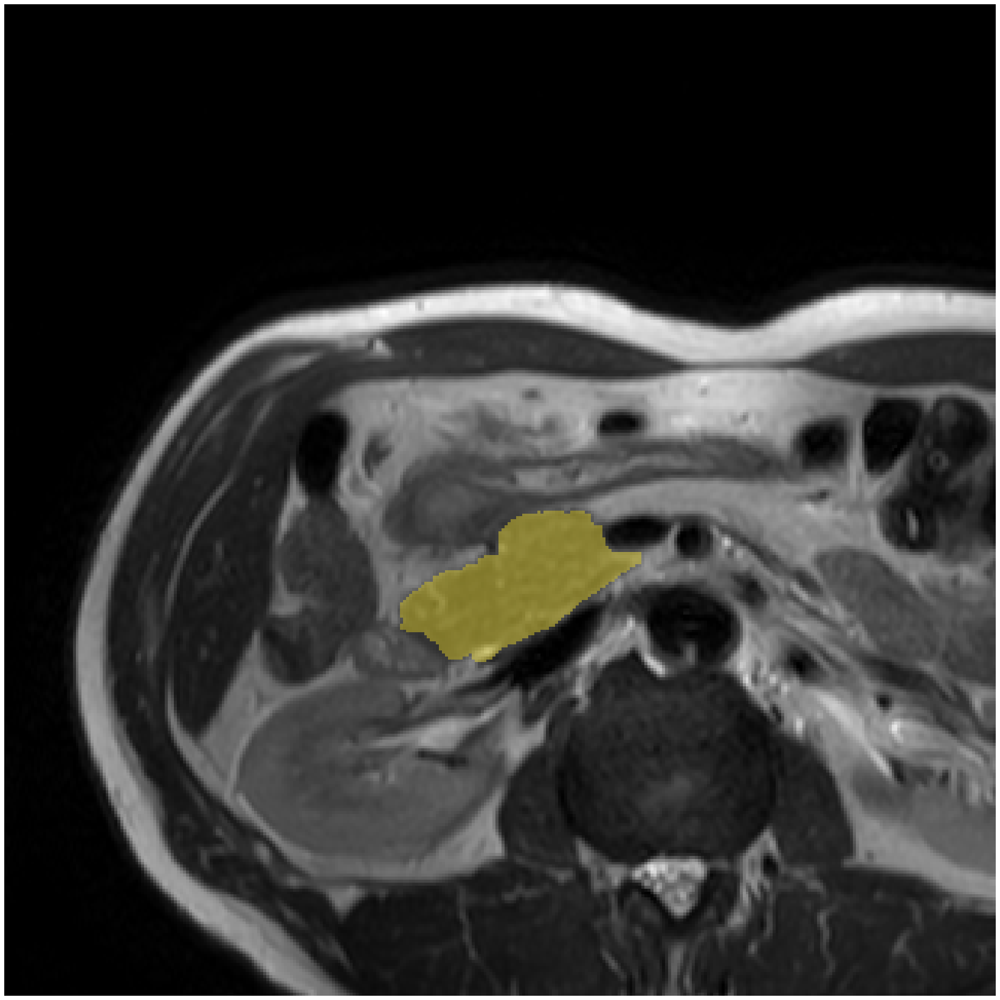

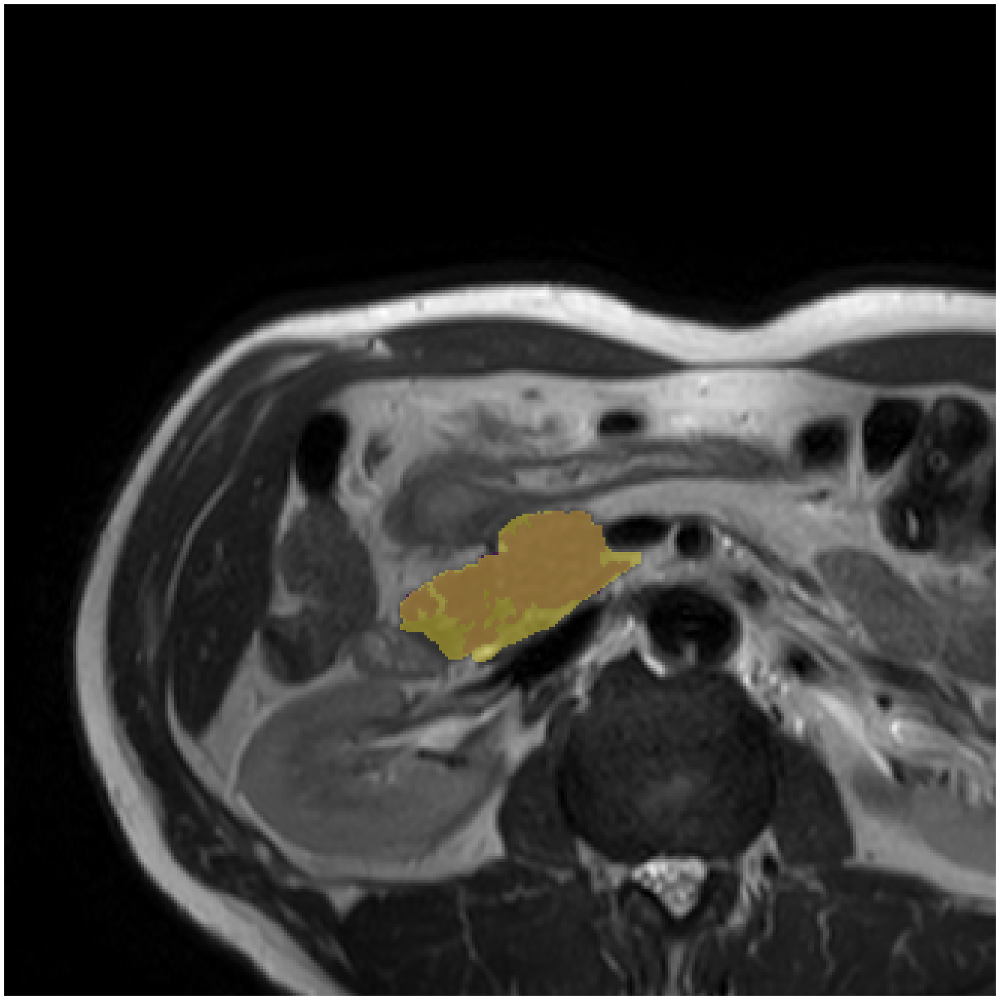

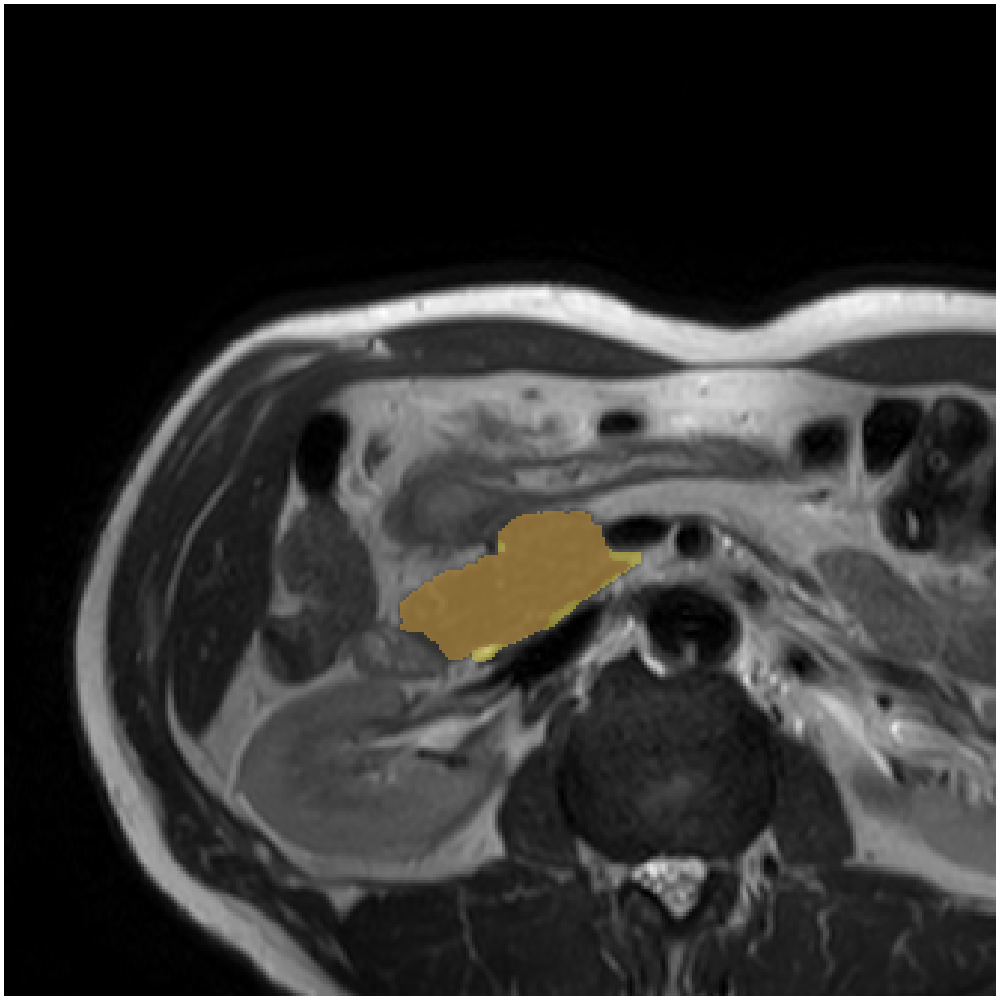

...

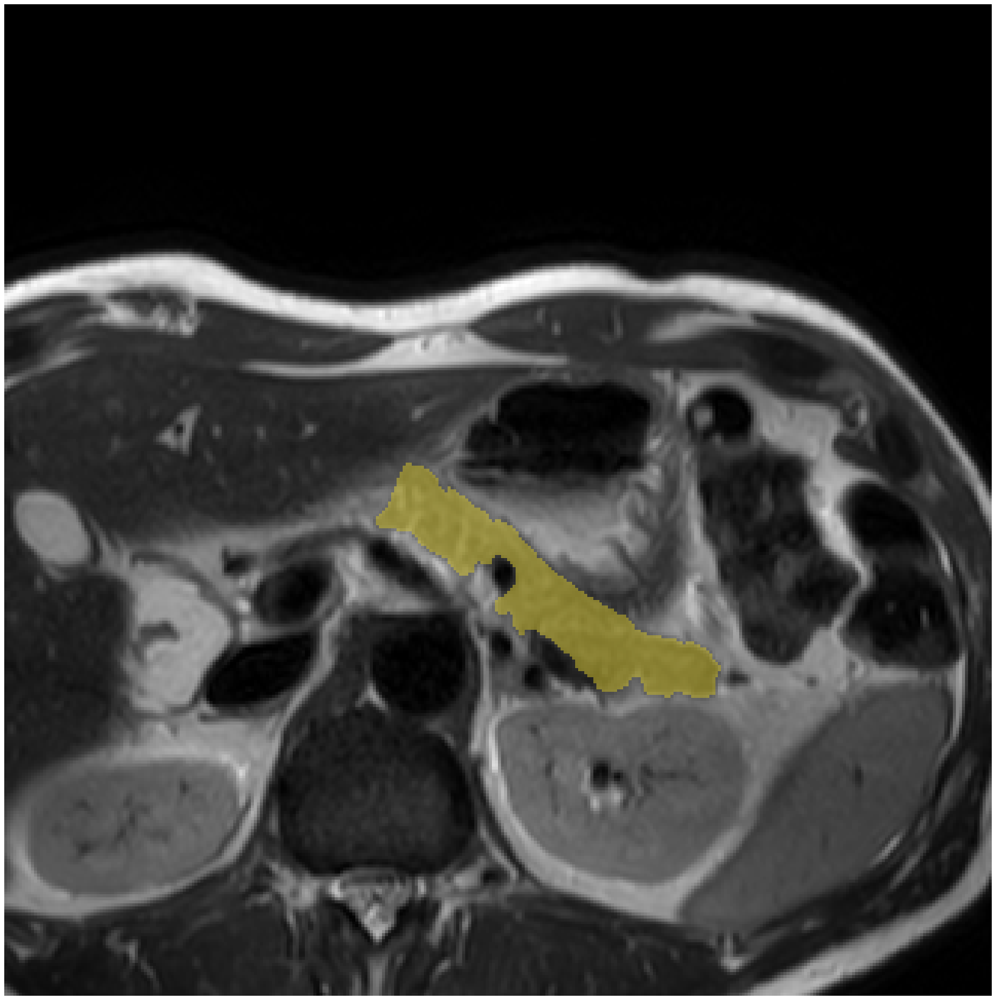

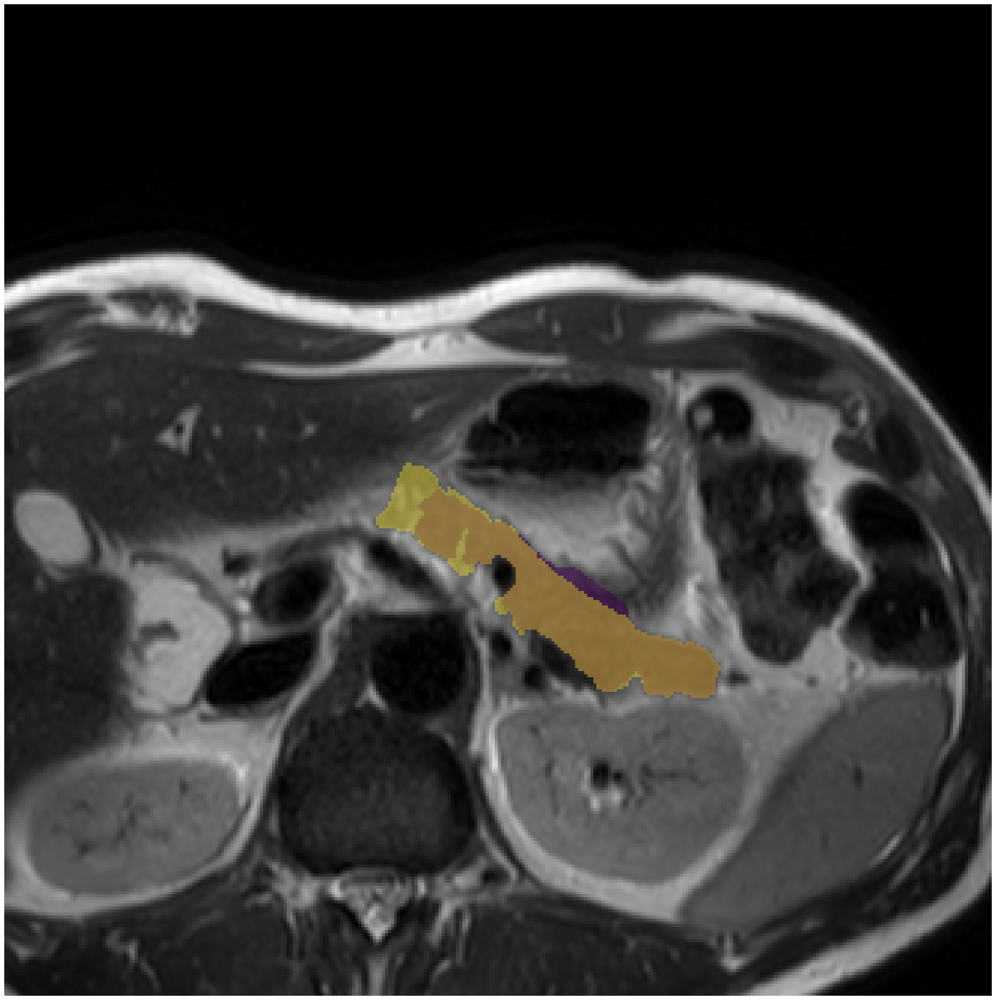

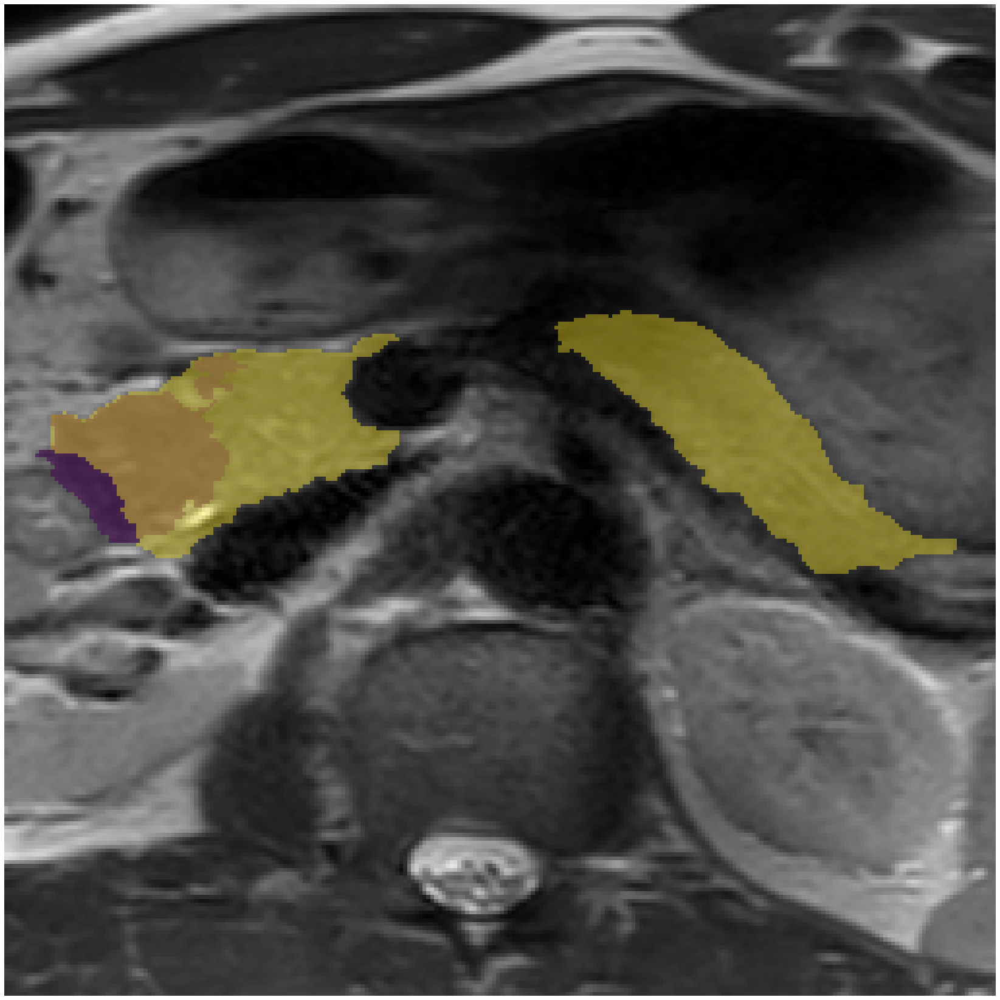

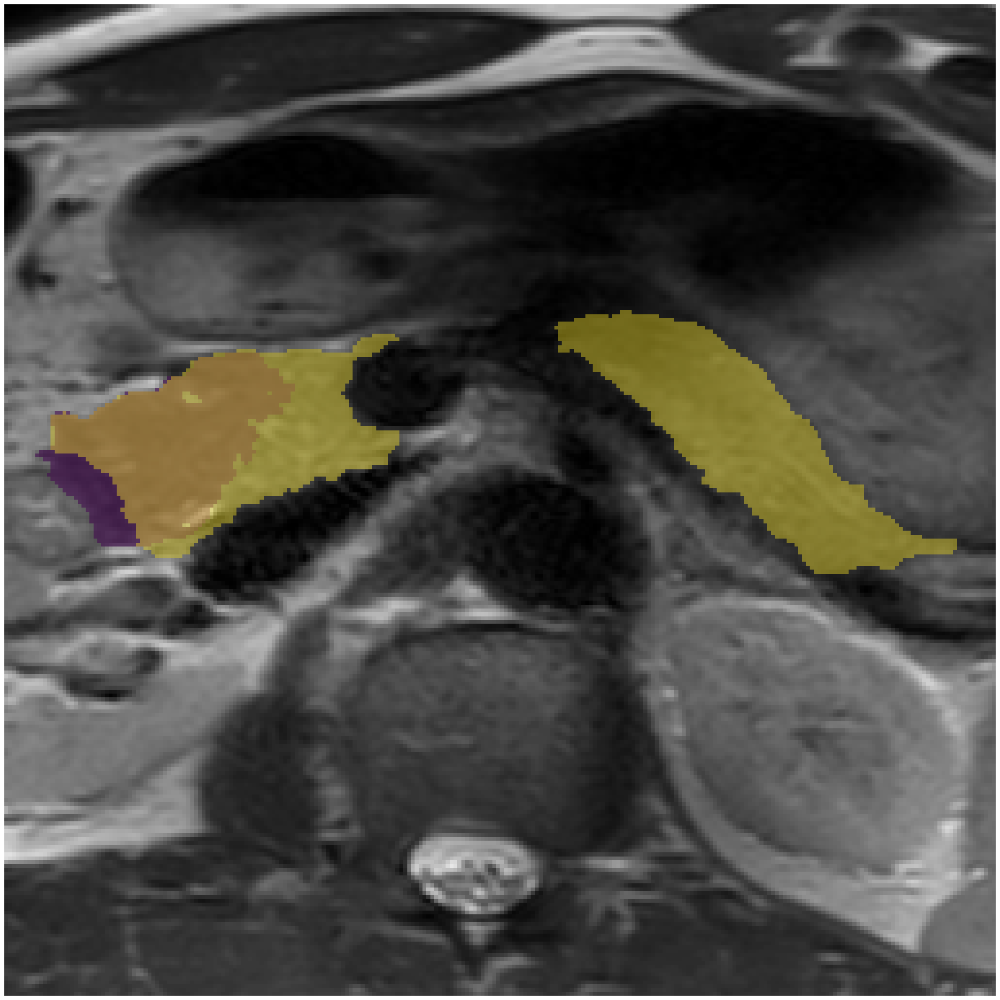

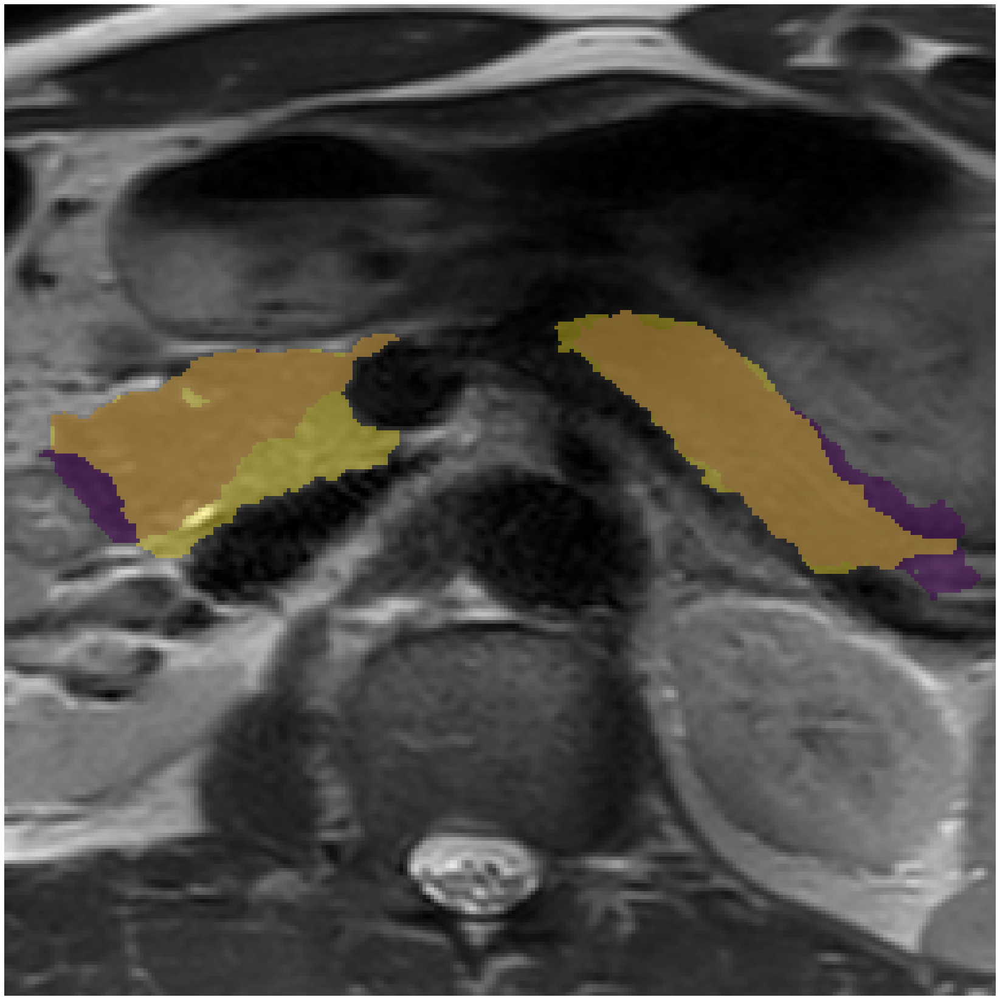

In [20]:
''' PART 1: compare model0 with model0_pretrained '''
task3 = con.TASK_612
task4 = con.TASK_613

data_path3, img_path3, segmentation_path3, label_path3 = get_paths(task3, config, tstr, trainer)
data_path4, img_path4, segmentation_path4, label_path4 = get_paths(task4, config, tstr, trainer)

# Stomach lining oversegmentation
create_2d(0, 23, img_path3, label_path3, modality, segmentation_path3, f'{figure}_p16_batch1_bad_1_612', ANTITRANSPOSE, zoom=True, rescale=False, showSeg=True,
                   zoom_x_min=0.1, zoom_x_max=0.75, zoom_y_min=0.25, zoom_y_max=0.90)

# Pancread head undersegmentation
create_2d(9, 6, img_path3, label_path3, modality, segmentation_path3, f'{figure}_p16_batch1_bad_2_612', ANTITRANSPOSE, zoom=True, rescale=False, showSeg=True,
                   zoom_x_min=0.2, zoom_x_max=0.65, zoom_y_min=0.1, zoom_y_max=0.55)

# Scan 25: compare 610 / 611 / 612 on the head
create_2d(10, 11, img_path, label_path, modality, segmentation_path, f'{figure}_p16_batch2_25_head_610', ANTITRANSPOSE, zoom=True, rescale=False, showSeg=True,
                   zoom_x_min=0.1, zoom_x_max=0.75, zoom_y_min=0.05, zoom_y_max=0.7)
create_2d(10, 11, img_path2, label_path2, modality, segmentation_path2, f'{figure}_p16_batch2_25_head_611', ANTITRANSPOSE, zoom=True, rescale=False, showSeg=True,
                   zoom_x_min=0.1, zoom_x_max=0.75, zoom_y_min=0.05, zoom_y_max=0.7)
create_2d(6, 11, img_path3, label_path3, modality, segmentation_path3, f'{figure}_p16_batch2_25_head_612', ANTITRANSPOSE, zoom=True, rescale=False, showSeg=True,
                   zoom_x_min=0.1, zoom_x_max=0.75, zoom_y_min=0.05, zoom_y_max=0.7)

# Scan 25: compare 610 / 611 / 612 on the tail
create_2d(10, 19, img_path, label_path, modality, segmentation_path, f'{figure}_p16_batch2_25_tail_610', ANTITRANSPOSE, zoom=True, rescale=False, showSeg=True,
                   zoom_x_min=0.1, zoom_x_max=0.75, zoom_y_min=0.25, zoom_y_max=0.90)
create_2d(10, 19, img_path2, label_path2, modality, segmentation_path2, f'{figure}_p16_batch2_25_tail_611', ANTITRANSPOSE, zoom=True, rescale=False, showSeg=True,
                   zoom_x_min=0.1, zoom_x_max=0.75, zoom_y_min=0.25, zoom_y_max=0.90)
create_2d(6, 19, img_path3, label_path3, modality, segmentation_path3, f'{figure}_p16_batch2_25_tail_612', ANTITRANSPOSE, zoom=True, rescale=False, showSeg=True,
                   zoom_x_min=0.1, zoom_x_max=0.75, zoom_y_min=0.25, zoom_y_max=0.90)

# Scan 26: compare 610 / 611 / 612 
create_2d(11, 18, img_path, label_path, modality, segmentation_path, f'{figure}_p16_batch2_26_610', ANTITRANSPOSE, zoom=True, rescale=False, showSeg=True,
                   zoom_x_min=0.1, zoom_x_max=0.9, zoom_y_min=0.05, zoom_y_max=0.85)
create_2d(11, 18, img_path2, label_path2, modality, segmentation_path2, f'{figure}_p16_batch2_26_611', ANTITRANSPOSE, zoom=True, rescale=False, showSeg=True,
                   zoom_x_min=0.1, zoom_x_max=0.9, zoom_y_min=0.05, zoom_y_max=0.85)
create_2d(7, 18, img_path3, label_path3, modality, segmentation_path3, f'{figure}_p16_batch2_26_612', ANTITRANSPOSE, zoom=True, rescale=False, showSeg=True,
                   zoom_x_min=0.1, zoom_x_max=0.9, zoom_y_min=0.05, zoom_y_max=0.85)


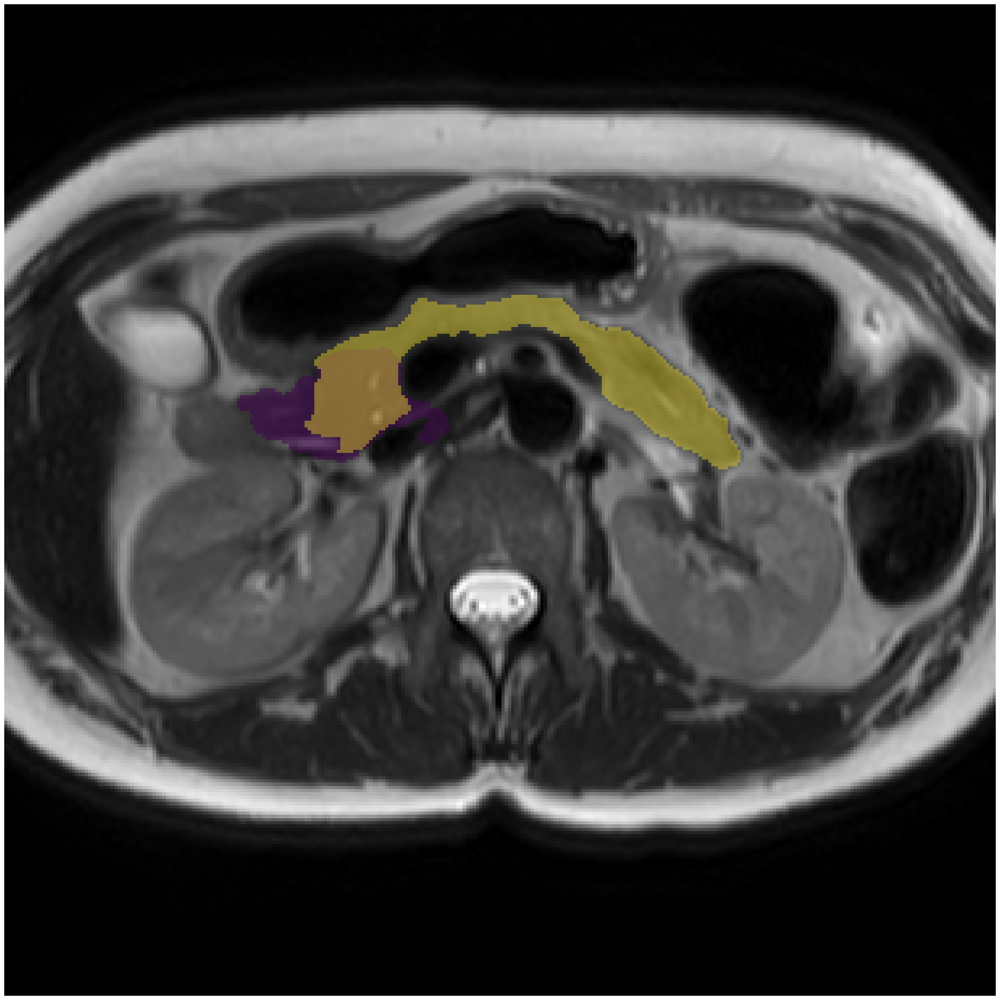

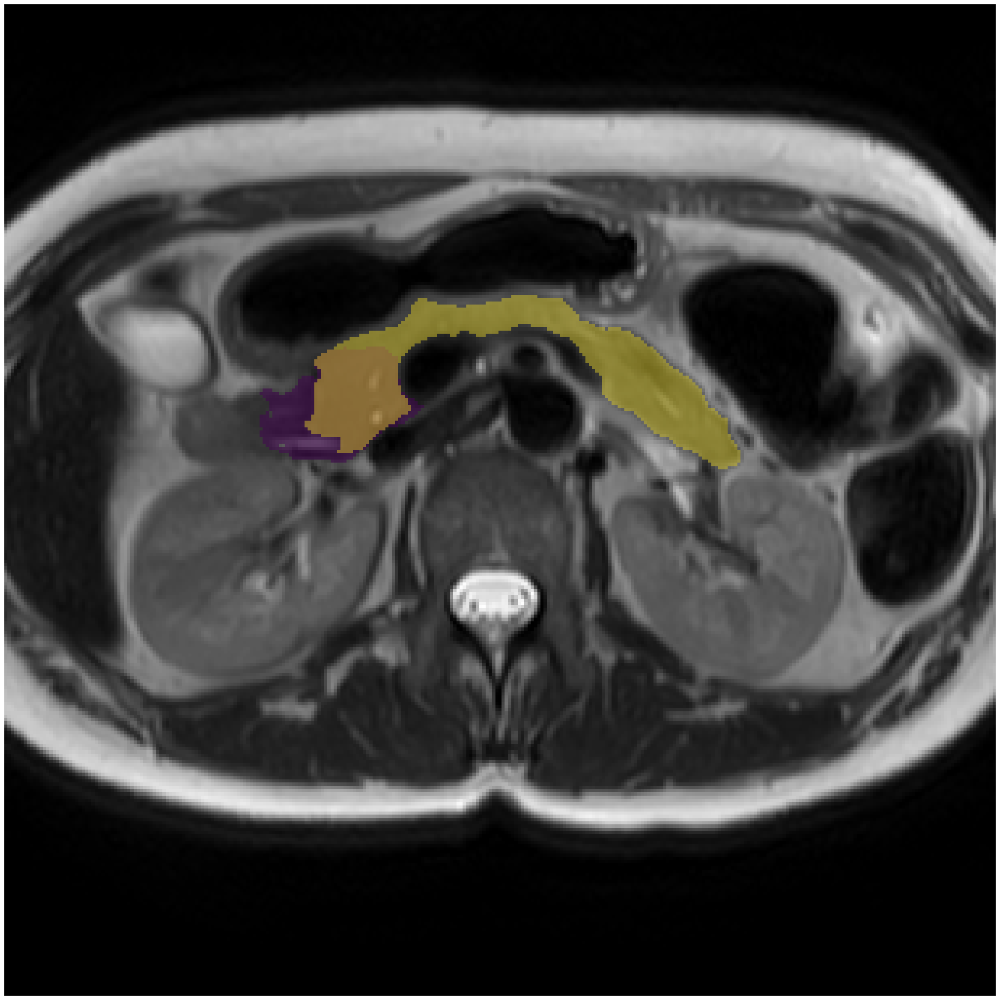

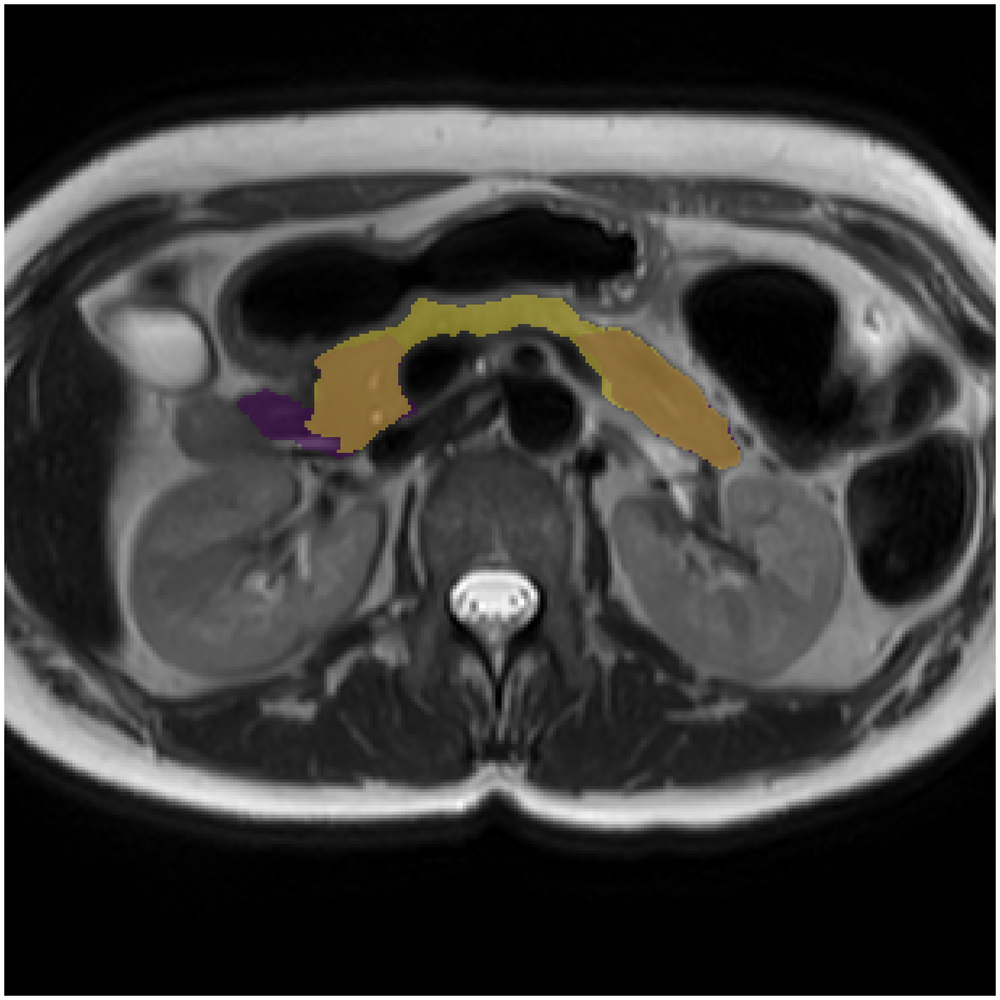

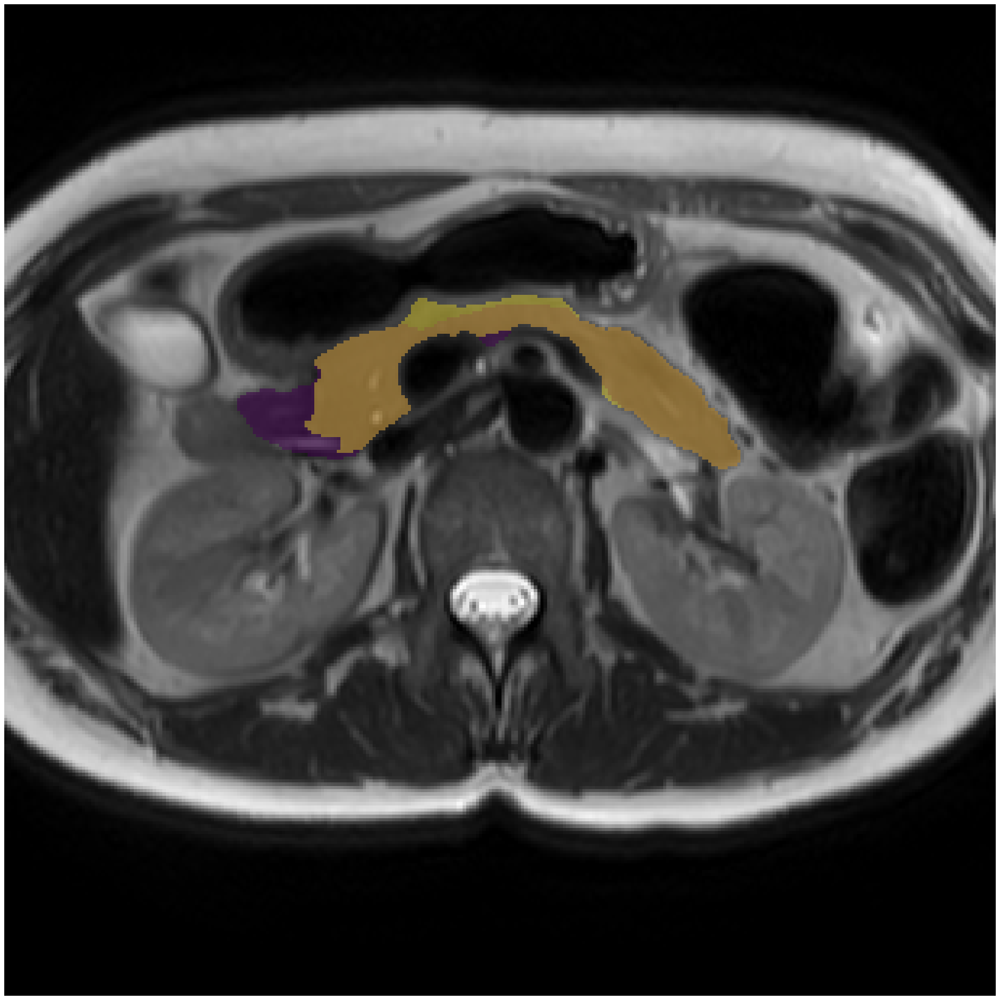

In [54]:
''' PART 1: compare model0 with model0_pretrained '''

# Stomach lining oversegmentation
create_2d(2, 24, img_path4, label_path4, modality, segmentation_path4, f'{figure}_p16_batch3_bad_1_613', ANTITRANSPOSE, rescale=False, showSeg=True)

# Scan 31: compare all models
create_2d(13, 7, img_path, label_path, modality, segmentation_path, f'{figure}_p16_batch3_31_610', ANTITRANSPOSE, rescale=False, showSeg=True, zoom=True,
                   zoom_x_min=0.2, zoom_x_max=0.8, zoom_y_min=0.2, zoom_y_max=0.8)
create_2d(13, 7, img_path2, label_path2, modality, segmentation_path2, f'{figure}_p16_batch3_31_611', ANTITRANSPOSE, zoom=True, rescale=False, showSeg=True,
                   zoom_x_min=0.2, zoom_x_max=0.8, zoom_y_min=0.2, zoom_y_max=0.8)
create_2d(12, 7, img_path3, label_path3, modality, segmentation_path3, f'{figure}_p16_batch3_31_612', ANTITRANSPOSE, zoom=True, rescale=False, showSeg=True,
                   zoom_x_min=0.2, zoom_x_max=0.8, zoom_y_min=0.2, zoom_y_max=0.8)
create_2d(1, 7, img_path4, label_path4, modality,segmentation_path4, f'{figure}_p16_batch3_31_613', ANTITRANSPOSE, zoom=True, rescale=False, showSeg=True,
                   zoom_x_min=0.2, zoom_x_max=0.8, zoom_y_min=0.2, zoom_y_max=0.8)

